## Final Project Submission

* Student name: Morgan Jones
* Student pace: Full Time
* Scheduled project review date/time: Wed, Apr 22, 2020, 04:00 PM - 04:45 PM
* Instructor name: Abhineet Kulkarni
* Blog post URL: https://medium.com/@morganjonesartist/color-guide-to-seaborn-palettes-da849406d44f


# Introduction
***

## Business Case

We have been commissioned by the **United Republic of Tanzania Ministry of Water** to aid in their ongoing Mission: ***To improve access to safe drinking water and sanitation services to all, and manage water resources so as to ensure national food security and sustainable industrial based economic development.*** In honor of Maji Week 2020, the Ministry announced intentions to *start a service which will monitor and service the functionality of various waterpoints in Tanzania*. In order to operate efficiently, the service will *need to predict the operation status of the several thousand waterpoints in the country*. Our task is to assist the members of this service with **accurate predictions for the waterpoints that are functioning as intended, and those which need repair**.

## Objectives

As data scientists, we will fulfill this goal by conducting data analysis on the Tanzanian waterpoints and generating classification models which predict with a high accuracy the operating condition of waterpoints within the Tanzanian borders. Areas of focus for the breadth of this work will be:

 1. How do water source characteristics effect the functionality of a waterpoint?

 2. How does the surrounding geography impact functionality of a waterpoint?

 3. How do years and seasonality of operation effect the functionality of a waterpoint?


## Metrics for Evaluation

Access to clean water is a basic human right, and an aim of this work is to widen its availability to all citizens of Tanzania. With this in mind, we value a model which has high accuracy. Our primary evaluation metric is the Classification Rate defined as:


$$
\begin{align}
 Classification Rate = \frac1N \sum_{i=0}^n I(y_i = \hat{y_i})
\end{align}
$$

 - Yields the percentage of rows where the predicted class $\hat{y}$ is equal to the actual class $y$ in the test dataset.
 - The maximum value for $Classification Rate$ is 1 and the minimum value is 0.
 - Our goal is to maximize the $Classification Rate$, with a minimum benchmark of:
 
$$ 
\begin{align}
Classification Rate = 0.80
\end{align}
$$ 

This translates to our model **predicting the correct status of a waterpoint 80 times out of 100 times**. 

Our model will be a **ternary classifier**, meaning that there are three potential classes a waterpoint can be placed. In the event our model improperly predicts the status of a waterpoint, we place a **higher importance on false positives more than false negatives**. Our model predicting that a waterpoint is functional when it is not functional can put members of a community at risk of not having access to clean drinking water for a period of time. However, when our model predicts that a waterpoint is non-functional, or functional but in need of repair when it is actually functional, the ministry may allocate resources to an issue that is currently non-existant, but these resources could potentially be used for another waterpoint or for that waterpoint at a later time. Therefore for the purposes of this work we will **value a low false positive rate more than a low false negative rate**. Precision is more important where False Positives are more costly than False Negatives, when defined as:

$$ \text{Precision} = \frac{\text{Number of True Positives}}{\text{Number of Predicted Positives}} $$

  

$$ \text{Recall} = \frac{\text{Number of True Positives}}{\text{Number of Actual Total Positives}} $$

Therefore we aim to generate a final model where:

$$ \text{Precision}  >  \text{Recall} $$


## Methodology

The process for conducting our research and modeling will follow the iterative **OSEMiN** pipeline. This entails Obtaining, Scrubbing, Exploring, Modeling, and Interpreting the data. This project will use this pipeline in the following manner: 

**OSEMiN Pipeline**:

    Obtain
    - Import the data.

    Scrub
    - Manage datatypes, resolve missing/duplicate values.
    
    Explore
    - Find patterns among the relationships of variables in the dataset.
    
    Model
    - Create predictive models.
    
    iNterpret
    – Identify insights and visualize findings.

# Obtain
***

## Import Libraries

In order to begin, we will import these libraries so that we may efficiently import and manage the data:

In [1]:
import pandas as pd  # Alias pandas to be referred to as pd
import numpy as np  # Alias numpy to be referred to as np
import matplotlib.pyplot as plt  # Alias matplotlib.pyplot to be referred to as plt
import matplotlib.ticker as ticker # Alias matplotlib.ticker to be referred to as ticker
import seaborn as sns  # Alias seaborn to be referred to as sns

# Magic funtion to allow plot outputs to appear and be stored within out notebook
%matplotlib inline
# View all of the columns of a returned object
pd.set_option('display.max_columns', None)

## Import Data

With the necessary libraries imported, we can call the pandas `pd.read_csv` method to import the data to be used cleaned and used in generating our models. We have access to 3 datasets, `train_lab`, `train_val`, and `test_val`.

In [2]:
# Import the dataset as a pandas dataframe
train_lab = pd.read_csv('datasets/training_set_labels.csv')
# View first 5 lines of the dataframe
train_lab.head()

,id,status_group
0,69572,functional
1,8776,functional
2,34310,functional
3,67743,non functional
4,19728,functional


In [3]:
# Import the dataset as a pandas dataframe
train_val = pd.read_csv('datasets/training set values.csv')
# View first 5 lines of the dataframe
train_val.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe


In [4]:
# Import the dataset as a pandas dataframe
test_val = pd.read_csv('datasets/test_set_values.csv')
# View first 5 lines of the dataframe
test_val.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,50785,0.0,2013-02-04,Dmdd,1996,DMDD,35.290799,-4.059696,Dinamu Secondary School,0,Internal,Magoma,Manyara,21,3,Mbulu,Bashay,321,True,GeoData Consultants Ltd,Parastatal,NaN,True,2012,other,other,other,parastatal,parastatal,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,other,other
1,51630,0.0,2013-02-04,Government Of Tanzania,1569,DWE,36.656709,-3.309214,Kimnyak,0,Pangani,Kimnyak,Arusha,2,2,Arusha Rural,Kimnyaki,300,True,GeoData Consultants Ltd,VWC,TPRI pipe line,True,2000,gravity,gravity,gravity,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,spring,spring,groundwater,communal standpipe,communal standpipe
2,17168,0.0,2013-02-01,NaN,1567,NaN,34.767863,-5.004344,Puma Secondary,0,Internal,Msatu,Singida,13,2,Singida Rural,Puma,500,True,GeoData Consultants Ltd,VWC,P,NaN,2010,other,other,other,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,other,other
3,45559,0.0,2013-01-22,Finn Water,267,FINN WATER,38.058046,-9.418672,Kwa Mzee Pange,0,Ruvuma / Southern Coast,Kipindimbi,Lindi,80,43,Liwale,Mkutano,250,NaN,GeoData Consultants Ltd,VWC,NaN,True,1987,other,other,other,vwc,user-group,unknown,unknown,soft,good,dry,dry,shallow well,shallow well,groundwater,other,other
4,49871,500.0,2013-03-27,Bruder,1260,BRUDER,35.006123,-10.950412,Kwa Mzee Turuka,0,Ruvuma / Southern Coast,Losonga,Ruvuma,10,3,Mbinga,Mbinga Urban,60,NaN,GeoData Consultants Ltd,Water Board,BRUDER,True,2000,gravity,gravity,gravity,water board,user-group,pay monthly,monthly,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe


## Data Description

With our data imported, we can make a description of the datasets in order to better understand the information the dataset makes available to us. Let's describe the features of our data which are found in the `train_val` and `test_val` datasets:

**Feature** | **Description**
:-----------|:---------------
`amount_tsh` | Total static head (amount of water available at waterpoint)
`date_recorded` | The date the report was made
`funder` | Organization or Individual whom funded the well
`gps_height` | Altitude of the well
`installer` | Organization that installed the well
`longitude` | GPS longitude coordinate of the well
`latitude` | GPS latitude coordinate of the well
`wpt_name` | Name of the waterpoint if a name exists
`num_private` | Missing Description
`basin` | Geographic water basin, source of water for the well
`subvillage` | Geographic location of well at subvillage level
`region` | Geographic location of well at region level
`region_code` | Geographic location of well at region level (coded)
`district_code` | Geographic location of well at district level (coded)
`lga` | Geographic location of the well
`ward` | Geographic location of the well
`population` | Population around the well
`public_meeting` | Boolean if a meeting was held
`recorded_by` | Group entering this row of data
`scheme_management` | Management that operates the waterpoint
`scheme_name` | Who operates the waterpoint
`permit` | Boolean if the well is permitted
`construction_year` | Year the well was constructed
`extraction_type` | The type of extraction the waterpoint uses
`extraction_type_group` | The group of extraction the waterpoint uses
`extraction_type_class` | The class of extraction the waterpoint uses
`management` | How the waterpoint is managed
`management_group` | How the waterpoint is managed
`payment` | How users pay for use of the well
`payment_type` | How users pay for use of the well
`water_quality` | The quality of the water at the waterpoint
`quality_group` | The quality of the water at the waterpoint
`quantity` | The quantity type of water at the waterpoint
`quantity_group` | The quantity type of water at the waterpoint
`source` | The source of the water in the waterwell
`source_type` | The source of the water in the waterwell
`source_class` | The source of the water in the waterwell
`waterpoint_type` | The type of well
`waterpoint_type_group` | The group of waterpoint

Similarly, we can describe the target values of our data, so as to better understand the labels which will be predicted for our datapoints:

**Status_Group** | **Description** 
:---------|:-------------
`functional` | The waterpoint is operational and there are no repairs needed
`functional needs repair` | The waterpoint is operational, but needs repairs
`non functional` | The waterpoint is not operational, and needs repair/replacement

##### Data Description Comments
With our features and labels clearly defined, we can get a clearer view of the information we have available to us. We can see there are 3 unique labels to describe waterpoints, one of which defines a waterpoint as not in need of repair, and 2 of which define a waterpoint as in need of repair/ and or replacement. We have a total of 39 features, many of which at first glance appear to be highly collinear. For training and testing our model we will only use the `train_val` and `train_lab` datasets. The `test_val` dataset will be used in preparing a submission for the Driven Data, and will be generally ignored for training in this notebook.

It will be helpful to gain a deeper understanding of the dimensions of our data. We are yet to know how many datapoints our data contains. We can access this information with the `.shape` attribute.

In [5]:
# Return dimensions of dataset
train_lab.shape

(59400, 2)

The `.info()` method will inform us of how many values are in each column, and what datatype the columns are.

In [6]:
# Return datatype and number of rows for dataset
train_lab.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 2 columns):
id              59400 non-null int64
status_group    59400 non-null object
dtypes: int64(1), object(1)
memory usage: 928.2+ KB


It will also be useful to confirm that all of our labels are present within the `train_lab` dataset. To confirm this we can create a chain with the `isnull()` method which returns a boolean value for if the value in a row is null, with `.sum()` which returns the summation of all null values in each column of the dataframe. To get a percentage of missing values we can divide the returned value of our chain by the shape of the dataframe and multiply this value by 100.00.

In [7]:
# Return percentage of null values
train_lab.isnull().sum() / train_lab.shape[0] * 100.00

id              0.0
status_group    0.0
dtype: float64

Confirming that none of the values are missing, we can quickly take a look at the distribution of the target values among the waterpoints. We can use `.value_counts()` to return the counts of each value and dividing this value by the length of the `status_group` column.

In [8]:
# Return the distribution of targets
train_lab['status_group'].value_counts()/len(train_lab['status_group'])

functional                 0.543081
non functional             0.384242
functional needs repair    0.072677
Name: status_group, dtype: float64

We can see that over half of the waterpoints are labeled as functional, which is one of the best case situations. However, for our model, the bias toward this label could prove to be problematic. Now we can use the same methods to describe our `train_val` dataframe in greater detail.

In [9]:
# Return dimensions of dataset
train_val.shape

(59400, 40)

In [10]:
# Return datatype and number of rows for dataset
train_val.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 40 columns):
id                       59400 non-null int64
amount_tsh               59400 non-null float64
date_recorded            59400 non-null object
funder                   55765 non-null object
gps_height               59400 non-null int64
installer                55745 non-null object
longitude                59400 non-null float64
latitude                 59400 non-null float64
wpt_name                 59400 non-null object
num_private              59400 non-null int64
basin                    59400 non-null object
subvillage               59029 non-null object
region                   59400 non-null object
region_code              59400 non-null int64
district_code            59400 non-null int64
lga                      59400 non-null object
ward                     59400 non-null object
population               59400 non-null int64
public_meeting           56066 non-null object
r

We can see that most of the columns of the dataframe contain string values, with only 10 of the columns containing integer or float values. Let's check with more clarity the percentage of missing values.

In [11]:
# Return percentatge of null values
train_val.isnull().sum() / train_val.shape[0] * 100.00

id                        0.000000
amount_tsh                0.000000
date_recorded             0.000000
funder                    6.119529
gps_height                0.000000
installer                 6.153199
longitude                 0.000000
latitude                  0.000000
wpt_name                  0.000000
num_private               0.000000
basin                     0.000000
subvillage                0.624579
region                    0.000000
region_code               0.000000
district_code             0.000000
lga                       0.000000
ward                      0.000000
population                0.000000
public_meeting            5.612795
recorded_by               0.000000
scheme_management         6.526936
scheme_name              47.417508
permit                    5.144781
construction_year         0.000000
extraction_type           0.000000
extraction_type_group     0.000000
extraction_type_class     0.000000
management                0.000000
management_group    

The column with the most missing values based on the `.isnull()` method is scheme_name. However this can be a bit miss leading, as some placeholder values are not considered with this method. We can use a chain with the `isin()` method which will return a boolean value for is a particular value is found within a column, with the `.sum()` method to return the sum of these values.

In [12]:
# Return the count of placeholder values
train_val.isin(['?', '#', 'NaN', 'null', 'N/A', '-', 0]).sum()

id                           1
amount_tsh               41639
date_recorded                0
funder                       0
gps_height               20438
installer                    3
longitude                 1812
latitude                     0
wpt_name                     0
num_private              58643
basin                        0
subvillage                   0
region                       0
region_code                  0
district_code               23
lga                          0
ward                         0
population               21381
public_meeting            5055
recorded_by                  0
scheme_management            0
scheme_name                  0
permit                   17492
construction_year        20709
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

This is a different description than the one given by the `isnull()` method. We can see that there are several thousand placeholder values within the `train_val` dataframe. We can take a better look at the distribution of placeholder values by returning the percentage of those values with a division with the shape of `train_val`.

In [13]:
# Return percentage of placeholder values
train_val.isin(['?', '#', 'NaN', 'null', 'N/A', '-', 0]).sum() / train_val.shape[0] * 100.00

id                        0.001684
amount_tsh               70.099327
date_recorded             0.000000
funder                    0.000000
gps_height               34.407407
installer                 0.005051
longitude                 3.050505
latitude                  0.000000
wpt_name                  0.000000
num_private              98.725589
basin                     0.000000
subvillage                0.000000
region                    0.000000
region_code               0.000000
district_code             0.038721
lga                       0.000000
ward                      0.000000
population               35.994949
public_meeting            8.510101
recorded_by               0.000000
scheme_management         0.000000
scheme_name               0.000000
permit                   29.447811
construction_year        34.863636
extraction_type           0.000000
extraction_type_group     0.000000
extraction_type_class     0.000000
management                0.000000
management_group    

To get a better understanding of which placeholders are most prevalent in our dataframe, let's focus on values of 0. What is the percentage of 0 values within the columns of our dataframe, compared to the rest of the placeholders. Again we can use the `isin()` method to chained with `.sum()` and divided by the shape of the dataframe.

In [14]:
# Return the count of zero values
train_val.isin([0]).sum() / train_val.shape[0] * 100.00

id                        0.001684
amount_tsh               70.099327
date_recorded             0.000000
funder                    0.000000
gps_height               34.407407
installer                 0.000000
longitude                 3.050505
latitude                  0.000000
wpt_name                  0.000000
num_private              98.725589
basin                     0.000000
subvillage                0.000000
region                    0.000000
region_code               0.000000
district_code             0.038721
lga                       0.000000
ward                      0.000000
population               35.994949
public_meeting            8.510101
recorded_by               0.000000
scheme_management         0.000000
scheme_name               0.000000
permit                   29.447811
construction_year        34.863636
extraction_type           0.000000
extraction_type_group     0.000000
extraction_type_class     0.000000
management                0.000000
management_group    

We can see that the percentages are nearly identical. This informs us that almost all of the placeholder values within our dataset are 0 values. We will have to consider each column to determine the best methods for managing these values in the Scrub component of the pipeline.

# Scrub
***

Having successfully obtained and described the data, it is of utmost importance to clean the data. This will involve removing, replacing, or imputing missing or duplicated values and assigning the appropriate datatypes to columns. Careful consideration is needed in this stage of our pipeline as this step will alter the dataset in a way that can improve or lower the predictive power of our model.

## Clean the Data

In cleaning the data we will focus on managing missing values and datatypes. We can begin by assigning appropriate datatypes. The current `date_recorded` column will cause issues for our classification models, so lets modify this column by creating a `year_recorded` and `month_recorded` column from this feature. To do this we can import the `datetime` module from the `datetime` library, and the `parser` module from the `dateutil` library. 

### Adjust Datatypes

In [15]:
# Import parser from dateutil
from dateutil import parser
# Import datetime from datetime
from datetime import datetime 

In [16]:
# Show return value of parser
parser.parse(train_val['date_recorded'][0])

datetime.datetime(2011, 3, 14, 0, 0)

Here we can see the returned `datetime` object from the `.parse()` method. We will now create a for loop which iterates through all the `date_recorded` values and parses out the year values.

In [17]:
# Create empty list
year_made = []

# Iterate through values in 'date_recorded', convert value into a representation of the year 
# the report was created and append value into empty list.
for i in train_val['date_recorded']:
    parsed = parser.parse(i).strftime('20%y')
    year_made.append(parsed)

In [18]:
# View first 5 values in list
year_made[0:5]

['2011', '2013', '2013', '2013', '2011']

Now with our newly minted list we can create a pandas Series and append this series to our `train_val` dataframe.

In [19]:
# Create a new dataframe from list
year_rep_df = pd.DataFrame({'year_recorded':year_made})
# Check dataframe
year_rep_df.head()

,year_recorded
0,2011
1,2013
2,2013
3,2013
4,2011


In [20]:
# Create new dataframe by combining previous and new dataframes
train_df = pd.concat([train_val, year_rep_df], axis=1)
# Check dataframe
train_df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2011
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2013
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,2013
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,2013
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2011


Now we can see that our new column `year_recorded` contains the year that the report was created. We can now follow the same steps to create the `month_recorded` column.

In [21]:
# Create empty list
month_made = []

# Iterate through values in 'date_recorded', convert value into a representation of the month 
# the report was created and append value into empty list.
for i in train_val['date_recorded']:
    parsed = parser.parse(i).strftime('%m')
    month_made.append(parsed)

In [22]:
# View first 5 values in list
month_made[0:5]

['03', '03', '02', '01', '07']

In [23]:
# Create a new dataframe from list
month_rep_df = pd.DataFrame({'month_recorded':month_made})
# Check dataframe
month_rep_df.head()

,month_recorded
0,03
1,03
2,02
3,01
4,07


In [24]:
# Create new dataframe by combining previous and new dataframes
train_df = pd.concat([train_df, month_rep_df], axis=1)
# Check dataframe
train_df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2011,03
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2013,03
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,2013,02
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,2013,01
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2011,07


It could prove useful to include the day of the week that a report was made, and the season of the year. There may be some underlying connection between the day of the week a report was made and the functionality of the waterpoint, as well as what season the report had been made. We can include such columns through similar methods.

In [25]:
# Create empty list
day_made = []

# Iterate through values in 'date_recorded', convert value into a representation of the day 
# the report was created and append value into empty list.
for i in train_val['date_recorded']:
    parsed = parser.parse(i).strftime('%w')
    day_made.append(parsed)

In [26]:
# View first 5 values in list
day_made[0:5]

['1', '3', '1', '1', '3']

In [27]:
# Create a new dataframe from list
day_rep_df = pd.DataFrame({'day_recorded':day_made})
# Check dataframe
day_rep_df.head()

,day_recorded
0,1
1,3
2,1
3,1
4,3


Now we have a description of what day of the week a report was submitted. Our day_recorded column describes the days of the week in the following manner:

**Day** | **Value** 
:------------ |:--------------------------:
Monday | 1
Tuesday | 2
Wednesday | 3
Thursday | 4
Friday | 5
Saturday | 6
Sunday | 0

In [28]:
# Create new dataframe by combining previous and new dataframes
train_df = pd.concat([train_df, day_rep_df], axis=1)
# Check dataframe
train_df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2011,03,1
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2013,03,3
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,2013,02,1
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,2013,01,1
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2011,07,3


In [29]:
# Check column types
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 43 columns):
id                       59400 non-null int64
amount_tsh               59400 non-null float64
date_recorded            59400 non-null object
funder                   55765 non-null object
gps_height               59400 non-null int64
installer                55745 non-null object
longitude                59400 non-null float64
latitude                 59400 non-null float64
wpt_name                 59400 non-null object
num_private              59400 non-null int64
basin                    59400 non-null object
subvillage               59029 non-null object
region                   59400 non-null object
region_code              59400 non-null int64
district_code            59400 non-null int64
lga                      59400 non-null object
ward                     59400 non-null object
population               59400 non-null int64
public_meeting           56066 non-null object
r

We can see that our new columns have been assigned the wrong datatype. We will need them to be numeric inorder to encode them later, as well as specifically the `month_recorded` column in order to create the `seas_recorded` column. We can change the datatypes now with the `.astype()` method, setting the type to int.

In [30]:
# Change the datatype to integer
train_df['year_recorded'] = train_df['year_recorded'].astype('int64')
train_df['month_recorded'] = train_df['month_recorded'].astype('int64')
train_df['day_recorded'] = train_df['day_recorded'].astype('int64')

Now we can use the values in the `month_recorded` column to create a `seas_recorded` feature describing the season that a report had been made. We can create lists containing the correct month values for the seasons in Tanzania. Tanzania being south of the equator has its cooler seasons in the early half of the year, and the warmer seasons in the later half. Typically in Tanzania, the seasons are separated by a long and short dry season, and a long and dry wet season. Lets use a function that takes these month values and bins them to the appropriate season, then use these bins to create the `seas_recorded` column. 

In [31]:
# Create lists of the seasons with months as elements
short_rain = [11, 12]
long_rain = [3, 4, 5]
short_dry = [1, 2]
long_dry = [6, 7, 8, 9, 10]

# Create a function that bins the months reported by season
def season(mon):
    """
    Takes in month, and applies in logical to determine season of sale.
    """
    if mon in short_rain:
        return 'short_rain'
    elif mon in long_rain:
        return 'long_rain'
    elif mon in short_dry:
        return 'short_dry'
    else:
        return 'long_dry'

# Create new feature based on the values returned from function
train_df['seas_recorded'] = train_df['month_recorded'].apply(season)

In [32]:
# Check for update
train_df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2011,3,1,long_rain
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2013,3,3,long_rain
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,2013,2,1,short_dry
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,2013,1,1,short_dry
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2011,7,3,long_dry


Now that our dataset contains the year, month, day of the week, and season the report was made we can drop the original `date_recorded` column and move on to the `funder` column. 

In [33]:
# Drop original date_recorded column
train_df = train_df.drop('date_recorded', axis=1)

### Fill Missing Values

Now let's check the number of missing values for `funder`.

In [34]:
# Return count of missing values in funder column
train_df['funder'].isnull().sum()

3635

We have a total of 3635 missing values for `funder`. We can resolve this by imputing these missing values with some other value. We can choose the mode which would be.

In [35]:
# Print the mode of the funder column
print('Mode: {}'.format(train_df['funder'].mode()))

Mode: 0    Government Of Tanzania
dtype: object


The most common funder of waterpoints is the Government of Tanzania which seems appropriate. However it seems more useful to impute the values based on geographical similarity. We can utilize one of the geographical features to sort the dataframe, and impute the missing `funder` values with the funder that is associated with the closest waterpoint. Let's try this with the `latitude` column. However we will first need to merge `train_lab` with `train_df` so that the labels do not get misassigned.

In [36]:
# Drop id from train_lab
labels = train_lab.drop('id', axis=1)

In [37]:
# Add labels to train_df
train_df = pd.concat([train_df, labels], axis=1)
# Check changes
train_df.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group
0,69572,6000.0,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2011,3,1,long_rain,functional
1,8776,0.0,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2013,3,3,long_rain,functional
2,34310,25.0,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,2013,2,1,short_dry,functional
3,67743,0.0,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,2013,1,1,short_dry,non functional
4,19728,0.0,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2011,7,3,long_dry,functional


Now with our labels connected to the appropriate instances, let's sort our dataframe based on the latitude values, thus grouping our waterpoints closer together with the `.sort_values()` method.

In [38]:
# Create a new sorted dataframe
sort_train_df = train_df.sort_values(by=['latitude'])
# Check changes
sort_train_df.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group
43832,20163,3000.0,Danida,330,DANIDA,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair
57743,42800,3000.0,Danida,327,DANIDA,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair
7328,57360,0.0,Tasaf,439,TASAF,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional
51116,338,0.0,World Bank,559,MKONGO BUILDING CONTRACTOR,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional
27708,51453,500.0,Drdp,568,DWE,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional


Now that we have a dataframe that is sorted by the latittude values, we can impute the missing funder rows with the funder associated with the next closest waterpoint by latitude value.

In [39]:
# Impute missing values in funder column
sort_train_df['funder'] = sort_train_df['funder'].fillna(method='ffill')

In [40]:
# Check that there are no more missing values in funder column
sort_train_df['funder'].isnull().sum()

0

Now that there are no more missing values in the `funder` feature, we will need to manage how many categories are contained in the column. Let's take a look at how many unique values there are.

In [41]:
# Return number of unique values in funder column
sort_train_df['funder'].nunique()

1897

With nearly 2000 unique funders, we will have to create bins to lower the number of categories. It could be useful to bin the funders based on how many waterpoints they have funded. We can use a chain with `.value_counts()` and `.unique()` in order to view the different counts of how many waterpoints the funders have funded.

In [42]:
# Return array of value counts in funder column
sort_train_df['funder'].value_counts().values

array([9670, 3326, 2255, ...,    1,    1,    1], dtype=int64)

In [43]:
# Return unique value counts for a funder's waterpoints
sort_train_df['funder'].value_counts().unique()

array([9670, 3326, 2255, 1594, 1395, 1384, 1292, 1152,  945,  921,  896,
        849,  824,  797,  630,  621,  618,  597,  531,  511,  476,  470,
        464,  442,  425,  395,  377,  370,  352,  338,  330,  323,  305,
        303,  284,  280,  279,  275,  274,  269,  242,  221,  219,  213,
        204,  201,  198,  192,  185,  184,  181,  175,  173,  168,  164,
        163,  161,  158,  156,  152,  148,  144,  142,  135,  131,  128,
        127,  126,  125,  124,  122,  121,  119,  118,  116,  115,  113,
        106,  104,  103,  102,  100,   99,   96,   94,   89,   87,   86,
         82,   81,   80,   79,   78,   76,   75,   74,   73,   72,   71,
         69,   68,   66,   65,   64,   63,   62,   61,   60,   59,   58,
         55,   54,   53,   52,   51,   50,   49,   48,   47,   44,   43,
         42,   41,   40,   39,   38,   37,   36,   35,   34,   33,   32,
         31,   30,   29,   28,   27,   26,   25,   24,   23,   22,   21,
         20,   19,   18,   17,   16,   15,   14,   

Now that we see how many waterpoints a funder funds, let's create bins based on the amounts. We can first use the `value_counts` attribute to view the number of waterpoints a funder has funded.

In [44]:
# Return count of occurences for funder in dataframe
sort_train_df['funder'].value_counts

<bound method IndexOpsMixin.value_counts of 43832        Danida
57743        Danida
7328          Tasaf
51116    World Bank
27708          Drdp
            ...    
2958          Tasaf
32423        Hesawa
2953           Dwsp
32382       Holland
22559           Lwi
Name: funder, Length: 59400, dtype: object>

These are the values that we want to bin our funders based on. We can use `.groupby()` and `.transform(count)` to create a column in our dataframe that groups the funders together and returns the count of their occurrences, and assign these values within a new feature called `funder_counts`.

In [45]:
# Create new column based on funder occurrences.
sort_train_df['funder_counts'] = sort_train_df.funder.groupby(sort_train_df.funder).transform('count')
# View new column
sort_train_df.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts
43832,20163,3000.0,Danida,330,DANIDA,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326
57743,42800,3000.0,Danida,327,DANIDA,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326
7328,57360,0.0,Tasaf,439,TASAF,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921
51116,338,0.0,World Bank,559,MKONGO BUILDING CONTRACTOR,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384
27708,51453,500.0,Drdp,568,DWE,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1


Now with our `funder_counts` column we can make bins of the categories based on the number of waterpoints the funder funds. We will do this with `pd.cut()` after creating bins to put value counts in and their appropriate names.

In [46]:
# Create a list of integers, including infinity defined by numpy.
bins = [0, 10, 20, 30, 40, 50, 60, 80, 100, 120, 150, 180, 350, 650, 1000, 2000, 3000, np.inf]
# Create a name for the bins expressing the range for each bin.
names = ['1-10', '11-20', '21-30', '31-40', '41-50', '51-60', '61-80', '81-100',
        '101-120', '121-150', '151-180', '181-350', '351-650', '651-1000',
        '1001-2000', '2001-3000', '3001-10000']
# Make a new categorical column named funder_points, which is made of the 
# segments from the funder_counts column, 
sort_train_df['funder_points'] = pd.cut(
    #cut at the bin values and label with the names list.
    sort_train_df['funder_counts'], bins=bins, labels=names)

# Make sure the datatypes are correct.
sort_train_df.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points
43832,20163,3000.0,Danida,330,DANIDA,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000
57743,42800,3000.0,Danida,327,DANIDA,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000
7328,57360,0.0,Tasaf,439,TASAF,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921,651-1000
51116,338,0.0,World Bank,559,MKONGO BUILDING CONTRACTOR,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000
27708,51453,500.0,Drdp,568,DWE,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1,1-10


Now we can ensure that the new `funder_points` is in the dataframe with the `.info()` method.

In [47]:
# Return instance count and datatype for each column
sort_train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 43832 to 22559
Data columns (total 46 columns):
id                       59400 non-null int64
amount_tsh               59400 non-null float64
funder                   59400 non-null object
gps_height               59400 non-null int64
installer                55745 non-null object
longitude                59400 non-null float64
latitude                 59400 non-null float64
wpt_name                 59400 non-null object
num_private              59400 non-null int64
basin                    59400 non-null object
subvillage               59029 non-null object
region                   59400 non-null object
region_code              59400 non-null int64
district_code            59400 non-null int64
lga                      59400 non-null object
ward                     59400 non-null object
population               59400 non-null int64
public_meeting           56066 non-null object
recorded_by              59400 non-null obje

The next column that contains missing values is the `installer` column. It appears that many of the installer values are the same as the funder values. However, the installer strings are in all caps. We will need to set both the `funder` and `installer` values to lowercase and then, for those values that are missing, impute the `funder` value for that column. After this, we can then create and `installer_count` bin that categorizes the installers based on the number of installations they have completed.

In [48]:
# Set funder & installer values to lowercase
sort_train_df['funder'] = sort_train_df['funder'].str.lower()
sort_train_df['installer'] = sort_train_df['installer'].str.lower()
# Check for update
sort_train_df.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000
7328,57360,0.0,tasaf,439,tasaf,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921,651-1000
51116,338,0.0,world bank,559,mkongo building contractor,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000
27708,51453,500.0,drdp,568,dwe,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1,1-10


In [49]:
# Fill missing installer values with funder value
sort_train_df['installer'] = sort_train_df['installer'].fillna(sort_train_df['funder'])
# Check missing value counts
sort_train_df.isnull().sum()

id                           0
amount_tsh                   0
funder                       0
gps_height                   0
installer                    0
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_group                0
quantity

Now that we have filled the missing values for the `installer` column, we can address the `subvillage` column. With Only 371 missing rows, our decision for resolving them should not heavily impact our model performance. As this is a geographical column, it may be most effective to impute the missing values with that of the closest waterpoint. As our dataframe is already ordered by latitude, we can simply set the method of the `fillna()` method to ffill, to use the previous subvillage value.

In [50]:
# Fill missing installer values with funder value
sort_train_df['subvillage'] = sort_train_df['subvillage'].fillna(method='ffill')
# Check missing value counts
sort_train_df.isnull().sum()

id                           0
amount_tsh                   0
funder                       0
gps_height                   0
installer                    0
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                   0
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_group                0
quantity

In [51]:
# Check that dataframe
sort_train_df.head(5)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000
7328,57360,0.0,tasaf,439,tasaf,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921,651-1000
51116,338,0.0,world bank,559,mkongo building contractor,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000
27708,51453,500.0,drdp,568,dwe,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1,1-10


The next column with missing values that we can manage is the scheme management column. This feature describes the management that operates the waterpoint. To manage this column, let's first take a deeper look into the different values within it.

In [52]:
# Return the different values in the scheme_management column
sort_train_df['scheme_management'].unique()

array(['VWC', nan, 'WUG', 'Private operator', 'Parastatal', 'WUA',
       'Water Board', 'Water authority', 'Company', 'Other', 'Trust',
       'None', 'SWC'], dtype=object)

In [53]:
# View the null rows for scheme_management
sort_train_df[sort_train_df['scheme_management'].isnull()]

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points
51116,338,0.0,world bank,559,mkongo building contractor,36.463786,-1.156858e+01,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000
37924,56231,0.0,world bank,751,mkon construction,36.210757,-1.112055e+01,Kwa Hashimu Chakumba,0,Ruvuma / Southern Coast,Nambeule,Ruvuma,10,5,Namtumbo,Lusewa,400,NaN,GeoData Consultants Ltd,NaN,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,1,short_dry,non functional,1384,1001-2000
14715,27165,0.0,fin water,324,fin water,38.471208,-1.109606e+01,Demuni,0,Ruvuma / Southern Coast,Ziwani 1,Mtwara,90,63,Nanyumbu,Nanyumbu,123,True,GeoData Consultants Ltd,NaN,NaN,True,1986,other,other,other,vwc,user-group,never pay,never pay,soft,good,dry,dry,shallow well,shallow well,groundwater,other,other,2013,1,1,short_dry,non functional,72,61-80
48812,34745,0.0,private,1306,private,34.993419,-1.106619e+01,Shuleni,0,Ruvuma / Southern Coast,Line,Ruvuma,10,3,Mbinga,Mbangamao,266,NaN,GeoData Consultants Ltd,NaN,Government,False,2010,gravity,gravity,gravity,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,spring,spring,groundwater,improved spring,improved spring,2013,7,2,long_dry,functional,305,181-350
11790,9479,0.0,danida,1672,danida,34.890838,-1.101481e+01,Kwa Mzee Fukara,0,Lake Nyasa,Mihehe,Ruvuma,10,3,Mbinga,Mbuji,1,NaN,GeoData Consultants Ltd,NaN,DANIDA,NaN,1995,gravity,gravity,gravity,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,spring,spring,groundwater,communal standpipe,communal standpipe,2013,3,4,long_rain,functional,3326,3001-10000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16654,40647,0.0,hesawa,0,dwe,0.000000,-2.000000e-08,Kwamtula,0,Lake Victoria,Mwasamba,Mwanza,19,2,Magu,Mkula,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,nira/tanira,nira/tanira,handpump,vwc,user-group,never pay,never pay,unknown,unknown,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2012,11,6,short_rain,non functional,2255,2001-3000
32142,52451,0.0,hesawa,0,dwe,0.000000,-2.000000e-08,none,0,Lake Victoria,Inora,Mwanza,19,2,Magu,Shigala,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,nira/tanira,nira/tanira,handpump,vwc,user-group,never pay,never pay,soft,good,seasonal,seasonal,shallow well,shallow well,groundwater,hand pump,hand pump,2012,10,4,long_dry,non functional,2255,2001-3000
32111,40272,0.0,hesawa,0,dwe,0.000000,-2.000000e-08,none,0,Lake Victoria,Nyamadoke,Mwanza,19,2,Magu,Mkula,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,other,other,other,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,other,other,2012,11,1,short_rain,non functional,2255,2001-3000
32110,53948,0.0,hesawa,0,dwe,0.000000,-2.000000e-08,Kwaraphael,0,Lake Victoria,Ukuryani,Mwanza,19,2,Magu,Ngasamo,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,other,other,other,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,other,other,2012,11,2,short_rain,non functional,2255,2001

One pattern to be gleaned from this search is that the rows which are missing values from the `scheme_management` column are all having a 0 value in the `amount_tsh` column. We can look deeper into this by using the `.groupby` method and lambda function.

In [54]:
# Create new groupby object based on amount_tsh
group = sort_train_df.groupby('amount_tsh')
# Apply lambda function to object to find unique values of scheme_management by amount_tsh
df2 = group.apply(lambda x: x['scheme_management'].unique())
# Check values
df2

amount_tsh
0.00         [VWC, nan, WUG, Parastatal, WUA, Water Board, ...
0.20                                                [nan, VWC]
0.25                                             [Water Board]
1.00                                                     [VWC]
2.00                                                [VWC, WUA]
                                   ...                        
138000.00                                            [Company]
170000.00                                                [WUA]
200000.00                                                [VWC]
250000.00                                                [WUA]
350000.00                                                [VWC]
Length: 98, dtype: object

We can see that there are actually several scheme_management values for those waterpoints with a 0 value for `amount_tsh`. We can create a new column called `most_scheme` which will be the mode of the `scheme_management` values by `amount_tsh`, and use these values to impute into the missing `scheme_management` waterpoints.

In [55]:
# Create new feature based on the mode of the scheme_management by the amount_tsh
sort_train_df['most_scheme'] = (
    sort_train_df.groupby('amount_tsh')['scheme_management'].transform(lambda x: x.value_counts().idxmax()))

In [56]:
# Impute missing values with the most_scheme value
sort_train_df['scheme_management'] = sort_train_df['scheme_management'].fillna(sort_train_df['most_scheme'])

In [57]:
# Ensure unique values for most_scheme equal to unique scheme_management
sort_train_df['most_scheme'].nunique()

10

In [58]:
# Check for update
sort_train_df.head(25)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_scheme
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,VWC
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,VWC
7328,57360,0.0,tasaf,439,tasaf,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921,651-1000,VWC
51116,338,0.0,world bank,559,mkongo building contractor,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,VWC,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000,VWC
27708,51453,500.0,drdp,568,dwe,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1,1-10,VWC
6076,34855,500.0,government of tanzania,1240,government,35.026847,-11.564509,Kwa Mzee Skitu,0,Lake Nyasa,Tz One,Ruvuma,10,3,Mbinga,Tingi,350,True,GeoData Consultants Ltd,VWC,Government,True,2007,gravity,gravity,gravity,vwc,user-group,pay monthly,monthly,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2013,3,1,long_rain,functional needs repair,9670,3001-10000,VWC
1316,68432,500.0,government of tanzania,1247,government,35.026405,-11.564324,Kwa Mzee Mwanyanje,0,Lake Nyasa,Tz One,Ruvuma,10,3,Mbinga,Tingi,350,True,GeoData Consultants Ltd,VWC,Government,True,2007,gravity,gravity,gravity,vwc,user-group,pay monthly,monthly,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2013,3,1,long_rain,functional,9670,3001-10000,VWC
9593,32230,100.0,ringo,573,dwe,36.465053,-11.562316,Kwa Ringo,0,Ruvuma / Southern Coast,Majengo,Ruvuma,10,5,Namtumbo,Magazini,300,True,GeoData Consultants Ltd,Private operator,NaN,False,2001,nira/tanira,nira/tanira,handpump,private operator,commercial,pay per bucket,per bucket,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,5,short_dry,non functional,1,1-10,VWC
21809,38821,50.0,tcrs,581,tcrs,36.465977,-11.562289,Kwa Mbunda,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,200,True,GeoData Consultants Ltd,WUG,NaN,False,1994,swn 80,swn 80,handpump,wug,user-group,pay per bucket,per bucket,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non f

In [59]:
# Confirm missing value counts
sort_train_df.isnull().sum()

id                           0
amount_tsh                   0
funder                       0
gps_height                   0
installer                    0
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                   0
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management            0
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_group                0
quantity

In [60]:
# Drop original most_scheme column
sort_train_df = sort_train_df.drop('most_scheme', axis=1)

Next we can move on to the `public_meeting` column. There are 3334 missing rows. This feature describes whether or not a public meeting was held regarding the status of the waterpoint. It could be useful to use the mode values based on the `region` column to impute these missing values. We can achieve this by using a `.groupby()` and `.transform()` chain.

In [61]:
sort_train_df['region'].nunique()

21

In [62]:
# Create new column from mode of public_meeting by recorded_by
sort_train_df['most_rec'] = (
    sort_train_df.groupby('region')['public_meeting'].transform(lambda x: x.value_counts().idxmax()))

In [63]:
# Check for new most_rec column
sort_train_df.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,NaN,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True
7328,57360,0.0,tasaf,439,tasaf,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,NaN,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921,651-1000,True
51116,338,0.0,world bank,559,mkongo building contractor,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,VWC,NaN,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000,True
27708,51453,500.0,drdp,568,dwe,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,NaN,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1,1-10,True


In [64]:
# Impute missing values with the most_rec value
sort_train_df['public_meeting'] = sort_train_df['public_meeting'].fillna(sort_train_df['most_rec'])
# Confirm missing value counts
sort_train_df.isnull().sum()

id                           0
amount_tsh                   0
funder                       0
gps_height                   0
installer                    0
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                   0
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting               0
recorded_by                  0
scheme_management            0
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_group                0
quantity

Great there are no more missing values in the `public_meeting` category. We can move on to the `scheme_name` column which has 47% of its values missing. Again we will begin addressing these missing values by taking a look at their distribution.

In [65]:
# Check number of unique values in scheme_name
sort_train_df['scheme_name'].nunique()

2696

With over half of the values missing in this column, and over 2500 unique values the best course of action for this column may be to simply drop it from the dataframe. Any imputation for so many missing values would simply introduce too many incorrect values. Let's drop this column now with the `.drop()` method.

In [66]:
# Drop scheme_name from dataframe
df = sort_train_df.drop('scheme_name', axis=1)

In [67]:
# Confirm missing value count
df.isnull().sum()

id                          0
amount_tsh                  0
funder                      0
gps_height                  0
installer                   0
longitude                   0
latitude                    0
wpt_name                    0
num_private                 0
basin                       0
subvillage                  0
region                      0
region_code                 0
district_code               0
lga                         0
ward                        0
population                  0
public_meeting              0
recorded_by                 0
scheme_management           0
permit                   3056
construction_year           0
extraction_type             0
extraction_type_group       0
extraction_type_class       0
management                  0
management_group            0
payment                     0
payment_type                0
water_quality               0
quality_group               0
quantity                    0
quantity_group              0
source    

The last column with missing values in our dataframe is `permit` with 5.14% of its values missing. The `permit` column describes if a well is permitted or not. We can explore this column a bit to decide how to resolve these missing values.

In [68]:
# Check distribution of values in column
df['permit'].value_counts(normalize=True, dropna=False)

True     0.654074
False    0.294478
NaN      0.051448
Name: permit, dtype: float64

Let's use similar methods as before to use the mode from the regions by permit and impute these values into our missing permit rows.

In [69]:
# Create new column from mode of permit by region
df['most_perm'] = (
    df.groupby('region')['permit'].transform(lambda x: x.value_counts().idxmax()))

In [70]:
# Impute missing values with the most_rec value
df['permit'] = df['permit'].fillna(df['most_perm'])
# Check distribution of values in column
df['permit'].value_counts(normalize=True, dropna=False)

True     0.705051
False    0.294949
Name: permit, dtype: float64

We can see that nearly all of the missing values were imputed as True for having a permit associated with the waterpoint. Now we can check that there are no more missing values in the dataframe.

In [71]:
# Confirm missing value counts
df.isnull().sum()

id                       0
amount_tsh               0
funder                   0
gps_height               0
installer                0
longitude                0
latitude                 0
wpt_name                 0
num_private              0
basin                    0
subvillage               0
region                   0
region_code              0
district_code            0
lga                      0
ward                     0
population               0
public_meeting           0
recorded_by              0
scheme_management        0
permit                   0
construction_year        0
extraction_type          0
extraction_type_group    0
extraction_type_class    0
management               0
management_group         0
payment                  0
payment_type             0
water_quality            0
quality_group            0
quantity                 0
quantity_group           0
source                   0
source_type              0
source_class             0
waterpoint_type          0
w

In [72]:
# Reconfirm no missing values
df.isnull().sum().any()

False

### Manage Placeholders & Duplicates

We have successfully removed all the missing values from the dataframe as reported by te `.isnull()` method. However, there may still be some placeholder values in our dataframe. Let's check this again with the `.isin()` method.

In [73]:
# Return percentage of placeholder values
df.isin(['?', '#', 'NaN', 'null', 'nan', 'N/A', '-']).sum() / sort_train_df.shape[0] * 100.00

id                       0.000000
amount_tsh               0.000000
funder                   0.000000
gps_height               0.000000
installer                0.005051
longitude                0.000000
latitude                 0.000000
wpt_name                 0.000000
num_private              0.000000
basin                    0.000000
subvillage               0.000000
region                   0.000000
region_code              0.000000
district_code            0.000000
lga                      0.000000
ward                     0.000000
population               0.000000
public_meeting           0.000000
recorded_by              0.000000
scheme_management        0.000000
permit                   0.000000
construction_year        0.000000
extraction_type          0.000000
extraction_type_group    0.000000
extraction_type_class    0.000000
management               0.000000
management_group         0.000000
payment                  0.000000
payment_type             0.000000
water_quality 

The `installer` column appears to still have 300 placeholder values. We can drop these 300 by creating a new dataframe that only contains the rows that do not have these placeholder values.

In [74]:
# Create new dataframe without placeholder value
df = df[df.installer != '-']

In [75]:
# Return percentage of placeholder values
df.isin(['?', '#', 'NaN', 'null', 'nan', 'N/A', '-']).sum() / sort_train_df.shape[0] * 100.00

id                       0.0
amount_tsh               0.0
funder                   0.0
gps_height               0.0
installer                0.0
longitude                0.0
latitude                 0.0
wpt_name                 0.0
num_private              0.0
basin                    0.0
subvillage               0.0
region                   0.0
region_code              0.0
district_code            0.0
lga                      0.0
ward                     0.0
population               0.0
public_meeting           0.0
recorded_by              0.0
scheme_management        0.0
permit                   0.0
construction_year        0.0
extraction_type          0.0
extraction_type_group    0.0
extraction_type_class    0.0
management               0.0
management_group         0.0
payment                  0.0
payment_type             0.0
water_quality            0.0
quality_group            0.0
quantity                 0.0
quantity_group           0.0
source                   0.0
source_type   

Now that we have confirmed that our dataframe no longer contains missing and placeholder values, let's check for duplicate values. This can be done efficiently with the `.duplicated()` method chained with `.values` and `.any()`.

In [76]:
# Return a boolean informing if there are any duplicated values
df.duplicated().values.any()

False

We have confirmed our dataframe no longer contains these placeholder or duplicate values. However, let's confirm that 0 is not being used as a placeholder value where it should not be. Again we will utilize the `.isin()` for this task.

In [77]:
# Check all columns for percentage of 0
df.isin([0]).sum() / sort_train_df.shape[0] * 100.00

id                        0.001684
amount_tsh               70.094276
funder                    0.000000
gps_height               34.402357
installer                 0.000000
longitude                 3.050505
latitude                  0.000000
wpt_name                  0.000000
num_private              98.720539
basin                     0.000000
subvillage                0.000000
region                    0.000000
region_code               0.000000
district_code             0.038721
lga                       0.000000
ward                      0.000000
population               35.989899
public_meeting            8.510101
recorded_by               0.000000
scheme_management         0.000000
permit                   29.494949
construction_year        34.858586
extraction_type           0.000000
extraction_type_group     0.000000
extraction_type_class     0.000000
management                0.000000
management_group          0.000000
payment                   0.000000
payment_type        

Of the columns which contain 0 as a value, the `construction_year` should most certainly not contain 0. We will need to resolve this for our model's accuracy. Let's explore the different values in this column `.value_counts`.

### Manage Construction Year

There are over 20000 rows with a 0 value for the `construction_year` column, this is effectively missing data that was missed by the `.isnull()` method. This column would seem to be vital in predicting the functioning status of our waterpoints. It would seem insufficient to delete these rows as they are clearly incorrect. It also could be disastrous to impute the mode or arbitrarily replace these values with a forward or backword fill method. To best manage this column, we can use the power of linear regression to predict the year that these waterpoints were constructed. In order to do this we will need to:

 - Create a new dataframe without the status_group column
 - Perform preprocessing steps on the new dataframe in preparation for linear regression
 - Remove rows with 0 as construction year and create a second dataframe with only those waterpoints for the final test dataset
 - Create a third dataframe with only the waterpoints containing a construction year that is not 0
 - Split the third dataframe into train and test sets
 - Perform linear regression on these sets
 - Use model to predict year for those 0 year waterpoints
 - Impute these predictions into the original dataframe

In [78]:
# Check number of unique values in construction year
df['construction_year'].nunique()

55

In [79]:
# View the unique values and their counts
df['construction_year'].value_counts()

0       20706
2010     2645
2008     2613
2009     2533
2000     2091
2007     1587
2006     1471
2003     1286
2011     1256
2004     1123
2012     1084
2002     1075
1978     1037
1995     1014
2005     1011
1999      979
1998      966
1990      954
1985      945
1980      811
1996      811
1984      779
1982      744
1994      738
1972      708
1974      676
1997      644
1992      640
1993      608
2001      540
1988      521
1983      488
1975      437
1986      434
1976      414
1970      411
1991      324
1989      316
1987      302
1981      238
1977      202
1979      192
1973      184
2013      176
1971      145
1960      102
1967       88
1963       85
1968       77
1969       59
1964       40
1962       30
1961       21
1965       19
1966       17
Name: construction_year, dtype: int64

We can see from the results of the `value_counts()` method that the 0 construction year is assigned over 20,000 times in our dataframe, this simply can not be true. In this case, it is apparent that 0 has been used a placeholder value where the true year of construction of a waterpoint was unknown. We can take a look at the dataframe and the shape in preparation for selecting the appropriate columns for our linear regression model to predict the accurate year of construction for these waterpoints.

In [80]:
# View dataframe
df.head(2)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True


In [81]:
# Check dimensions of original dataframe
df.shape

(59397, 47)

In [82]:
# View original dataframe columns
df.columns

Index(['id', 'amount_tsh', 'funder', 'gps_height', 'installer', 'longitude',
       'latitude', 'wpt_name', 'num_private', 'basin', 'subvillage', 'region',
       'region_code', 'district_code', 'lga', 'ward', 'population',
       'public_meeting', 'recorded_by', 'scheme_management', 'permit',
       'construction_year', 'extraction_type', 'extraction_type_group',
       'extraction_type_class', 'management', 'management_group', 'payment',
       'payment_type', 'water_quality', 'quality_group', 'quantity',
       'quantity_group', 'source', 'source_type', 'source_class',
       'waterpoint_type', 'waterpoint_type_group', 'year_recorded',
       'month_recorded', 'day_recorded', 'seas_recorded', 'status_group',
       'funder_counts', 'funder_points', 'most_rec', 'most_perm'],
      dtype='object')

From our column list we will select those columns that need to be dropped from the dataframe in order to optimize our linear regression model. Some of these columns are dropped out of necessity, such as the `status_group` so as to not create any false collinearity between the predicted construction years and our target variable. Others are dropped mainly to limit the size of the model. Including the `funder` and `installer` columns for instance would lead to overfitting in our model and a larger error in our construction year predictions, so these will be dropped.

In [83]:
# Make new dataframe
year_df = df.drop([  'status_group', 'funder', 'installer', 'most_rec', 'most_perm', 'wpt_name', 'num_private',
                     'basin', 'region', 'subvillage', 
                     'region_code',
                     'lga', 'ward', 'recorded_by', 
                     'scheme_management', 'extraction_type', 
                     'extraction_type_group',
                     'management', 'management_group', 'payment',
                     'quality_group', 'quantity_group',
                     'source', 'source_class', 'waterpoint_type',
                     'waterpoint_type_group'], axis=1)
# Check Dataframe
year_df.head()

,id,amount_tsh,gps_height,longitude,latitude,district_code,population,public_meeting,permit,construction_year,extraction_type_class,payment_type,water_quality,quantity,source_type,year_recorded,month_recorded,day_recorded,seas_recorded,funder_counts,funder_points
43832,20163,3000.0,330,37.351138,-11.649440,1,1,True,False,1994,handpump,annually,soft,insufficient,borehole,2013,2,0,short_dry,3326,3001-10000
57743,42800,3000.0,327,37.351869,-11.648378,1,1,True,False,1994,handpump,annually,soft,enough,borehole,2013,2,0,short_dry,3326,3001-10000
7328,57360,0.0,439,37.082702,-11.586297,1,1,False,False,2010,handpump,never pay,soft,insufficient,borehole,2013,2,4,short_dry,921,651-1000
51116,338,0.0,559,36.463786,-11.568577,5,450,True,True,2011,other,unknown,soft,unknown,borehole,2013,2,6,short_dry,1384,1001-2000
27708,51453,500.0,568,36.465277,-11.566805,5,250,True,False,2003,handpump,monthly,soft,dry,shallow well,2013,2,6,short_dry,1,1-10


In [84]:
# Check dimensions of new dataframe
year_df.shape

(59397, 21)

Now that the unnecessary columns have been dropped, we can encode our categorical variables using the `pd.get_dummies()` method in order to for our linear regression model to process the categorical values. We will make a list of categorical columns to be encoded, and create a new datafame that includes these 'dummy' features.

In [85]:
# Create a list of all the categorical features
cols_to_transform = ['district_code', 'public_meeting',
                     'permit', 'extraction_type_class',
                     'payment_type', 'source_type',
                     'water_quality', 'quantity',
                     'year_recorded', 'month_recorded',
                     'day_recorded', 'seas_recorded', 'funder_points']
# Create a dataframe with the new dummy columns created from the cols_to_transform list
year_with_dummies = pd.get_dummies(
    data=year_df, columns=cols_to_transform, drop_first=True)

In [86]:
# Check dimensions of dataframe
year_with_dummies.shape

(59397, 98)

Now we will create a dataframe solely of those rows that contain a 0 in the `construction_year` column with the location indexing. This will effectively be our test set that our model will use to make predictions on after it has been trained and tested on the dataset containing only those rows that do **not** contain a 0 in the `construction_year` column.

In [87]:
# Create dataframe with only 0 value years
test_year = year_with_dummies.loc[year_with_dummies['construction_year'] == 0].copy()
# Check dimensions of dataframe
test_year.shape

(20706, 98)

In [88]:
# Check 0 year dataframe
test_year.head(10)

,id,amount_tsh,gps_height,longitude,latitude,population,construction_year,funder_counts,district_code_1,district_code_2,district_code_3,district_code_4,district_code_5,district_code_6,district_code_7,district_code_8,district_code_13,district_code_23,district_code_30,district_code_33,district_code_43,district_code_53,district_code_60,district_code_62,district_code_63,district_code_67,district_code_80,public_meeting_True,permit_True,extraction_type_class_handpump,extraction_type_class_motorpump,extraction_type_class_other,extraction_type_class_rope pump,extraction_type_class_submersible,extraction_type_class_wind-powered,payment_type_monthly,payment_type_never pay,payment_type_on failure,payment_type_other,payment_type_per bucket,payment_type_unknown,source_type_dam,source_type_other,source_type_rainwater harvesting,source_type_river/lake,source_type_shallow well,source_type_spring,water_quality_fluoride,water_quality_fluoride abandoned,water_quality_milky,water_quality_salty,water_quality_salty abandoned,water_quality_soft,water_quality_unknown,quantity_enough,quantity_insufficient,quantity_seasonal,quantity_unknown,year_recorded_2004,year_recorded_2011,year_recorded_2012,year_recorded_2013,month_recorded_2,month_recorded_3,month_recorded_4,month_recorded_5,month_recorded_6,month_recorded_7,month_recorded_8,month_recorded_9,month_recorded_10,month_recorded_11,month_recorded_12,day_recorded_1,day_recorded_2,day_recorded_3,day_recorded_4,day_recorded_5,day_recorded_6,seas_recorded_long_rain,seas_recorded_short_dry,seas_recorded_short_rain,funder_points_11-20,funder_points_21-30,funder_points_31-40,funder_points_41-50,funder_points_51-60,funder_points_61-80,funder_points_81-100,funder_points_101-120,funder_points_121-150,funder_points_151-180,funder_points_181-350,funder_points_351-650,funder_points_651-1000,funder_points_1001-2000,funder_points_2001-3000,funder_points_3001-10000
38198,33391,500.0,556,36.658330,-11.476121,600,0,122,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
51184,21726,500.0,550,36.661272,-11.475701,120,0,122,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
43385,28228,1000.0,550,36.662697,-11.474086,500,0,122,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
48814,37910,1000.0,481,37.365518,-11.258956,1,0,3326,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
13853,729,0.0,284,38.561841,-11.134596,89,0,51,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
10809,61465,0.0,302,38.558085,-11.134439,56,0,51,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
29853,48028,20.0,117,39.279913,-11.103322,1,0,442,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
39013,62760,0.0,268,39.225084,-11.016621,1,0,442,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
19215,69604,0.0,320,39.190458,-11.014937,1,0,442,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
11008,15195,0.

Now we create the dataframe of rows that do not have a 0 in the `construction_year` column.

In [89]:
# Create dataframe without 0 construction year rows
train_year = year_with_dummies[year_with_dummies.construction_year != 0].copy()
# Check dimensions of dataframe
train_year.shape

(38691, 98)

In [90]:
# Check dataframe
train_year.head(10)

,id,amount_tsh,gps_height,longitude,latitude,population,construction_year,funder_counts,district_code_1,district_code_2,district_code_3,district_code_4,district_code_5,district_code_6,district_code_7,district_code_8,district_code_13,district_code_23,district_code_30,district_code_33,district_code_43,district_code_53,district_code_60,district_code_62,district_code_63,district_code_67,district_code_80,public_meeting_True,permit_True,extraction_type_class_handpump,extraction_type_class_motorpump,extraction_type_class_other,extraction_type_class_rope pump,extraction_type_class_submersible,extraction_type_class_wind-powered,payment_type_monthly,payment_type_never pay,payment_type_on failure,payment_type_other,payment_type_per bucket,payment_type_unknown,source_type_dam,source_type_other,source_type_rainwater harvesting,source_type_river/lake,source_type_shallow well,source_type_spring,water_quality_fluoride,water_quality_fluoride abandoned,water_quality_milky,water_quality_salty,water_quality_salty abandoned,water_quality_soft,water_quality_unknown,quantity_enough,quantity_insufficient,quantity_seasonal,quantity_unknown,year_recorded_2004,year_recorded_2011,year_recorded_2012,year_recorded_2013,month_recorded_2,month_recorded_3,month_recorded_4,month_recorded_5,month_recorded_6,month_recorded_7,month_recorded_8,month_recorded_9,month_recorded_10,month_recorded_11,month_recorded_12,day_recorded_1,day_recorded_2,day_recorded_3,day_recorded_4,day_recorded_5,day_recorded_6,seas_recorded_long_rain,seas_recorded_short_dry,seas_recorded_short_rain,funder_points_11-20,funder_points_21-30,funder_points_31-40,funder_points_41-50,funder_points_51-60,funder_points_61-80,funder_points_81-100,funder_points_101-120,funder_points_121-150,funder_points_151-180,funder_points_181-350,funder_points_351-650,funder_points_651-1000,funder_points_1001-2000,funder_points_2001-3000,funder_points_3001-10000
43832,20163,3000.0,330,37.351138,-11.649440,1,1994,3326,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
57743,42800,3000.0,327,37.351869,-11.648378,1,1994,3326,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
7328,57360,0.0,439,37.082702,-11.586297,1,2010,921,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
51116,338,0.0,559,36.463786,-11.568577,450,2011,1384,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
27708,51453,500.0,568,36.465277,-11.566805,250,2003,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6076,34855,500.0,1240,35.026847,-11.564509,350,2007,9670,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1316,68432,500.0,1247,35.026405,-11.564324,350,2007,9670,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
9593,32230,100.0,573,36.465053,-11.562316,300,2001,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21809,38821,50.0,581,36.465977,-11.562289,200,1994,630,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0

Now that we have our dataframes with and without the 0 year values, we can perform a test/train split on `train_year` in preparation for the linear regression model.

In [91]:
# Import train_test_split from sklearn
from sklearn.model_selection import train_test_split

In [92]:
# Create X and y for split
X = train_year.drop(['construction_year'], axis=1)
y = train_year['construction_year']

In [93]:
# Check size of X & y
print(X.shape)
print(y.shape)

(38691, 97)
(38691,)


In [94]:
# Create train and test datasets from data frame
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)
# Check size of train and test sets
print(len(X_train), len(X_test), len(y_train), len(y_test))

30952 7739 30952 7739


With our train and test set created, we will now import Linear Regression from Scikit learn, create a linear regression object, and fit it to our training data. After this we can make predictions to see how well the model performs. We will evaluate the model based on the mean squared error produced from the residuals of the train and test sets.

In [95]:
# Import LinearRegression from sklearn
from sklearn.linear_model import LinearRegression
# Create linear regression object
linreg = LinearRegression()
# Fit linear regression object to training data
linreg.fit(X_train, y_train)

# Create year predictions on train and test data from the independant variables
y_hat_train = linreg.predict(X_train)
y_hat_test = linreg.predict(X_test)

In [96]:
# Create train & test residuals
train_residuals = y_hat_train - y_train
test_residuals = y_hat_test - y_test

In [97]:
# Compute MSE for train and test set
mse_train = np.sum((y_train-y_hat_train)**2)/len(y_train)
mse_test = np.sum((y_test-y_hat_test)**2)/len(y_test)

print('Train Mean Squared Error: ', mse_train)
print('Test Mean Squared Error: ', mse_test)

Train Mean Squared Error:  114.40822336659751
Test Mean Squared Error:  115.11081544030114


Our train and test MSE are relatively close, indicating that our model is not overfitting. Further, the MSE values are relatively low, considering that our model had around 31,000 training instances to predict the correct year for and over 7700 test instances. Of all these, the model was only incorrect by around 110 years. To put this in perspective even if the model had been overestimated the year by 2 for 60 instances, and predicted the year perfectly for the other thousands, the MSE would still be higher than those our model received. We can take a look at the actual line our model created to predict the year with matplotlib.

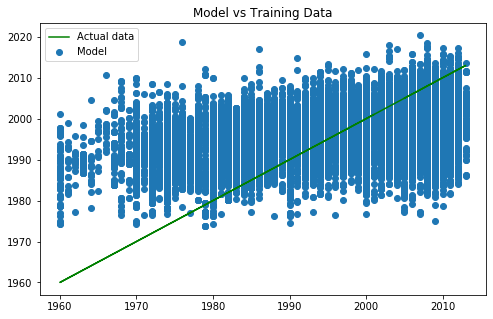

In [98]:
# Create a matplotlib figure
plt.figure(figsize=(8, 5))
# Create a scatterplot on the figure of y-train
plt.scatter(y_train, y_hat_train, label='Model')
# Plot y_hat_train
plt.plot(y_train, y_train, label='Actual data', color='g')
plt.title('Model vs Training Data')
plt.legend()

To further investigate our model, we can import statsmodels and use the summary method to view the various p values of our features, and the R squared and Adjusted R squared values.

In [99]:
# Import OLS from statsmodels
from statsmodels.formula.api import ols

In [100]:
# Import scipy.stats
import scipy.stats as stats
# Import statsmodels.api
import statsmodels.api as sm

In [101]:
train_year.columns

Index(['id', 'amount_tsh', 'gps_height', 'longitude', 'latitude', 'population',
       'construction_year', 'funder_counts', 'district_code_1',
       'district_code_2', 'district_code_3', 'district_code_4',
       'district_code_5', 'district_code_6', 'district_code_7',
       'district_code_8', 'district_code_13', 'district_code_23',
       'district_code_30', 'district_code_33', 'district_code_43',
       'district_code_53', 'district_code_60', 'district_code_62',
       'district_code_63', 'district_code_67', 'district_code_80',
       'public_meeting_True', 'permit_True', 'extraction_type_class_handpump',
       'extraction_type_class_motorpump', 'extraction_type_class_other',
       'extraction_type_class_rope pump', 'extraction_type_class_submersible',
       'extraction_type_class_wind-powered', 'payment_type_monthly',
       'payment_type_never pay', 'payment_type_on failure',
       'payment_type_other', 'payment_type_per bucket', 'payment_type_unknown',
       'source_type_d

In [102]:
# Create statsmodel linear regression
X_int = sm.add_constant(X)
model = sm.OLS(y,X_int).fit()
# View stats on model
model.summary()

C:\Users\morga\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      construction_year   R-squared:                       0.264
Model:                            OLS   Adj. R-squared:                  0.262
Method:                 Least Squares   F-statistic:                     155.6
Date:                Mon, 27 Apr 2020   Prob (F-statistic):               0.00
Time:                        18:52:33   Log-Likelihood:            -1.4661e+05
No. Observations:               38691   AIC:                         2.934e+05
Df Residuals:                   38601   BIC:                         2.942e+05
Df Model:                          89                                         
Covariance Type:            nonrobust                                         
======================================================================================================
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
const                               1379.2711      1.201   1148.251      0.000    1376.917    1381.625
id                                  -2.59e-06   2.55e-06     -1.018      0.309   -7.58e-06     2.4e-06
amount_tsh                          1.836e-05   1.59e-05      1.152      0.249   -1.29e-05    4.96e-05
gps_height                           1.61e-05      0.000      0.111      0.911      -0.000       0.000
longitude                             -0.0489      0.035     -1.384      0.166      -0.118       0.020
latitude                               0.1394      0.031      4.485      0.000       0.078       0.200
population                         -5.604e-05      0.000     -0.542      0.588      -0.000       0.000
funder_counts                         -0.0005   4.94e-05    -10.313      0.000      -0.001      -0.000
district_code_1                       85.7709      0.196    438.184      0.000      85.387      86.155
district_code_2                       85.6725      0.202    424.054      0.000      85.277      86.069
district_code_3                       87.1608      0.195    446.798      0.000      86.778      87.543
district_code_4                       84.6487      0.211    401.795      0.000      84.236      85.062
district_code_5                       85.0034      0.260    327.210      0.000      84.494      85.513
district_code_6                       84.5598      0.316    267.683      0.000      83.941      85.179
district_code_7                       87.2433      0.312    279.397      0.000      86.631      87.855
district_code_8                       78.8215      0.689    114.362      0.000      77.471      80.172
district_code_13                      91.7386      0.569    161.301      0.000      90.624      92.853
district_code_23                      94.1794      0.679    138.785      0.000      92.849      95.509
district_code_30                      86.1228      0.646    133.334      0.000      84.857      87.389
district_code_33                      82.2610      0.417    197.057      0.000      81.443      83.079
district_code_43                      90.5618      0.504    179.659      0.000      89.574      91.550
district_code_53                      84.3743      0.426    197.876      0.000      83.539      85.210
district_code_60                   -6.221e-13   3.97e-15   -156.650      0.000    -6.3e-13   -6.14e-13
district_code_62                      85.6889      1.034     82.848      0.000      83.662      87.716
district_code_63                      85.4632      0.861     99.231      0.000      83.775      87.151
district_code_67                    5.968e-13    4.4e-15    135.618      0.000    5.88e-13    6.05e-13
district_code_80                     7.77e-14   4.44e-15     17.485      0.000     6.9e-14    8.

We can see that only 26% of the features in our model are statistically relevant in the construction year of a waterpoint, which in certain cases would too low of a value for accurate predictions. However for the case of predicting the construction year, the R squared value is less important to us than the MSE. Now that we have analyzed the model, we will use it to predict the missing construction year values, and create a dataframe with these predicted values to be imputed in the original dataframe, replacing the 0 placeholders.

In [103]:
# Drop construction_year from 0 value dataframe
test_df = test_year.drop(['construction_year'], axis=1)

In [104]:
# Check dimensions of dataframe
test_df.shape

(20706, 97)

In [105]:
# Make year predictions on 
pred_year = linreg.predict(test_df)

In [106]:
# Change predictions into a pandas dataframe
pred_year_df = pd.DataFrame(pred_year)
# Check predictions dataframe
pred_year_df.head()

,0
0,2000.770303
1,2001.326298
2,2000.803094
3,1995.510426
4,1994.170911


In [107]:
# Change datatype of predictions to integer
pred_year_df['pred_year'] = pred_year_df[0].astype('int64')
# Drop the old prediction column
pred_year_df = pred_year_df.drop(0, axis=1)
# Check dataframe
pred_year_df.head()

,pred_year
0,2000
1,2001
2,2000
3,1995
4,1994


In [108]:
# Check shape of dataframe
pred_year_df.shape

(20706, 1)

In [109]:
# View predictions of dataframe
pred_year_df['pred_year'].value_counts(dropna=False)

1997    1801
1994    1548
1995    1543
1996    1458
1998    1332
1999    1240
1992    1198
1993    1195
2000    1103
1989     836
1991     779
1990     757
2001     636
1988     535
1987     513
2002     488
1985     480
1983     466
1986     444
2003     383
1984     322
2004     310
1980     223
1981     190
2005     177
1982     155
1979     106
2006      96
1978      83
1977      75
2007      68
2008      42
1976      30
2010      24
2009      19
1975      11
2011       9
1974       8
2012       6
2013       6
2014       4
2016       3
2017       2
1973       1
2015       1
Name: pred_year, dtype: int64

We can see from the results of `.value_counts()` that our model predicted that a well was constructed in 1997 most of the time, and in 1973 & 2015 the least. We will now make a copy of the year 0 instances, and replace that column with the column of our predicted values. Finally we will merge this new copy with imputed values with our original rows that do not contain 0 for the construction year.

In [110]:
# View id of test dataframe
test_year['id'].head()

38198    33391
51184    21726
43385    28228
48814    37910
13853      729
Name: id, dtype: int64

In [111]:
# Create new dataframe with 0 value construction years
test_year2 = df.loc[df['construction_year'] == 0].copy()

In [112]:
# Impute the predictions into this 0 value construction years
test_year2['construction_year'] = pred_year_df['pred_year'].to_numpy()

In [113]:
# Check dataframe
test_year2.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,True,GeoData Consultants Ltd,WUG,False,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,True,True
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,True,GeoData Consultants Ltd,WUG,False,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,True,True
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,True,GeoData Consultants Ltd,WUG,False,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,True,True
48814,37910,1000.0,danida,481,danida,37.365518,-11.258956,Matopeni,0,Ruvuma / Southern Coast,Mapinduzi,Ruvuma,10,1,Tunduru,Mtina,1,True,GeoData Consultants Ltd,VWC,False,1995,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,3326,3001-10000,True,True
13853,729,0.0,china government,284,china,38.561841,-11.134596,Kwa Mtuta,0,Ruvuma / Southern Coast,Msufini,Mtwara,90,63,Nanyumbu,Makonona,89,True,GeoData Consultants Ltd,VWC,True,1994,other,other,other,vwc,user-group,never pay,never pay,coloured,colored,seasonal,seasonal,shallow well,shallow well,groundwater,other,other,2013,1,3,short_dry,non functional,51,51-60,True,True


In [114]:
# Check dimensions of original dataframe
df.shape

(59397, 47)

In [115]:
# Check dimensions of newly predicted dataframe
test_year2.shape

(20706, 47)

Now we create a dataframe that contains only those original instances where `construction_year` did not equal 0. We will use `pd.concat()` to then join these two dataframes, effectively recreating the original dataframe but with the newly predicted values imputed to replace the placeholder values.

In [116]:
# Create new dataframe for original non-zero construction year waterpoints
train_year2 = df.loc[df['construction_year'] != 0].copy()
# Check dataframe
train_year2.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True
7328,57360,0.0,tasaf,439,tasaf,37.082702,-11.586297,Bomba,0,Ruvuma / Southern Coast,Tuleane,Ruvuma,10,1,Tunduru,Nalasi,1,False,GeoData Consultants Ltd,VWC,False,2010,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,4,short_dry,non functional,921,651-1000,True,True
51116,338,0.0,world bank,559,mkongo building contractor,36.463786,-11.568577,Kwa Mpechela,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,450,True,GeoData Consultants Ltd,VWC,True,2011,other,other,other,unknown,unknown,unknown,unknown,soft,good,unknown,unknown,machine dbh,borehole,groundwater,other,other,2013,2,6,short_dry,non functional,1384,1001-2000,True,True
27708,51453,500.0,drdp,568,dwe,36.465277,-11.566805,Kwa Waziri Ally,0,Ruvuma / Southern Coast,Magazini,Ruvuma,10,5,Namtumbo,Magazini,250,True,GeoData Consultants Ltd,WUG,False,2003,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,non functional,1,1-10,True,True


In [117]:
# Check shape of dataframe
train_year2.shape

(38691, 47)

In [118]:
# Recreate original dataframe with no 0 value construction years
fixed_year = pd.concat([test_year2, train_year2], axis=0)
# Check shape of dataframe
fixed_year.shape

(59397, 47)

In [119]:
# Check new dataframe
fixed_year.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,True,GeoData Consultants Ltd,WUG,False,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,True,True
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,True,GeoData Consultants Ltd,WUG,False,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,True,True
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,True,GeoData Consultants Ltd,WUG,False,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,True,True
48814,37910,1000.0,danida,481,danida,37.365518,-11.258956,Matopeni,0,Ruvuma / Southern Coast,Mapinduzi,Ruvuma,10,1,Tunduru,Mtina,1,True,GeoData Consultants Ltd,VWC,False,1995,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,3326,3001-10000,True,True
13853,729,0.0,china government,284,china,38.561841,-11.134596,Kwa Mtuta,0,Ruvuma / Southern Coast,Msufini,Mtwara,90,63,Nanyumbu,Makonona,89,True,GeoData Consultants Ltd,VWC,True,1994,other,other,other,vwc,user-group,never pay,never pay,coloured,colored,seasonal,seasonal,shallow well,shallow well,groundwater,other,other,2013,1,3,short_dry,non functional,51,51-60,True,True


In [120]:
# Ensure there are no 0 values in construction year for new dataframe
fixed_year['construction_year'].isin([0]).sum()

0

We have managed to use a linear regression model to predict the construction year for those waterpoints that contained a 0 for their construction year value. This should boost our model's predictive performance much more than having used `.fillna()` for those zeros with say the mode, median, or mean of the construction year. In the interest of confirming this, we can create three dataframes, one for replacing these zero values with the mode, mean, and median of the correct construction year values.

In [121]:
# Create new dataframe for original non-zero construction year waterpoints
year_mode = train_year2['construction_year'].mode()
# Check value
print(year_mode)
# Create a new dataframe
year_mode_df = df.copy()
# Replace 0 with mode
year_mode_df['construction_year'] = year_mode_df.construction_year.replace({0: 2010})
# View dataframe
year_mode_df.head(2)

0    2010
dtype: int64


,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True


In [122]:
# Create new dataframe for original non-zero construction year waterpoints
year_mean = train_year2['construction_year'].mean()
# Check value
print(year_mean)
# Create a new dataframe
year_mean_df = df.copy()
# Replace 0 with mean
year_mean_df['construction_year'] = year_mean_df.construction_year.replace({0: 1997})
# View dataframe
year_mean_df.head(2)

1996.8146855857951


,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True


In [123]:
# Create new dataframe for original non-zero construction year waterpoints
year_median = train_year2['construction_year'].median()
# Check value
print(year_median)
# Create a new dataframe
year_median_df = df.copy()
# Replace 0 with median
year_median_df['construction_year'] = year_median_df.construction_year.replace({0: 2000})
# View dataframe
year_median_df.head(2)

2000.0


,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,most_rec,most_perm
43832,20163,3000.0,danida,330,danida,37.351138,-11.649440,Namba 2,0,Ruvuma / Southern Coast,Umoja,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True
57743,42800,3000.0,danida,327,danida,37.351869,-11.648378,Namba 1,0,Ruvuma / Southern Coast,Mabibo,Ruvuma,10,1,Tunduru,Lukumbule,1,True,GeoData Consultants Ltd,VWC,False,1994,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional needs repair,3326,3001-10000,True,True


Lastly we will delete the `most_rec` and `most_perm` columns from our dataframe and move on to the exploratory phase of our pipeline.

In [124]:
# Drop most_rec and most_perm from dataframe
fixed_year = fixed_year.drop(['most_rec', 'most_perm'], axis=1)

In [125]:
# Check shape of cleaned dataframe
fixed_year.shape

(59397, 45)

We now have two less columns in our refined dataframe , and a more accurate `construction_year` feature. Let's move on to exploring our dataframe.

# Explore
***

In our exploratory phase, we will take a deeper look into the features of our dataset, looking for those dimensions that are closely related to our target variable and engineering new features based on those relevant ones. A great place to start our exploration of the data is to visualize the various distributions of our features. Let's do that now with histograms of our continuous data, and a pairplot showing relationships within the dataframe.

## Distributions

We will need to change the datatype of some of our features in order to create histograms to visualize them. We can start with our boolean variables `public_meeting` and `permit`. We can use `.astype('float64')` to transform the datatype from boolean to float. With these features changed, we can use the matplotlib `.hist()` method to create histograms of the continuous variables.

In [126]:
# Change boolean features to float
fixed_year['public_meeting'] = fixed_year['public_meeting'].astype('float64')
fixed_year['permit'] = fixed_year['permit'].astype('float64')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000295D18E5488>,
      dtype=object)

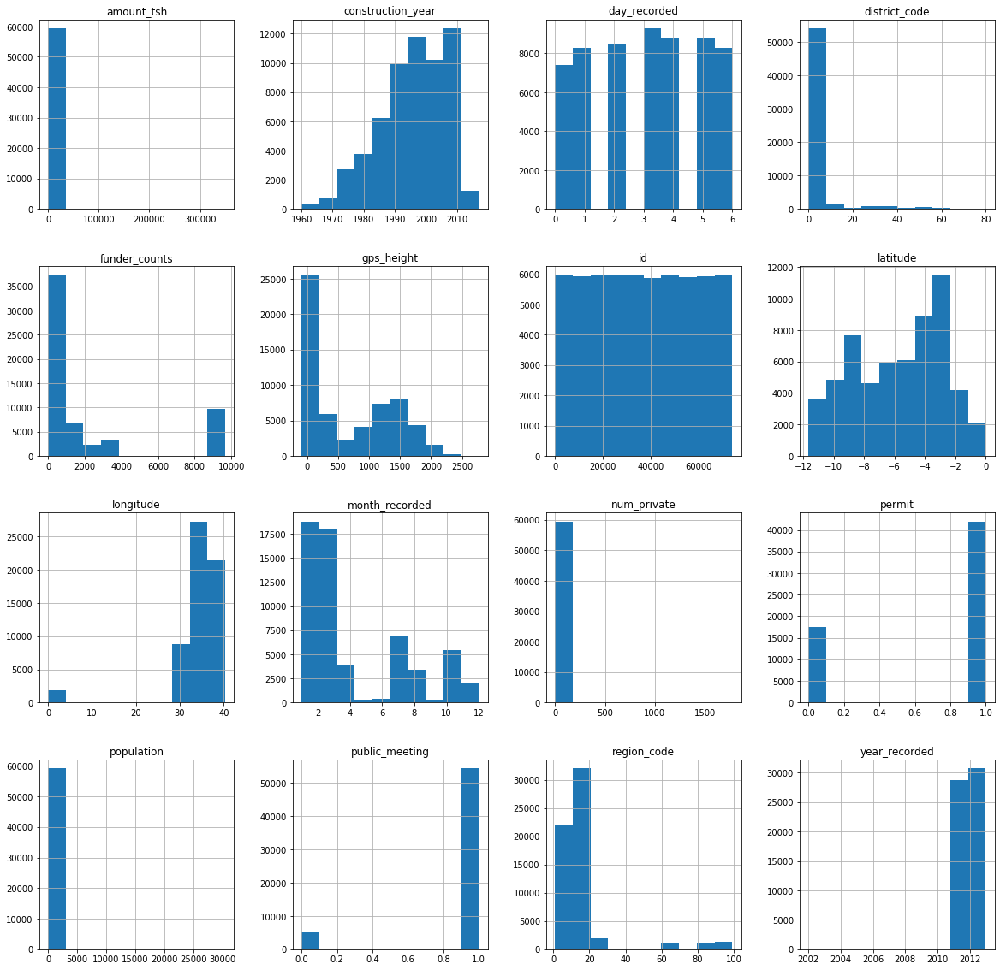

In [127]:
# Plot a histogram to dataframe's numeric variables
fixed_year.hist(figsize=(20,20))

We can see that there is not much normality in these features from the shapes of the distributions in the dataframe. In order to effectively visualize our data through a pairplot, we will need to change the datatype of a few more of our features, most importantly the target variable. We can again use `.astype()` to change the datatypes of our boolean columns and our target column.

In [128]:
# Change label type to categorical
fixed_year['status_group'] = fixed_year['status_group'].astype('category')
# Check changes
fixed_year.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150
48814,37910,1000.0,danida,481,danida,37.365518,-11.258956,Matopeni,0,Ruvuma / Southern Coast,Mapinduzi,Ruvuma,10,1,Tunduru,Mtina,1,1.0,GeoData Consultants Ltd,VWC,0.0,1995,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,3326,3001-10000
13853,729,0.0,china government,284,china,38.561841,-11.134596,Kwa Mtuta,0,Ruvuma / Southern Coast,Msufini,Mtwara,90,63,Nanyumbu,Makonona,89,1.0,GeoData Consultants Ltd,VWC,1.0,1994,other,other,other,vwc,user-group,never pay,never pay,coloured,colored,seasonal,seasonal,shallow well,shallow well,groundwater,other,other,2013,1,3,short_dry,non functional,51,51-60


In [129]:
# Import Label Encoder from Sci-Kit Learn
from sklearn.preprocessing import LabelEncoder
# Instantiate label Encoder
number = LabelEncoder()
# Create new target column
fixed_year['target'] = number.fit_transform(fixed_year['status_group'].astype('str'))
# Check changes
fixed_year.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0
48814,37910,1000.0,danida,481,danida,37.365518,-11.258956,Matopeni,0,Ruvuma / Southern Coast,Mapinduzi,Ruvuma,10,1,Tunduru,Mtina,1,1.0,GeoData Consultants Ltd,VWC,0.0,1995,swn 80,swn 80,handpump,vwc,user-group,pay annually,annually,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,3326,3001-10000,0
13853,729,0.0,china government,284,china,38.561841,-11.134596,Kwa Mtuta,0,Ruvuma / Southern Coast,Msufini,Mtwara,90,63,Nanyumbu,Makonona,89,1.0,GeoData Consultants Ltd,VWC,1.0,1994,other,other,other,vwc,user-group,never pay,never pay,coloured,colored,seasonal,seasonal,shallow well,shallow well,groundwater,other,other,2013,1,3,short_dry,non functional,51,51-60,2


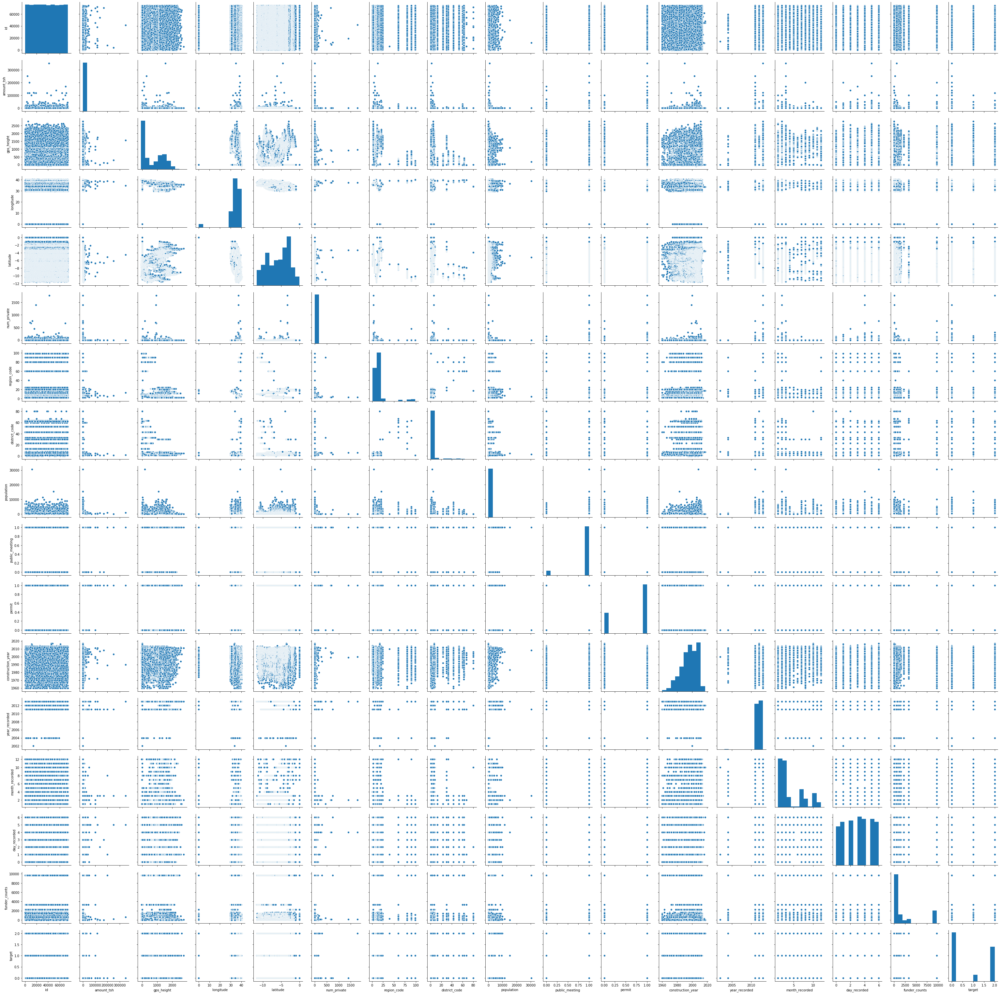

In [130]:
# Create pairpot of dataframe
year_pairplot = sns.pairplot(fixed_year)
# Save pairplot
# plt.savefig('pairplot for year_df')
# Show pairplot
# <img src= 'pairplot for year_df.png'>

<img src= 'img\pairplot for year_df.png'>

Through analyzing the paiplot, we can see that there are not many features that clearly have a relationship with the target variable. One column of note seems to be the `amount_tsh` column, however with so many datapoints it is difficult to gauge the distributions through the current scatterplots. It is also useful to check the number of unique values for each of the features to better understand the range of values for each dimension. This is vital in understanding how to manage certain features. We can get access to this information with a for loop that returns the `.nunique()` value for each column.

In [131]:
# Iterate through each feature and returns the number of unique values
for col in fixed_year.columns:
    print('{} : {}'.format(col, fixed_year[col].nunique()))

id : 59397
amount_tsh : 98
funder : 1896
gps_height : 2428
installer : 2057
longitude : 57513
latitude : 57514
wpt_name : 37399
num_private : 65
basin : 9
subvillage : 19286
region : 21
region_code : 27
district_code : 20
lga : 125
ward : 2092
population : 1049
public_meeting : 2
recorded_by : 1
scheme_management : 12
permit : 2
construction_year : 58
extraction_type : 18
extraction_type_group : 13
extraction_type_class : 7
management : 12
management_group : 5
payment : 7
payment_type : 7
water_quality : 8
quality_group : 6
quantity : 5
quantity_group : 5
source : 10
source_type : 7
source_class : 3
waterpoint_type : 7
waterpoint_type_group : 6
year_recorded : 5
month_recorded : 12
day_recorded : 7
seas_recorded : 4
status_group : 3
funder_counts : 163
funder_points : 17
target : 3


It can also be useful to explore the correlation between our features via a seaborn heatmap. A heatmap can help us visualize which features may have a stronger relationship with our target variable. We can create a heatmap of the correlations between features in the dataset with `.heatmap()` and the `.corr()` method.

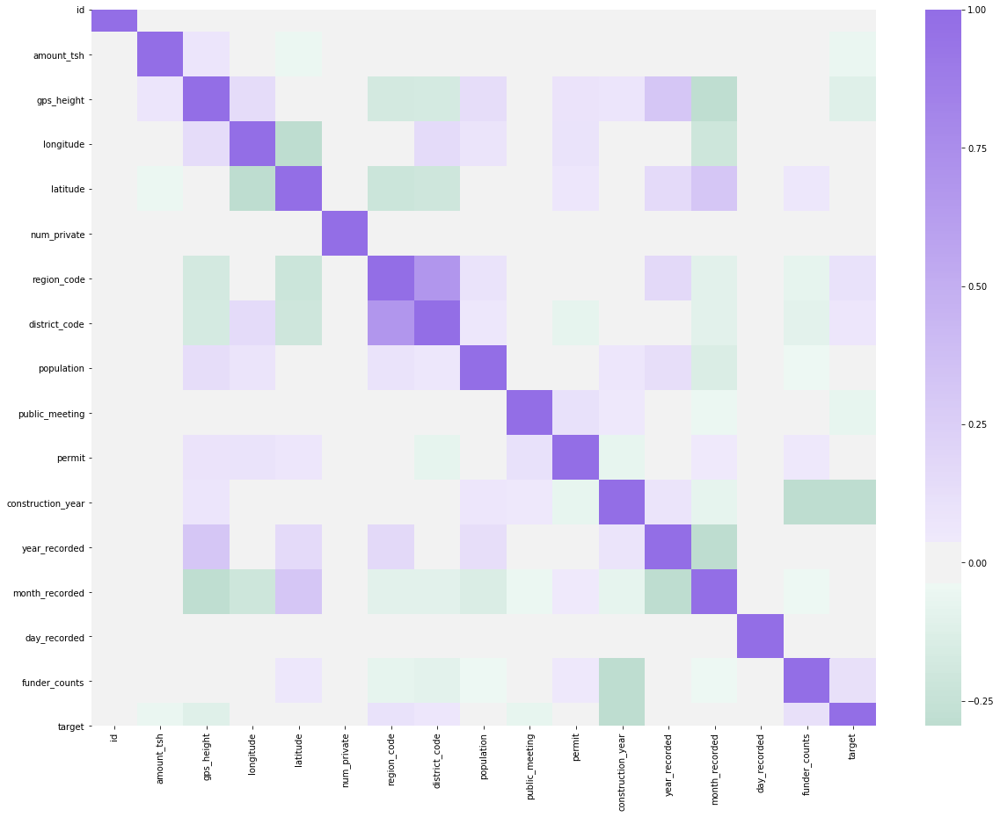

In [132]:
# Create a seaborn heatmap to show correlations
fig, ax = plt.subplots(figsize=(20,15))
cmap = sns.diverging_palette(150, 275, s=80, l=55, n=9, as_cmap=True)
sns.heatmap(fixed_year.corr(), center=0, cmap=cmap, robust=True)

Our heatmap indicates to us that `funder_counts`, `region_code`, and `district_code` have a positive correlation with the target variable, while `amount_tsh`, `gps_height`, `public_meeting`, and `construction_year` have a negative correlation with the target variable. Now with more information regarding distributions within our dataset, let's explore some key features.

## Water Source Exploration

We can see that those water sources that have higher than a 500 value are more likely considered functioning than in another category. Let's take a closer look at the relationship between the `amount_tsh` and `target` column. We will start by checking the number of unique values in the column, then viewing those values.

In [133]:
# Return the count of unique values in series
fixed_year['amount_tsh'].nunique()

98

In [134]:
# Return the unique values within the series
fixed_year['amount_tsh'].unique()

array([5.00e+02, 1.00e+03, 0.00e+00, 2.00e+01, 5.00e+01, 9.00e+00,
       3.00e+02, 1.00e+01, 3.06e+02, 3.00e+01, 1.00e+02, 6.00e+03,
       2.50e+01, 5.00e+03, 5.00e+04, 2.00e+03, 3.60e+03, 2.40e+03,
       1.20e+03, 2.00e+02, 1.50e+04, 3.00e+04, 2.00e+04, 1.50e+02,
       4.00e+01, 2.00e+05, 7.00e+00, 2.50e+02, 2.00e-01, 6.00e+00,
       1.00e+04, 3.00e+03, 3.50e+03, 2.50e+03, 4.00e+03, 4.50e+03,
       1.50e+03, 1.30e+03, 1.20e+04, 5.50e+02, 6.00e+02, 4.00e+02,
       3.50e+01, 7.00e+01, 8.00e+02, 5.30e+01, 8.00e+03, 6.00e+01,
       5.00e+00, 1.50e+01, 9.00e+02, 1.00e+05, 5.40e+03, 6.30e+03,
       2.20e+03, 2.50e+04, 1.17e+05, 1.63e+04, 4.70e+03, 2.80e+03,
       4.00e+04, 2.20e+02, 4.50e+04, 5.90e+01, 1.30e+04, 1.60e+04,
       7.00e+03, 1.20e+01, 8.50e+03, 1.10e+04, 2.60e+04, 1.70e+05,
       1.80e+04, 7.50e+02, 1.38e+05, 7.00e+04, 1.40e+04, 2.50e+05,
       3.80e+04, 7.00e+02, 1.00e+00, 5.90e+02, 5.20e+02, 3.50e+05,
       6.50e+03, 9.00e+03, 1.40e+03, 5.50e+03, 1.20e+05, 2.00e

In [135]:
# Return the unique values of the value counts in the series
fixed_year['amount_tsh'].value_counts().unique()

array([41636,  3102,  2472,  1488,  1463,  1220,   816,   806,   743,
         704,   569,   557,   450,   376,   356,   334,   267,   197,
         190,   176,   156,   145,   139,   125,    69,    61,    59,
          57,    51,    45,    42,    31,    24,    23,    21,    20,
          16,    15,    14,    13,    12,    10,     9,     8,     7,
           5,     4,     3,     2,     1], dtype=int64)

We can see that there is an extremely high bias in the `amount_tsh` column. We have over 41000 instances of a certain value. We can use a seaborn distplot to view which value this is, and its relative size to the other values with `sns.distplot()`.

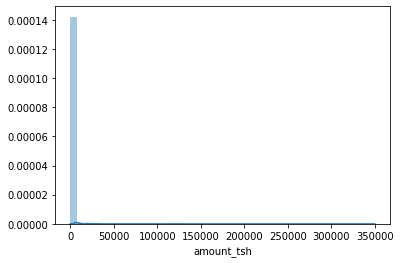

In [136]:
# Visualize distribution of values in the series
sns.distplot(fixed_year['amount_tsh'])

In [137]:
# Return the number of 0 values in amount_tsh
41636 / 59400

0.700942760942761

We can see that the 70% of the waterpoints found in the dataset are labeled as having 0 as the amount of water available at the  waterpoint. This seems to be an issue, how can a waterpoint function when there is no water in its water source. To better understand how to manage this feature, we will need to analyze the location of water sources and the distributions of the targets in association with the water source amount to see if there is a correlation between a waterpoint not functioning and a waterpoint that has no water in its water source.

In [138]:
# View distribution of amounts of water available by target variable
fixed_year.groupby(['target', 'amount_tsh']).size().unstack(fill_value=0)

amount_tsh,0.00,0.20,0.25,1.00,2.00,5.00,6.00,7.00,9.00,10.00,12.00,15.00,20.00,25.00,26.00,30.00,33.00,35.00,40.00,50.00,53.00,59.00,60.00,70.00,100.00,150.00,200.00,220.00,250.00,300.00,306.00,350.00,400.00,450.00,500.00,520.00,550.00,590.00,600.00,700.00,750.00,800.00,900.00,1000.00,1200.00,1300.00,1400.00,1500.00,2000.00,2200.00,2400.00,2500.00,2800.00,3000.00,3500.00,3600.00,4000.00,4500.00,4700.00,5000.00,5400.00,5500.00,6000.00,6300.00,6500.00,7000.00,7200.00,7500.00,8000.00,8500.00,9000.00,10000.00,11000.00,12000.00,13000.00,14000.00,15000.00,16000.00,16300.00,18000.00,20000.00,25000.00,26000.00,30000.00,38000.00,40000.00,45000.00,50000.00,60000.00,70000.00,100000.00,117000.00,120000.00,138000.00,170000.00,200000.00,250000.00,350000.00
target,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,19704,0,1,0,13,330,174,54,0,623,1,14,970,280,1,528,20,6,47,1634,1,0,14,6,557,7,789,1,302,358,0,3,30,37,2226,1,0,2,66,3,38,2,1,1121,222,10,1,154,522,31,97,90,13,240,4,23,116,1,23,354,1,5,94,1,9,4,12,8,49,1,1,48,1,44,1,2,15,2,2,4,42,8,2,6,1,7,3,3,0,1,2,6,1,1,1,1,1,1
1,3048,0,0,0,0,0,3,0,0,16,0,0,76,18,0,35,0,0,1,107,0,0,0,3,60,0,120,0,154,58,0,0,0,0,274,0,0,0,72,4,9,0,0,86,14,0,0,10,31,0,3,4,0,38,0,10,10,1,0,34,0,0,4,0,0,1,0,0,4,0,1,1,0,3,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0
2,18884,3,0,3,0,46,13,15,1,167,0,1,417,58,0,180,0,2,11,731,0,1,1,14,199,14,311,0,113,141,1,0,12,5,602,1,3,0,38,17,12,0,0,281,31,0,0,33,151,0,45,45,1,56,1,9,30,0,0,62,0,0,27,0,0,2,0,0,8,0,1,8,1,4,1,1,1,0,0,0,3,0,0,2,0,0,0,0,1,0,0,1,0,0,0,0,0,0


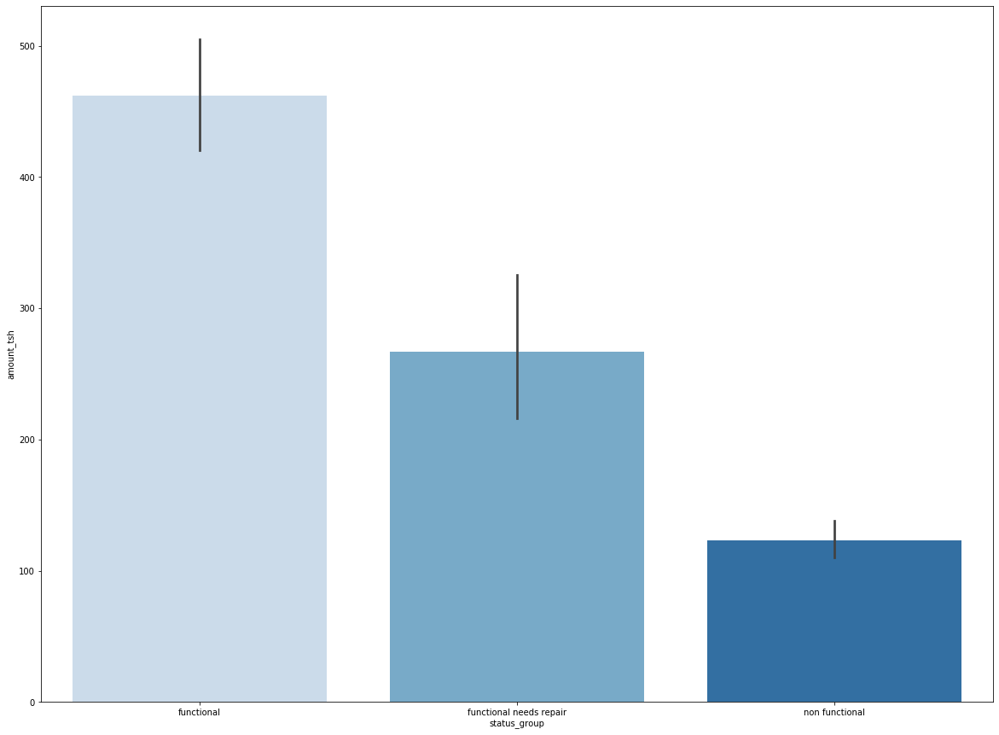

In [139]:
# Visualize averages of amount of water available by status group with barplot
fig, ax = plt.subplots(figsize=(20,15))
# Create barplot of status group and amount_tsh
sns.barplot(x="status_group", y='amount_tsh', data=fixed_year, palette="Blues")

Our barplot shows us that on average the functional waterpoints have a higher `amount_tsh` value, and that the non functional wells on average have the least amount of water available. Functional but in need of repair wells have the highest uncertainty in amount_tsh of wells. Let's further explore this dimension of our dataset with a scatterplot.

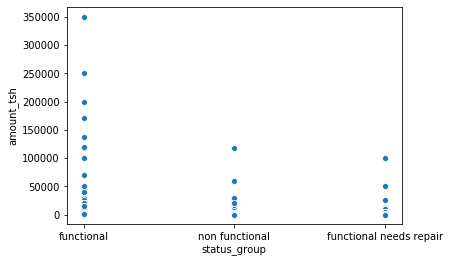

In [140]:
# Create scatterplot to visualize these distributions
sns.scatterplot('status_group', 'amount_tsh', data=fixed_year)

Another feature in our dataset that describes the amount of water available to a well is the `quantity` column. We can use a `.groupby()` chain with `.size()` and `.unstack()` to view the precise numbers of quantity values by status group. We can also visualize these valuse by creating a countplot which shows the distributions of the quantity levels as they relate to the target variables.

In [141]:
# View distributions of quantity with target
fixed_year.groupby(['status_group', 'quantity']).size().unstack(fill_value=0)

quantity,dry,enough,insufficient,seasonal,unknown
status_group,,,,,
functional,157,21647,7915,2325,213
functional needs repair,37,2400,1450,416,14
non functional,6052,9137,5763,1309,562


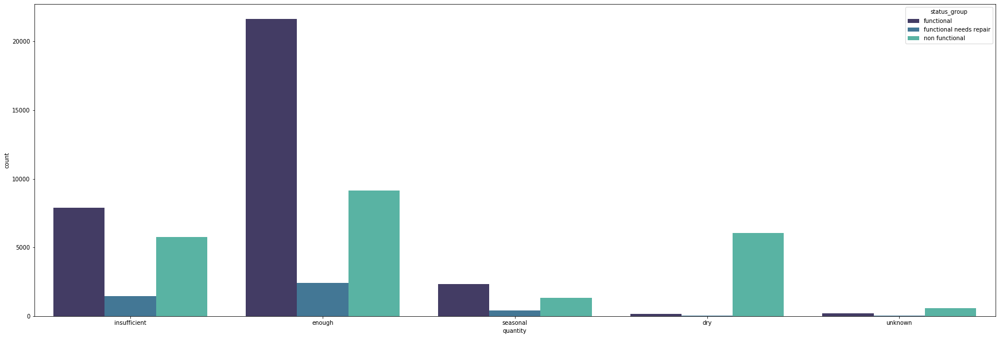

In [142]:
# Instantiate figure object
fig = plt.gcf()
# Set size of figure object to be larger
fig.set_size_inches(30, 10)
# Create countplot in the figure of quantities by status group
sns.countplot(x="quantity", hue="status_group", data=fixed_year, palette='mako')

We can see that most functional wells are considered to have enough water quantity. Dry quantity levels have the highest ratio of non-functional wells to functional wells. Let's see the `quantity` levels relate to `amount_tsh` with another barplot.

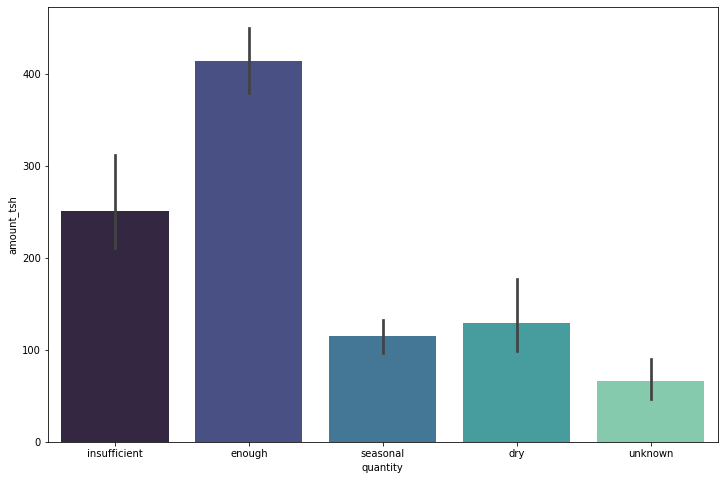

In [143]:
# Visualize averages of amount of water available by status group with barplot
fig = plt.gcf()
# Change figure size
fig.set_size_inches(12, 8)
# Create barplot
sns.barplot(x="quantity", y='amount_tsh', data=fixed_year, palette='mako')

As expected, the enough column has the highest average of amount_tsh, while dry has one of the lowest. It is interesting to note that seasonal quantity and unknown are even lower than dry. We can further explore the relationships of these two variables with another barplot that has a hue set to the `status_group` column.

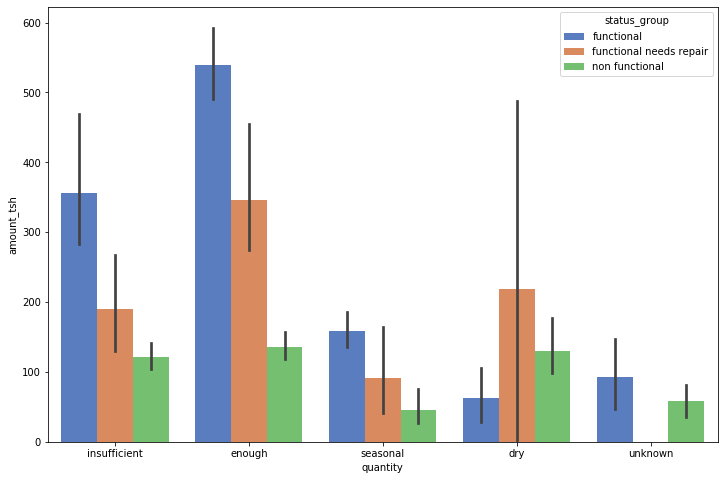

In [144]:
# Instantiate a figure object
fig = plt.gcf()
# Change the figure size
fig.set_size_inches(12, 8)
# Create a barplot of the quanity by amount_tsh for the target variables
g = sns.barplot(x="quantity", y="amount_tsh", hue="status_group", data=fixed_year, palette='muted')

It is interesting to see in our barplot that the dry column for functional needs repair wells has a very uncertainty in the reported measurements. Let's explore the `water_quality` column as it relates to the target with similar methods as shown for the `amount_tsh` column.

In [145]:
# View percentage of waterpoints by extraction type
fixed_year['water_quality'].value_counts(normalize=True)

soft                  0.855531
salty                 0.081755
unknown               0.031584
milky                 0.013536
coloured              0.008250
salty abandoned       0.005691
fluoride              0.003367
fluoride abandoned    0.000286
Name: water_quality, dtype: float64

In [146]:
# View distributions of water quality with target
fixed_year.groupby(['status_group', 'water_quality']).size().unstack(fill_value=0)

water_quality,coloured,fluoride,fluoride abandoned,milky,salty,salty abandoned,soft,unknown
status_group,,,,,,,,
functional,246,151,6,438,2220,173,28759,264
functional needs repair,54,13,0,14,225,72,3904,35
non functional,190,36,11,352,2411,93,18153,1577


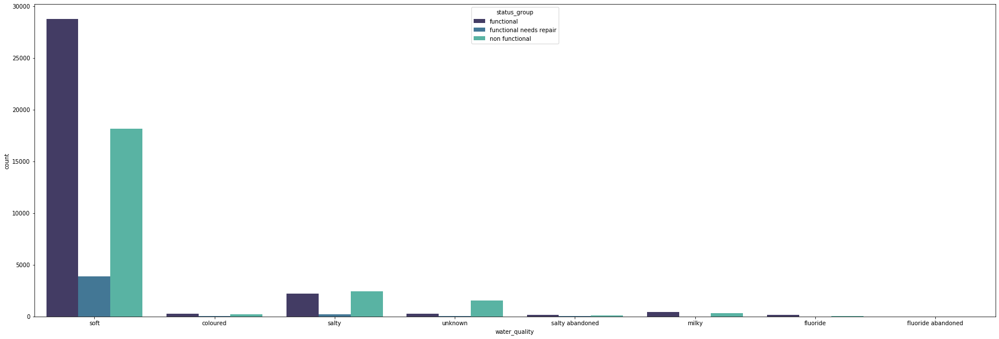

In [147]:
# Instantiate figure
fig = plt.gcf()
# Change figure size
fig.set_size_inches(30, 10)
# Create countplot for water quality by status group
sns.countplot(x="water_quality", hue="status_group", data=fixed_year, palette='mako')

We can see that our dataset is highly biased to the soft water quality. We can also see that if a well's quality is soft, the well is most likely functional. However where the well is considered salty or unknown, it is more likely to be non-functioning. Let's continue our exploration by looking into the `quality_group` column with similar methods.

In [148]:
# View percentage of waterpoints by extraction type
fixed_year['quality_group'].value_counts(normalize=True)

good        0.855531
salty       0.087445
unknown     0.031584
milky       0.013536
colored     0.008250
fluoride    0.003653
Name: quality_group, dtype: float64

In [149]:
# View distributions of quality_group with target
fixed_year.groupby(['status_group', 'quality_group']).size().unstack(fill_value=0)

quality_group,colored,fluoride,good,milky,salty,unknown
status_group,,,,,,
functional,246,157,28759,438,2393,264
functional needs repair,54,13,3904,14,297,35
non functional,190,47,18153,352,2504,1577


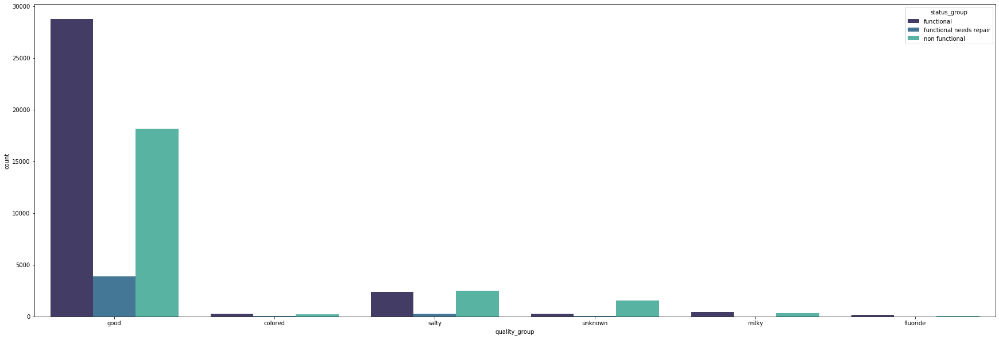

In [150]:
# Instantiate figure
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create countplot of quality_group and status_group
sns.countplot(x="quality_group", hue="status_group", data=fixed_year, palette='mako')

We can see a similar distribution from `quality_group` as the `water_quality`. Here most functioning wells are considered good where if a well is considered salty, it is more likely a non-functioning well. We can view how `quality_group` compares with `amount_tsh` in a barplot.

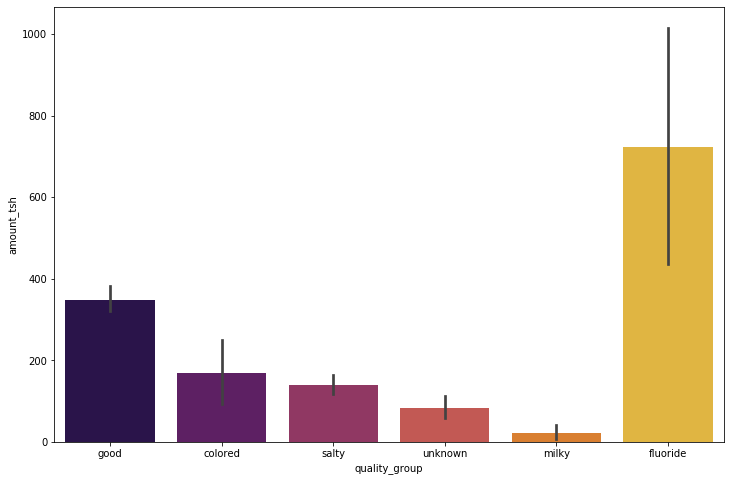

In [151]:
# Instantiate figure
fig = plt.gcf()
# Set size of figure
fig.set_size_inches(12, 8)
# Create barplot of quality group by amount tsh
sns.barplot(x="quality_group", y='amount_tsh', data=fixed_year, palette='inferno')

We can see from our barplot that fluoride wells have the highest average of water, while they are some of the rarest wells in Tanzania. However there is a large uncertainty to the measurements within the data for fluoride wells. Let's see how this distribution relates to the functionality of a well with a barplot with hue set to `status_group`.

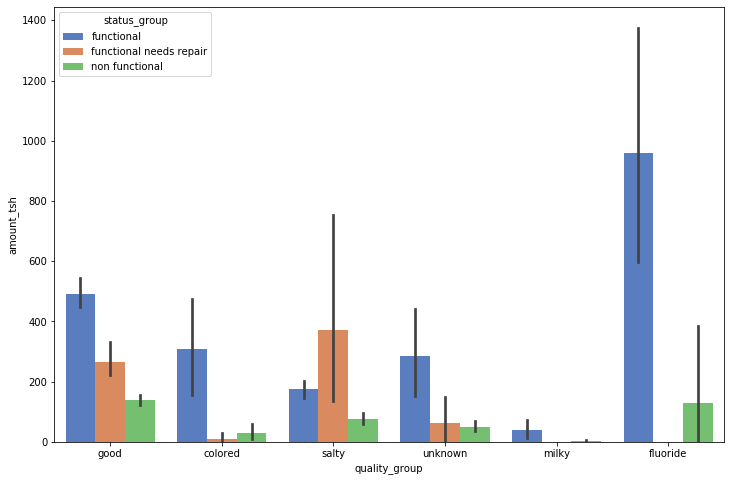

In [152]:
# Instantiate figure
fig = plt.gcf()
# Change figure size
fig.set_size_inches(12, 8)
# Create barplot of quality group by amount_tsh for status_group
g = sns.barplot(x="quality_group", y="amount_tsh", hue="status_group", data=fixed_year, palette='muted')

Our barplot further expounds on the understanding that fluoride wells with high levels of `amount_tsh` are likely to be functioning, where large amount_tsh values in salty and good wells are most likely non_functioning. Next we can explore the `extraction_type_class` distibutions. Let's start with the `.value_counts()` method.

In [153]:
# View percentage of waterpoints by extraction type
fixed_year['extraction_type_class'].value_counts(normalize=True)

gravity         0.450865
handpump        0.277034
other           0.108221
submersible     0.104029
motorpump       0.050289
rope pump       0.007593
wind-powered    0.001970
Name: extraction_type_class, dtype: float64

In [154]:
# View distributions of extraction_type_class with status group
fixed_year.groupby(['status_group', 'extraction_type_class']).size().unstack(fill_value=0)

extraction_type_class,gravity,handpump,motorpump,other,rope pump,submersible,wind-powered
status_group,,,,,,,
functional,16048,10374,1135,1028,293,3329,50
functional needs repair,2701,995,138,206,17,253,7
non functional,8031,5086,1714,5194,141,2597,60


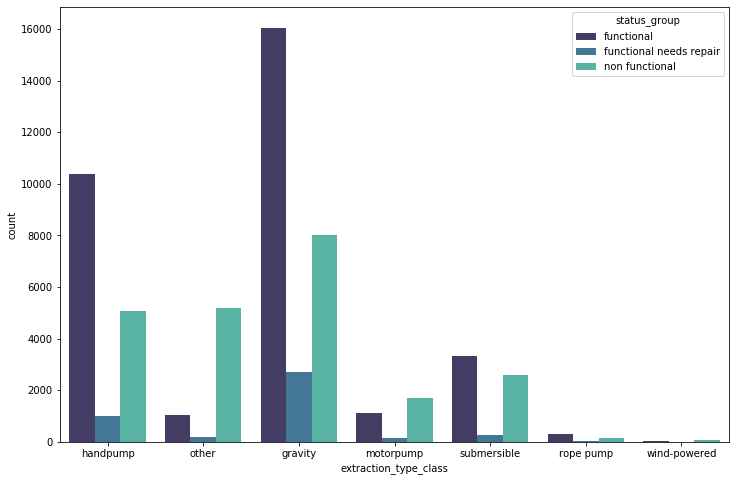

In [155]:
# Instantiate figure
fig = plt.gcf()
# Change size of figure
fig.set_size_inches(12, 8)
# Create countplot of extraction_type_class and status group
g = sns.countplot(x="extraction_type_class", hue="status_group", data=fixed_year, palette='mako')

We can see that gravity wells are the most common type, with an almost 2:1 ratio of functional to non-functional wells. A well that is classified as other, motorpump, wind-powered is more likely to be non-functioning than functioning. Let's see how `extraction_type_class` relates to `amount_tsh` with a barplot.

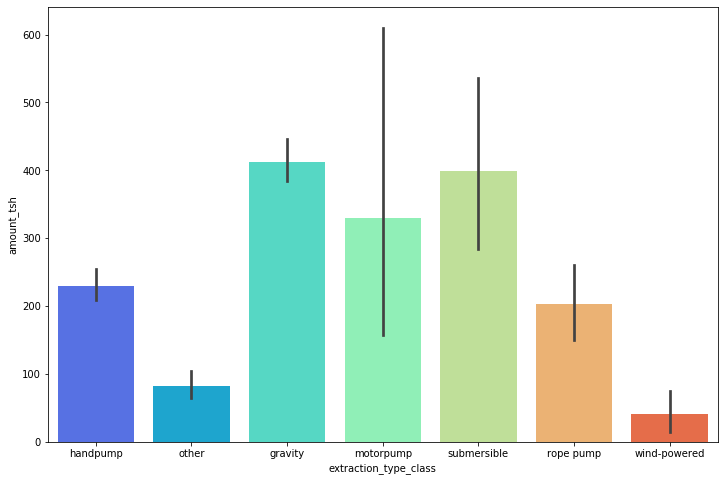

In [156]:
# Instantiate figure
fig = plt.gcf()
# Change figure size
fig.set_size_inches(12, 8)
# Create a barplot of the extraction_type_class by amount_tsh
sns.barplot(x="extraction_type_class", y='amount_tsh', data=fixed_year, palette='rainbow')

Our barplot shows us that gravity wells are connected to the highest levels of `amount_tsh`. Wind-powered wells appear to have the lowest levels of `amount_tsh`. We can see how these relationships interact with the functionality of the well with a barplot with hue set to `status_group`.

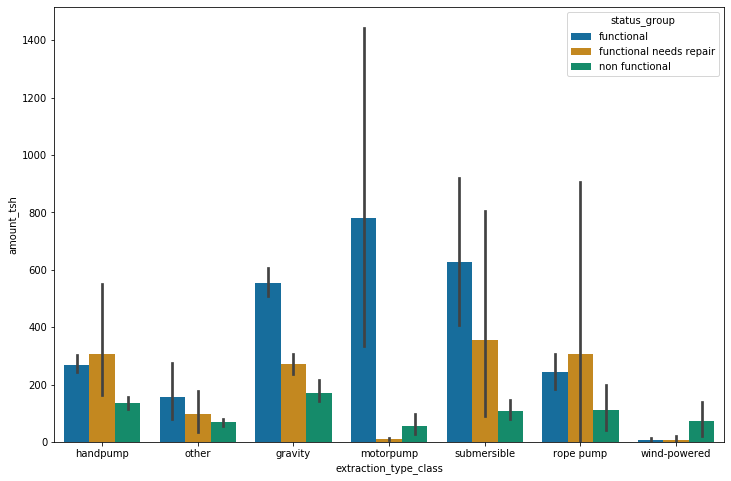

In [157]:
# Instantiate figure
fig = plt.gcf()
# Set figure size
fig.set_size_inches(12, 8)
# Create barplot of extraction_type_class by amount_tsh for status_group
g = sns.barplot(x="extraction_type_class", y="amount_tsh", hue="status_group", data=fixed_year, palette='colorblind')

From our bar plot we can see that when a well has a motorpump, gravity, or submersible type and large level of amount_tsh, it is most likely a functional well. If a well is a handpump or rope pump type with relatively large values of amount_tsh, it is most likely functional but in need of repair. Now let's explore the `source_type` dimension of our dataframe.

In [158]:
# View distributions of source_type with status group
fixed_year.groupby(['status_group', 'source_type']).size().unstack(fill_value=0)

source_type,borehole,dam,other,rainwater harvesting,river/lake,shallow well,spring
status_group,,,,,,,
functional,5919,253,158,1386,5626,8323,10592
functional needs repair,508,24,5,314,1233,957,1276
non functional,5522,379,115,595,3516,7543,5153


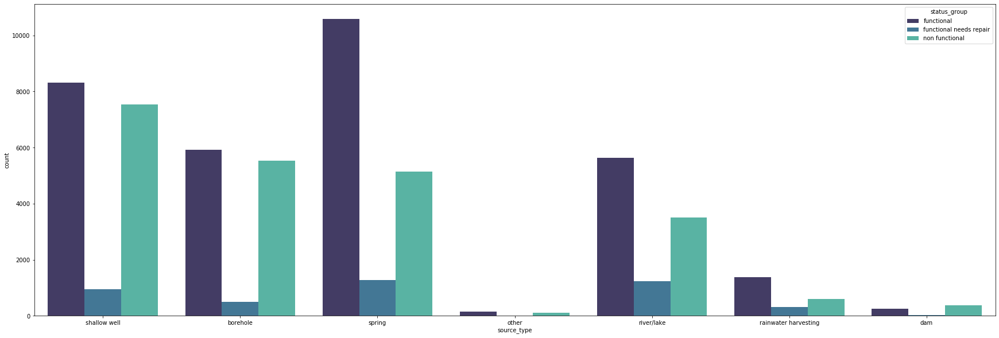

In [159]:
# Instantiate figure
fig = plt.gcf()
# Change figure size
fig.set_size_inches(30, 10)
# Create countplot with source_type and status_group
sns.countplot(x="source_type", hue="status_group", data=fixed_year, palette='mako')

We can see that spring water and shallow water wells are the most common wells, while dam and other are the rarest. For most well types there are more functioning wells than none functioning wells, which is a ratio we would prefer in this dataset. Let's compare the source type and the amount tsh to view distributions in regard to the target variable with a barplot.

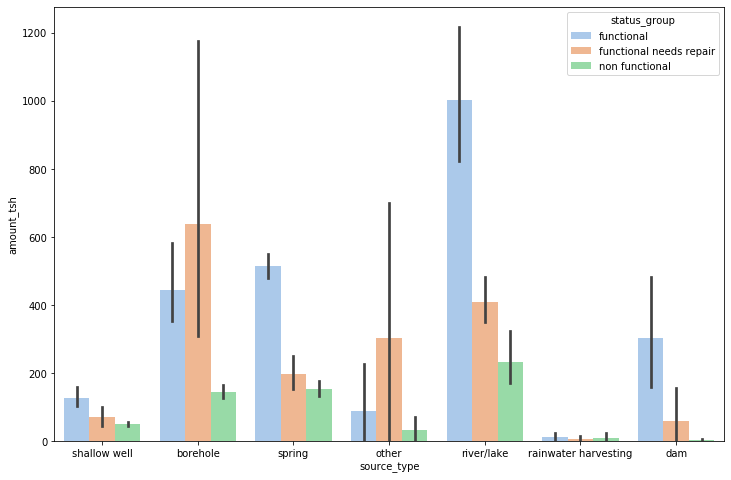

In [160]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(12, 8)
# Create barplot of source_type by amount_tsh for status_group
g = sns.barplot(x="source_type", y="amount_tsh", hue="status_group", data=fixed_year, palette='pastel')

Our barplot shows that river/lake wells with large amounts of water accessibility are most likely functional, but if a well has a borehole or other source, it is most likely non-functioning. Our exploration of the water source has yielded invaluable observations in determining the functionality of a well, which we can summarize in our observations section.

### Water Source Observations

From our explorations into the various water source dimensions of our dataset, we have been able to find certain patterns that may be indicators for predicting the functioning status of a waterpoint. We can see from our visualizations that:

 - **Amount_tsh**
     - High levels of water available to a waterpoint appears correlated to the waterpoint being functional
     - Low levels of amount_tsh appears related to non-functionality. This could indicate that the waterpoint is dry with no water to offer
 
 - **Quantity**
     - Enough level of water quantity is linked to a waterpoint being functional
     - Dry level of water quantity has a high relation to non-functional waterpoints further indicating low amounts of water could cause a waterpoint to stop functioning.
     
 - **Quality**
     - Most waterpoints connected to large amounts of water have Fluoride and Good quality. These quality levels have a high relationship with functional waterpoints.
     
 - **Extraction**
     - Most wells are gravity and handpump wells, with these types having the highest amount of functioning waterpoints.
     - The functioning wells connected to the largest sources of water are using a motorpump.
     
 - **Source**
     - The source type with the most functioning wells is Spring Well. 
     - The source type with the most non-functioning wells is the Shallow Well, which again could indicate that shallow wells may dry faster.
     

## Geographical Exploration


After exploring the water amount distributions, we can take a look at how geography effects the functionality of a waterpoint. Tanzania's hydrology contains some of the largest lakes in the world. We can start exploring the Geographical component of our dataset by creating a scatterplot of the `latitude` and `longitude` values, effectively mapping out the location of the waterpoints.

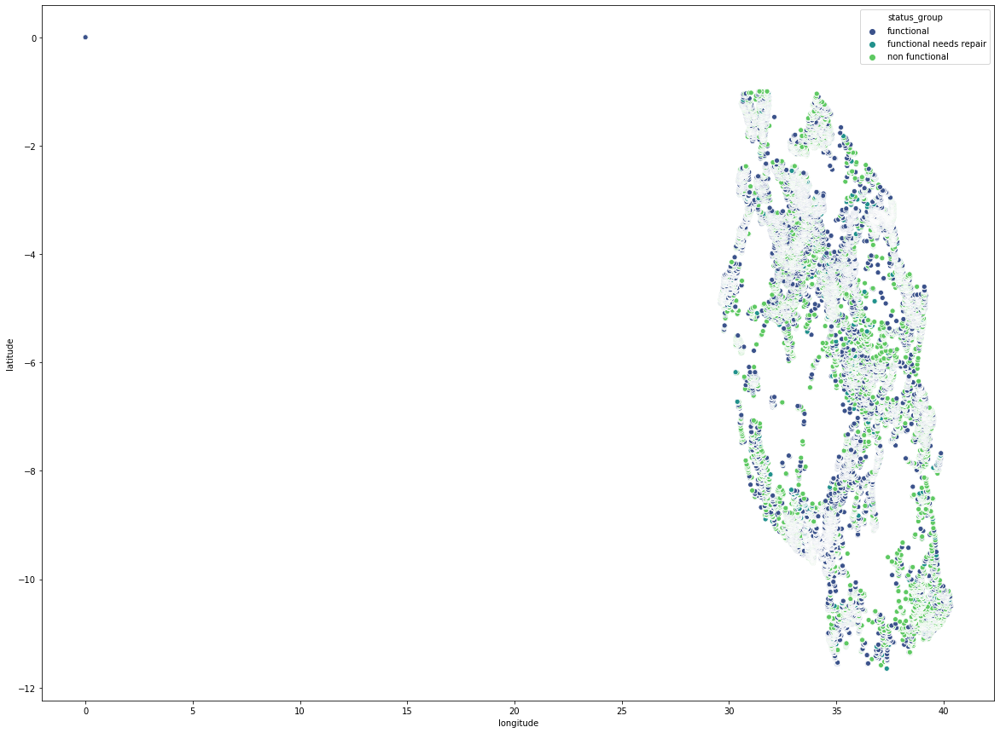

In [161]:
# Instantiate figure and set its size
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='status_group', data=fixed_year, palette='viridis')

Our scatterplot is misshapen due to an outlier. There appears to be a waterpoint at 0 degrees longitude and 0 degrees latitude. This would place the waterpoint in Null Island in the Gulf of Guinea in the Atlantic Ocean. In order to make our dataset and visualization more accurate, we can remove this row from our dataframe and create our scatterplot once more.

In [162]:
# Create new dataframe without the 0,0 coordinate waterpoint
fixed_map = fixed_year[fixed_year['longitude'] != 0]

In [163]:
# Check new dataframe
fixed_map.head(2)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0


Let's get a more accurate and larger view of the geographical distribution of the waterpoints in Tanzania.

In [164]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(200,150))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='status_group', s=200, data=fixed_map, palette='viridis')
# Save scatterplot
#    plt.savefig('scatterplot of wells sizes')
# Show scatterplot
#    <img src= 'scatterplot of wells sizes.png'>

<img src= 'scatterplot of wells sizes.png'>

This scatterplot fits the shape of Tanzania much better. We can superimpose this map on top of a map depicting the water systems of Tanzania to find any patterns between the locations of waterpoints and their functionality. We will use a map showing the locations of the bodies of water in Tanzania, and superimpose our scatterplot on top of this map to see how the location distributions of the wells relate to the bodies of water in Tanzania.

In [165]:
# Import map of Tanzanian Hydrology
img = plt.imread("img\Tanzania_Hydrology_cropped.jpg")
# View type of map
type(img)

numpy.ndarray

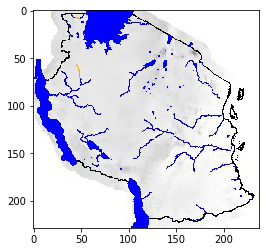

In [166]:
# View map
plt.imshow(img)

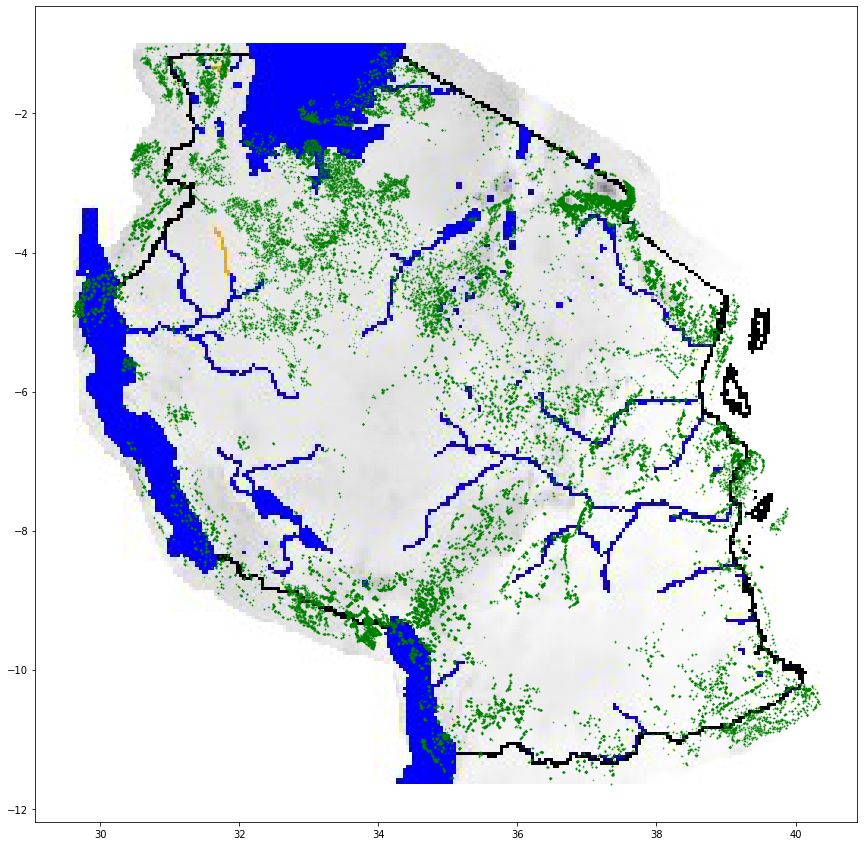

In [167]:
# Create list objects from longitude and latitude columns
x = fixed_map['longitude']
y = fixed_map['latitude']

# Create image object
img = plt.imread("img\Tanzania_Hydrology_cropped.jpg")

# Instantiate figure and axis
fig, ax = plt.subplots(figsize=(20,15))
# Set axes of image
ax.imshow(img, extent=[x.min(), x.max(), y.min(), y.max()])
# Create scatterplot with same axis of map
ax.scatter(x, y, color='green', marker='o', alpha=0.5, s=0.7)

We can see from our image how many of the wells are located near a body of water, but our map and scatterplot are not well aligned and do not separate among the classes of functionality to analyze any geographical patterns. Let's use a more detailed map image of a larger size, and implement a change in color based on functionality in the scatter plot.

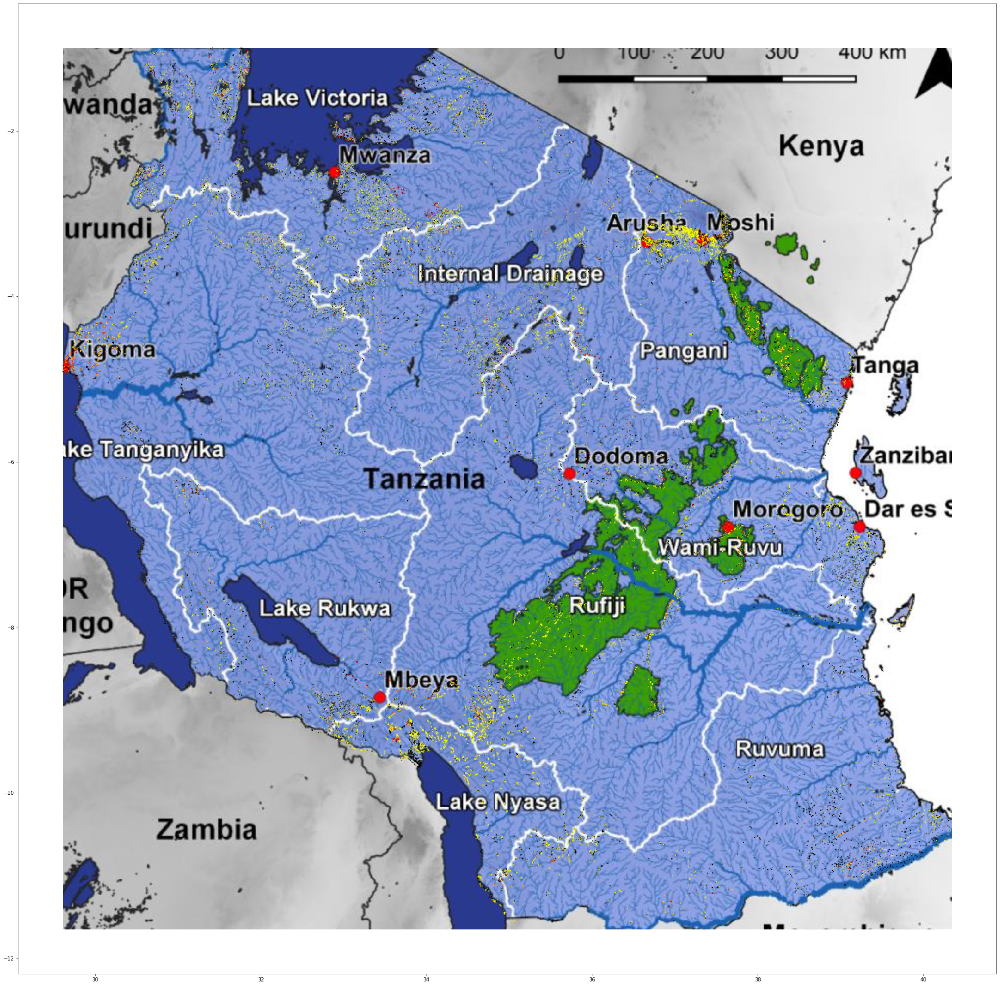

In [168]:
x = fixed_map['longitude']
y = fixed_map['latitude']
colors = {'functional':'yellow', 'non functional':'black', 'functional needs repair':'red'}

img1 = plt.imread("img\Tanzanian_water.png")

fig, ax = plt.subplots(figsize=(50,35))
ax.imshow(img1, extent=[x.min(), x.max(), y.min(), y.max()], aspect='equal')
ax.scatter(x, y, marker='o', alpha=0.5, s=0.75, c=fixed_map['status_group'].apply(lambda x: colors[x]))
# Save scatterplot
# plt.savefig('scatterplot of area')

In [169]:
# View the status_group distributions in dataset
fixed_map['status_group'].value_counts(normalize=True)

functional                 0.545055
non functional             0.386681
functional needs repair    0.068264
Name: status_group, dtype: float64

<img src= 'scatterplot of area.png'>

With this map we can see how the waterpoints match with the locations of rivers and lakes in Tanzania. Functional wells are **yellow**, non-functional wells are **black**, and wells in need of repair are **red**. There does not appear to be much variation in the geographical distributions of functionality among the wells. We can see however a large cluster of wells in need of repair in Kigoma. There appears to be a large cluster of Functional wells in Arusha and Moshi. We can see how nearly all of the wells are quite close to a spring of river water source, and how lake waterpoints line along the coasts of the large wells. Let's continue exploring the spatial dimension of our dataset with the `region` column.

In [170]:
# View distributions of region with target
fixed_map.groupby(['status_group', 'region']).size().unstack(fill_value=0)

region,Arusha,Dar es Salaam,Dodoma,Iringa,Kagera,Kigoma,Kilimanjaro,Lindi,Manyara,Mara,Mbeya,Morogoro,Mtwara,Mwanza,Pwani,Rukwa,Ruvuma,Shinyanga,Singida,Tabora,Tanga
status_group,,,,,,,,,,,,,,,,,,,,,
functional,2294,461,1009,4141,1727,1363,2640,460,987,886,2319,2119,524,1130,1556,707,1480,2289,1011,848,1436
functional needs repair,175,3,209,123,304,603,322,93,96,60,504,300,126,137,36,135,164,295,128,45,73
non functional,881,341,983,1030,1285,850,1417,993,500,1023,1816,1587,1080,1025,1043,966,996,1393,954,1066,1038


We can see with better clarity the locations of our waterwells as they relate to regions of Tanzania. Let's take a look at the distributions of regions in regard to the functionality of wells.

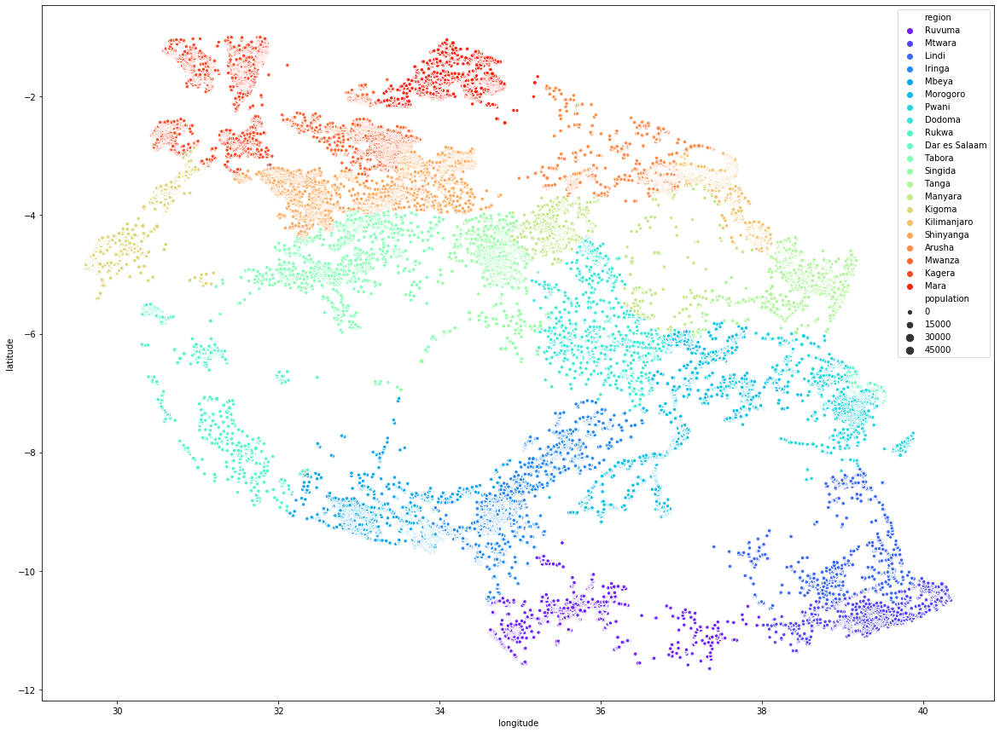

In [171]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='region', size='population', data=fixed_map, palette='rainbow')

This scatterplot only visualizes in another form the information expressed in our previous map, the distribution of wells based on the regions of Tanzania, however it is a quite beautiful scatterplot. Let's see how population interacts with region with another barplot.

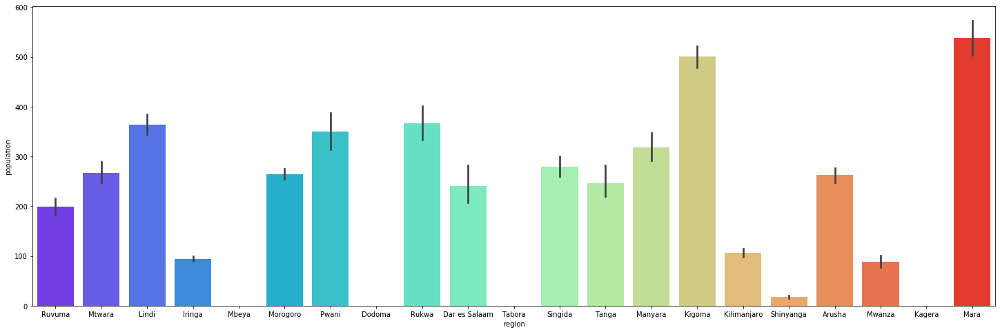

In [172]:
# Instantiate figure object
fig = plt.gcf()
# Set figure object size
fig.set_size_inches(25, 8)
# Create barplot
sns.barplot(x="region", y='population', data=fixed_map, palette='rainbow')

From our barplot, we can see that Mara, Kigoma, and Lindi have the highest average of population per well, while Mbeya, Tabora, and Kagera have a 0 average population. Let's see the distribution of status groups by region to compare the population averages to understand which areas have functional wells for their population.

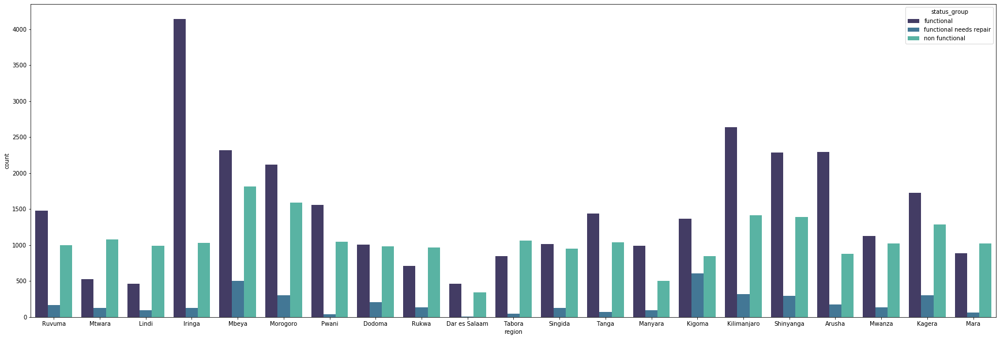

In [173]:
# Instantiate figure
fig = plt.gcf()
# Change figure size
fig.set_size_inches(30, 10)
# Create a countplot of region by status group
sns.countplot(x="region", hue="status_group", data=fixed_map, palette='mako')

We can see that Iringa has the most functional wells although it has one of the lowest averages of population per well. In contrast, Mara and Kigoma have some of the highest levels of population per well, but have relatively low amounts of waterpoints. This can further be made apparent with a countplot showing the counts of waterpoints per region.

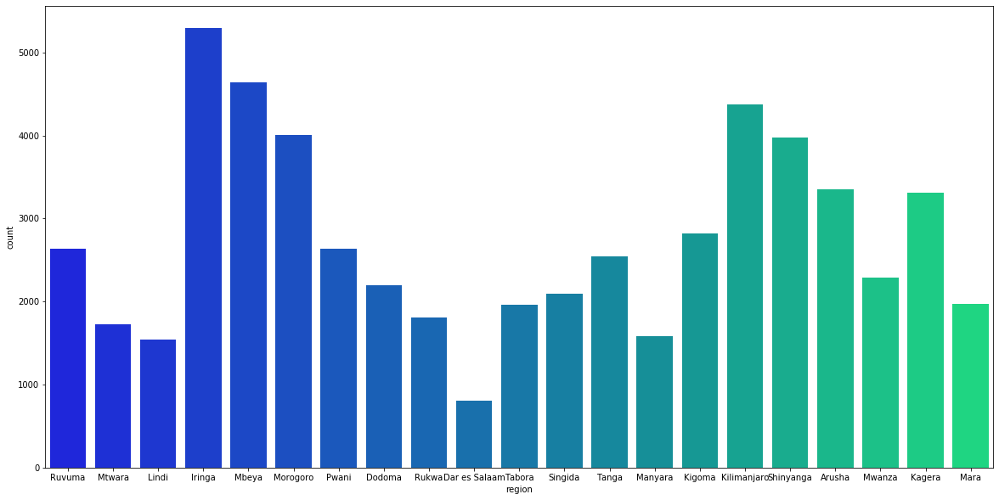

In [174]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create countplot of waterpoints by region
sns.countplot(x="region", data=fixed_map, palette='winter')

We can look further into the relationships between region, population, and status group with a barplot, this can show us the population levels of each target variable by region. 

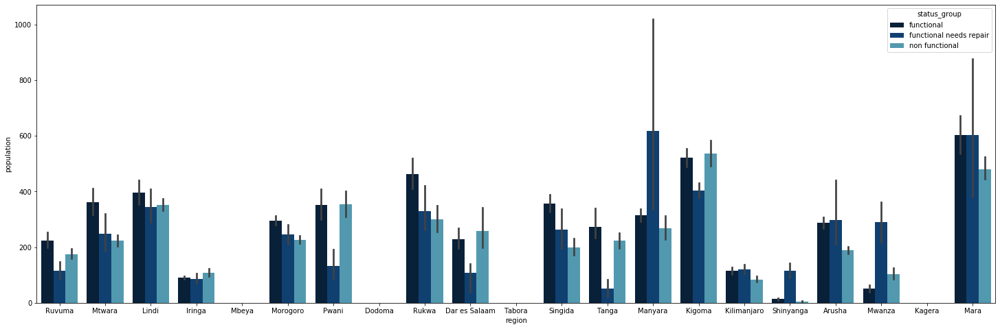

In [175]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(25, 8)
# Create barplot of region by population for status group
g = sns.barplot(x="region", y="population", hue="status_group", data=fixed_map, palette='ocean' )

Our barplot agrees with the other visualizations we created for region and population. In Mara and Manyara, more populations have wells in need of repair, and palces like Iringa have low populations that use each of their wells. Let's search for any patterns in the distribution of extraction type class and location with a scatterplot utilizing the coordinates of the waterpoint.

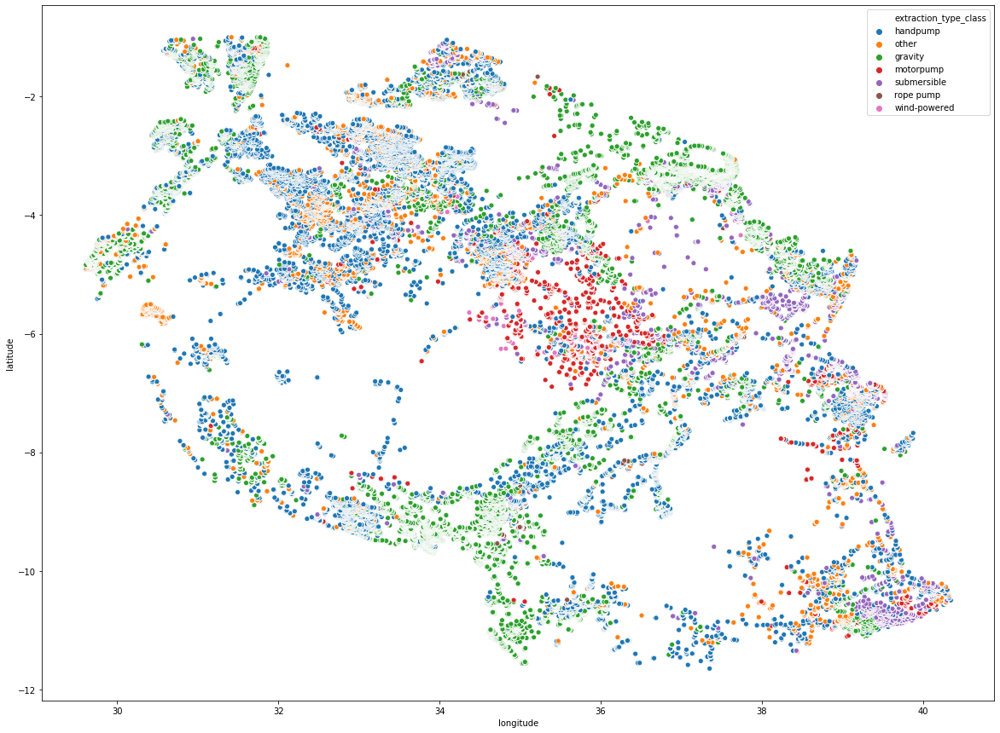

In [176]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='extraction_type_class', data=fixed_map)

We can see some clear separation in the scatterplot above. There is a high density of motorpump wells in central Tanzania in the Dodoma, Shinyaga, and Mwanza regions. There is also a high concentration of submersible wells along the southern Coast of Tanzania near the Indian Ocean. Handpump and Gravity wells can be seen across the entire country in great numbers. A count plot can further display this distribution.

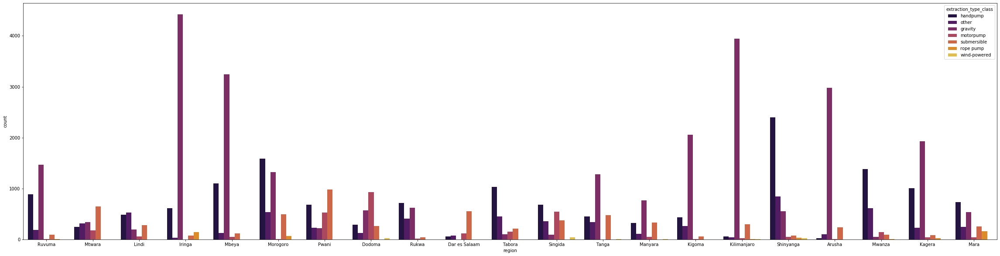

In [177]:
# Instantiate figure
fig = plt.gcf()
# Set figure size
fig.set_size_inches(40, 10)
# Create countplot of region by extraction_type_class
sns.countplot(x="region", hue="extraction_type_class", data=fixed_map, palette='inferno')

The `basin` feature may also contain valuable insights into the functionality of a well. Let's explore this dimension by using the `.value_counts()` function, with normalization set to True in order to return the percentage values of each basin.

In [178]:
# View percentages of basin value counts
fixed_map['basin'].value_counts(normalize=True)

Pangani                    0.155249
Lake Victoria              0.148164
Rufiji                     0.138508
Internal                   0.135191
Lake Tanganyika            0.109977
Wami / Ruvu                0.103968
Lake Nyasa                 0.088304
Ruvuma / Southern Coast    0.078024
Lake Rukwa                 0.042615
Name: basin, dtype: float64

In [179]:
# View distributions of basin with target
fixed_map.groupby(['status_group', 'basin']).size().unstack(fill_value=0)

basin,Internal,Lake Nyasa,Lake Rukwa,Lake Tanganyika,Lake Victoria,Pangani,Rufiji,Ruvuma / Southern Coast,Wami / Ruvu
status_group,,,,,,,,,
functional,4482,3324,1000,3046,4289,5372,5068,1670,3136
functional needs repair,557,250,270,738,607,477,437,326,269
non functional,2746,1511,1184,2549,3636,3091,2471,2497,2582


We can see that Pangani and Lake Victoria contain the most waterpoints, while Ruvuma/ Southern Coast and Lake Rukwa have the lowest counts of wells. We can further visualize this information with a countplot.

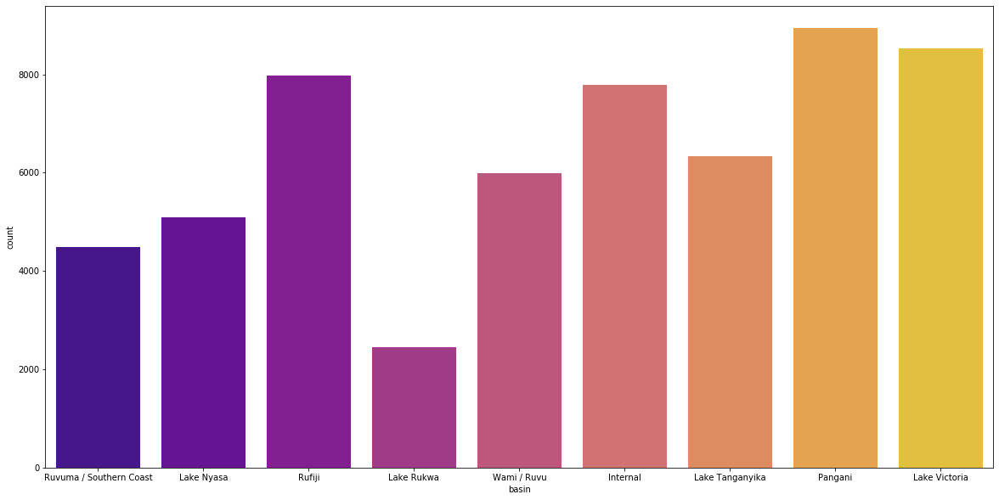

In [180]:
# Instantiate a figure object
fig = plt.gcf()
# Set the figure size
fig.set_size_inches(20, 10)
# Create a countplot of basin waterpoint counts
sns.countplot(x="basin", data=fixed_map, palette='plasma')

Let's explore the relationship between the basin and the functionality of a well with another countplot, this timw with a hue set to status_group.

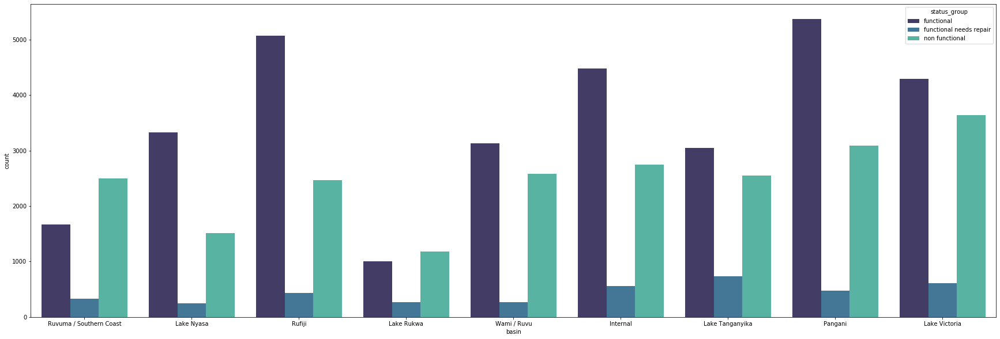

In [181]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create countplot based on basin and status_group
sns.countplot(x="basin", hue="status_group", data=fixed_map, palette='mako')

Interestingly, the basins with the most waterpoints also contain the highest ratios of functioning waterpoints, where the basins with the fewest wells have more non-functioning wells that functioning wells. This is a valuable pattern that our model will be able to utilize when making predictions. Let's finally explore the `gps_height` to find any further relationships for functionality.

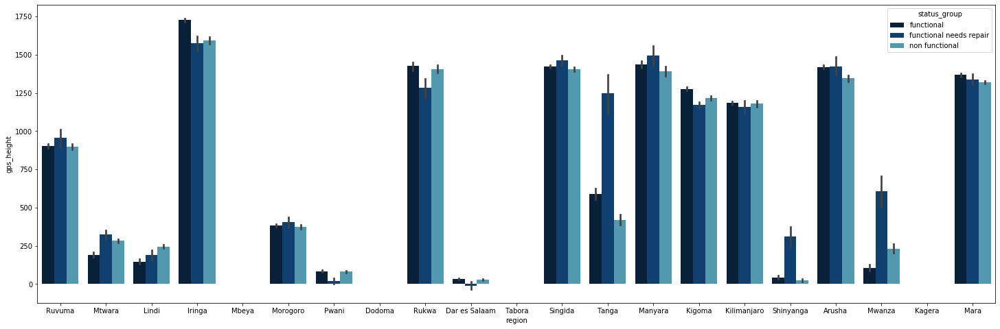

In [182]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(25, 8)
# Create barplot of region by gps_height for status_group
g = sns.barplot(x="region", y="gps_height", hue="status_group", data=fixed_map, palette='ocean' )

There are some regions where elevation appears to have a relationship with the functionality of a waterpoint, those seeming to be Iringa, Tanga, Dar es Salaam, Shingaya, and Mwanza. For these areas, a higher elevation means a higher likelihood of a waterpoint needing repair. After viewing the population and region categories, we can engineer a feature which represents the population per well for a region called 'pop_well'. To create this feature, we can first make a deep copy of our dataframe, and use a `.groupby()` and `.transform()` chain to take the sum of populations for the wells of a region and use that value as input for our new `pop_well` column.

In [183]:
# Create a copy of fixed_map
pop_df = fixed_map.copy(deep=True)
# Check dataframe
pop_df.head(3)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0


In [184]:
# Create new feature of populations per well for region
pop_df['pop_well'] = pop_df['population'].groupby(pop_df['region']).transform('sum')
# Check dataframe
pop_df.head(3)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target,pop_well
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0,525411
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411


In [185]:
# View value_counts of new feature
pop_df['pop_well'].value_counts(normalize=True)

0          0.210385
499247     0.091934
463070     0.076044
1060090    0.069567
70251      0.069063
878501     0.058175
1408681    0.048902
525411     0.045845
920896     0.045758
628482     0.044230
202610     0.039802
584203     0.036346
1060886    0.034193
661359     0.031397
462674     0.030043
503043     0.027490
563370     0.026847
193879     0.013979
Name: pop_well, dtype: float64

Now that we have our new feature let's explore it with the same process as used in our previous explorations.

In [186]:
# View distributions of pop_well with target
pop_df.groupby(['status_group', 'pop_well']).size().unstack(fill_value=0)

pop_well,0,70251,193879,202610,462674,463070,499247,503043,525411,563370,584203,628482,661359,878501,920896,1060090,1060886,1408681
status_group,,,,,,,,,,,,,,,,,,
functional,5903,2289,461,1130,524,2640,4141,987,1480,460,1011,1436,707,2294,1556,2119,886,1363
functional needs repair,1062,295,3,137,126,322,123,96,164,93,128,73,135,175,36,300,60,603
non functional,5150,1393,341,1025,1080,1417,1030,500,996,993,954,1038,966,881,1043,1587,1023,850


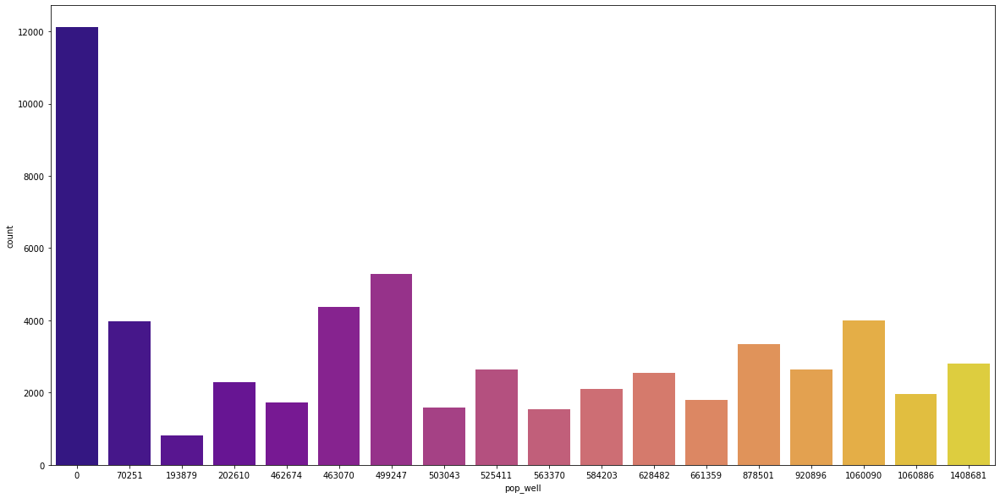

In [187]:
# Instantiate a figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create a countplot of pop_well
sns.countplot(x="pop_well", data=pop_df, palette='plasma')

Most of the wells have 0 population by region. This could be associated with the change of location of a community due to a variety of factors. Let's see if there is a relationship between `pop_well` and functionality with a countplot.

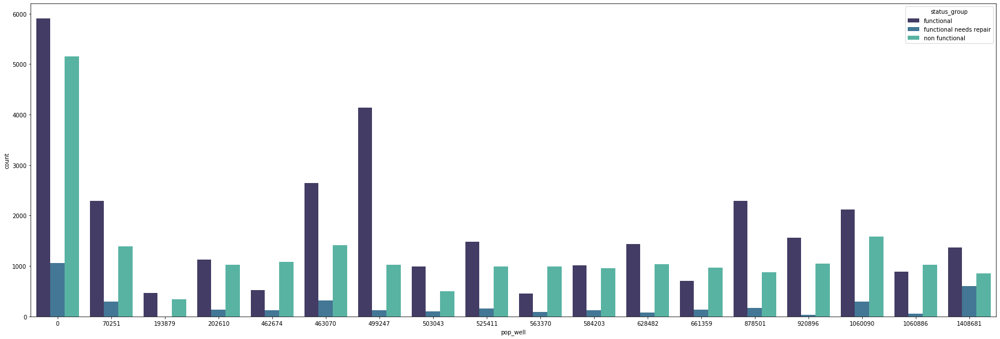

In [188]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create a countplot of pop_well and status_group
sns.countplot(x="pop_well", hue="status_group", data=pop_df, palette='mako')

Our countplot shows us that for certain levels of population, such as 499247, 878501, and 463070 there is a high ratio of functioning wells to non-functioning wells. For population levels 462674, 563370, 661359, and 1,060,886 there is more likely to be a non-functioning well than a functioning well. Let's view the distribution of the pop_well category by coordinate values with a scatterplot.

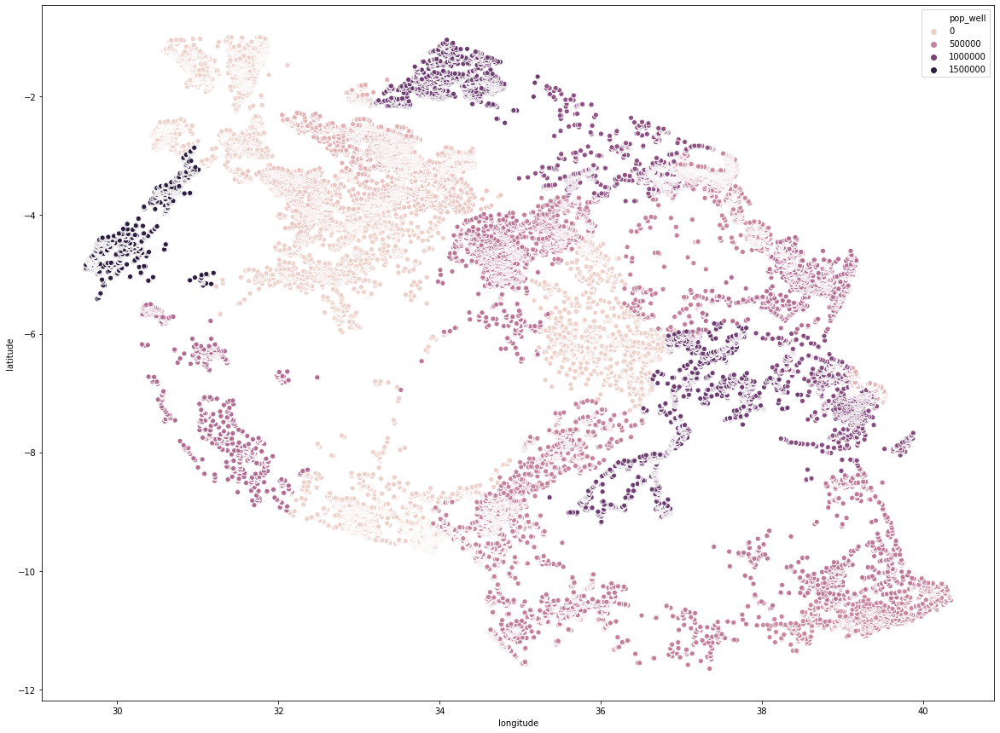

In [189]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='pop_well', data=pop_df)

We can see that many of the highest population by region waterpoints are located near the largest lakes of Tanzania, while many of the lowest population values are further away from any large body of water. Let's summarize the findings we have made from our geographical exploration.

### Geographical Observations

From our explorations into the various geographical dimensions of our dataset, we have been able to find certain patterns that may be indicators for predicting the functioning status of a waterpoint. We can see from our visualizations that:

 - **Region**
     - Ininga & Kilmanjaro have some of the highest percentages of functional waterpoints and the highest counts of wells, but contain some of the lowest average populations. This could indicate that a factor for keeping wells functioning is having a high ratio of waterpoints to population.
     - Mara. Lindi, Rukwa, and Mtwara have some of the highest average populations near waterpoints, but have more non-functioning wells than functioning wells.
     - Kigoma has the highest ratio of wells that are functional but in need of repair.
 
 - **Basin**
     - Lake Victoria, Pangani, Rufiji, have the most waterpoints by basin.
     - Rufiji has the best percentage of functional waterpoints.
     - Ruvuma/ Southern Coast have the worst ratio of functional to non-functional wells.

 - **Elevation**
     - Tanga, Shinyanga, Mwanza have the highest elevations for functional but in need of repair waterpoints
     - There is no elevation difference between functional and non-functional wells for most regions.
 - **Population by Region**
     - Certain levels of population, such as 499247, 878501, and 463070 there is a high ratio of functioning wells to non-functioning wells. For population levels 462674, 563370, 661359, and 1,060,886 there is more likely to be a non-functioning well than a functioning well.
     

## Years & Seasonality Exploration

After exploring the geography distributions, we can take a look at how time effects the functionality of a waterpoint. There are several columns in our datasets related to year and seasonality. There are columns describing the year, day of week, season, and month that the report was made for the waterpoint, as well as the year that the well was constructed. Let's explore these features to further find relationships in our data. We can begin by taking a look at the `year_recoreded` column.

In [190]:
# Check new dataframe 
pop_df.head(2)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target,pop_well
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0,525411


The first column we can analyze in our temporal exploration is the `year_recorded` column. This column can yield valuable insights for our model, as it describes what year a report was made. Let's begin exploration utilizing the `.value_counts()` function.

In [191]:
# Check distribution of values in column
pop_df['year_recorded'].value_counts(normalize=True, dropna=False)

2011    0.488061
2013    0.407762
2012    0.103638
2004    0.000521
2002    0.000017
Name: year_recorded, dtype: float64

In [192]:
# View distributions of year_recorded with target
pop_df.groupby(['status_group', 'year_recorded']).size().unstack()

year_recorded,2002,2004,2011,2012,2013
status_group,,,,,
functional,1.0,10.0,15899.0,2940.0,12537.0
functional needs repair,NaN,1.0,1775.0,292.0,1863.0
non functional,NaN,19.0,10431.0,2736.0,9081.0


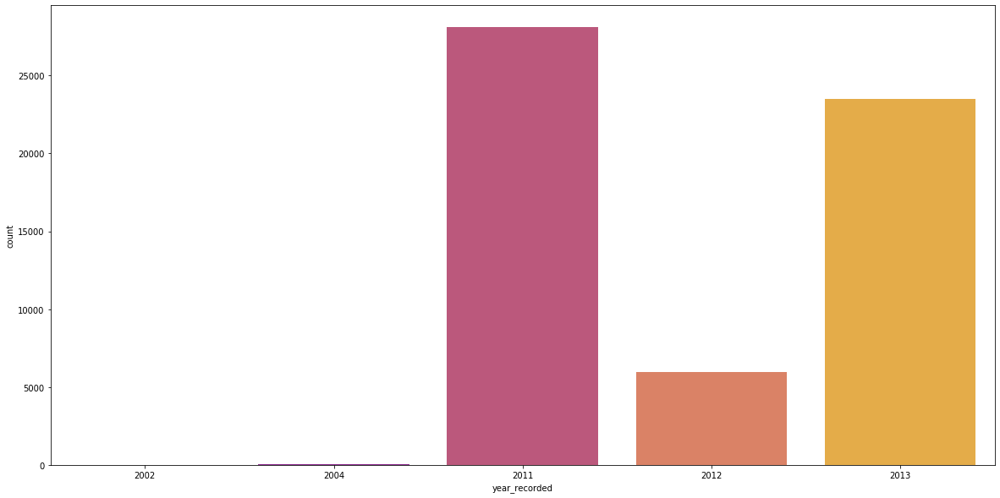

In [193]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create countplot with year_recorded values
sns.countplot(x="year_recorded", data=pop_df, palette='plasma')

We can see a strong bias in the year a report was made toward 2011 and 2013, having 48% and 40% of the reports made respectively. 

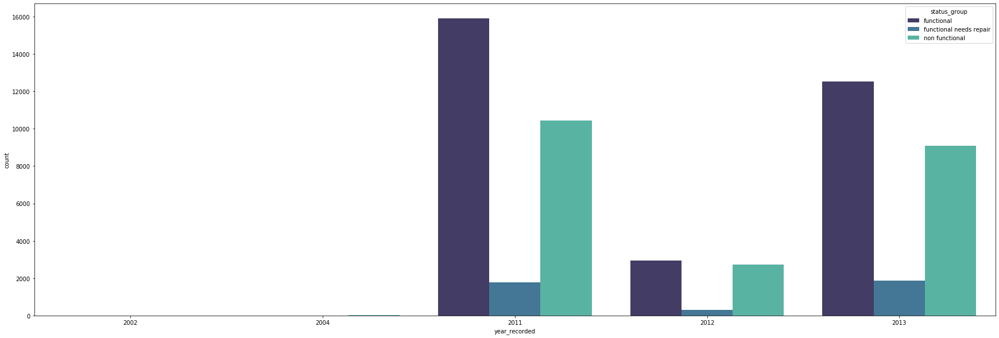

In [194]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create countplot for year_recorded by status_group
sns.countplot(x="year_recorded", hue="status_group", data=pop_df, palette='mako')

There does not appear to be a relationship between the `year_recorded` column and the functionality of a well. Let's explore the spatial relationships between the year a report was made with a scatterplot.

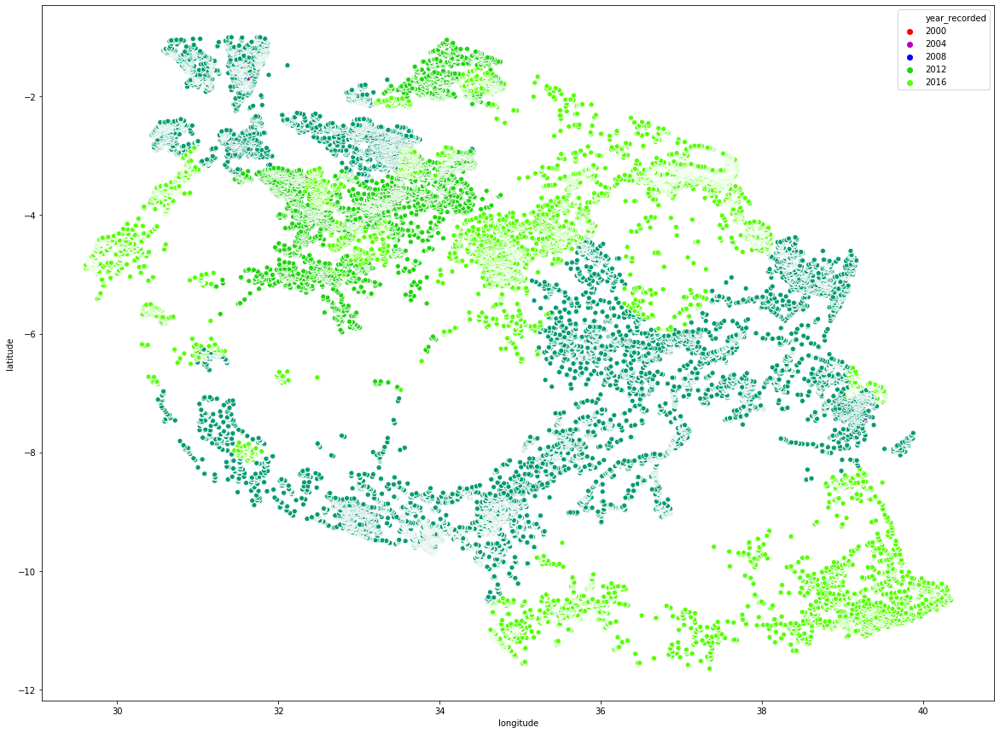

In [195]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='year_recorded', data=pop_df, palette='prism')

There appears to be strong separation between the year a report was made and the region it was made in. Let's take a look at the `construction_year` column to understand the relationship between the year that a well was made and its functionality.

In [196]:
# Check distribution of values in column
pop_df['construction_year'].value_counts(normalize=True, dropna=False)

2000    0.051454
2010    0.046279
2008    0.045793
2009    0.044230
1995    0.042945
1997    0.040809
1996    0.038170
1998    0.038100
1994    0.038065
1999    0.036016
1992    0.031050
1993    0.030755
1990    0.029087
2007    0.028289
2003    0.027281
2006    0.026743
2002    0.025527
1985    0.024451
2004    0.023062
2011    0.021950
2005    0.019606
1989    0.019519
1978    0.018998
2012    0.018911
2001    0.018876
1984    0.018842
1991    0.018321
1988    0.017782
1980    0.017748
1983    0.015768
1982    0.015160
1986    0.014674
1987    0.013927
1972    0.012295
1974    0.011861
1975    0.007658
1976    0.007571
1981    0.007415
1970    0.007137
1979    0.005140
1977    0.004324
1973    0.003213
2013    0.003161
1971    0.002518
1960    0.001771
1967    0.001528
1963    0.001476
1968    0.001337
1969    0.001025
1964    0.000695
1962    0.000521
1961    0.000365
1965    0.000330
1966    0.000295
2014    0.000069
2016    0.000052
2017    0.000035
2015    0.000017
Name: construc

In [197]:
# View distributions of construction_year with target
pop_df.groupby(['status_group', 'construction_year']).size().unstack()

construction_year,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
status_group,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
functional,24.0,2.0,7.0,31.0,7.0,11.0,6.0,31.0,22.0,15.0,99.0,82.0,178.0,55.0,234.0,144.0,86.0,62.0,426.0,46.0,267.0,118.0,266.0,242.0,426.0,417.0,365.0,332.0,423.0,441.0,775.0,416.0,872.0,744.0,1194.0,1521.0,1226.0,1390.0,1342.0,1444.0,1887.0,727.0,949.0,1023.0,852.0,660.0,929.0,1113.0,1856.0,1787.0,2035.0,948.0,729.0,102.0,1.0,NaN,NaN,NaN
functional needs repair,6.0,3.0,1.0,6.0,1.0,1.0,NaN,17.0,4.0,3.0,15.0,6.0,68.0,8.0,39.0,41.0,52.0,10.0,103.0,13.0,64.0,21.0,57.0,39.0,78.0,114.0,70.0,119.0,59.0,93.0,127.0,56.0,114.0,131.0,192.0,184.0,132.0,193.0,163.0,118.0,213.0,70.0,87.0,95.0,89.0,100.0,142.0,119.0,128.0,138.0,96.0,79.0,51.0,3.0,NaN,NaN,NaN,NaN
non functional,72.0,16.0,22.0,48.0,32.0,7.0,11.0,40.0,51.0,41.0,297.0,57.0,462.0,122.0,410.0,256.0,298.0,177.0,565.0,237.0,691.0,288.0,550.0,627.0,581.0,877.0,410.0,351.0,542.0,590.0,773.0,583.0,802.0,896.0,806.0,768.0,840.0,767.0,689.0,512.0,863.0,290.0,434.0,453.0,387.0,369.0,469.0,397.0,653.0,622.0,534.0,237.0,309.0,77.0,3.0,1.0,3.0,2.0


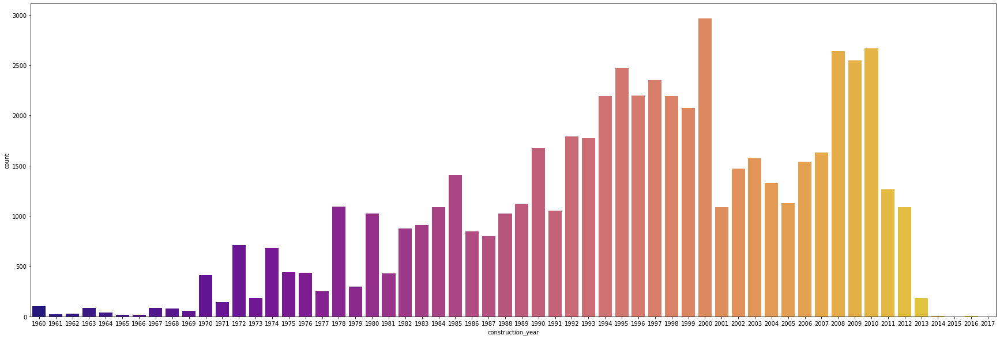

In [198]:
# Instantiate figure object
fig = plt.gcf()
# Set size of figure
fig.set_size_inches(30, 10)
# Create countplot for construction_year values
sns.countplot(x="construction_year", data=pop_df, palette='plasma')

We can see that more wells were created per year after 1990 than before 1990. The year with the highest production of waterpoints was 2000, after which there seems to be a decline in the creation of new wells. Let's view several relationships in regard to `construction_year` with a FacetGrid creating scatterplots for each target value by `construction_year` and `population`.

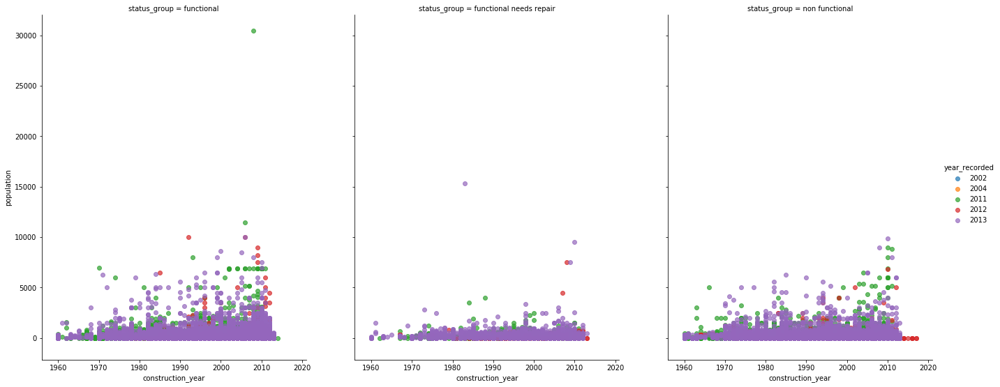

In [199]:
# Create Facetgrid for status_group featuring year_recorded
g = sns.FacetGrid(pop_df, col="status_group", hue="year_recorded")
# Input scatterplot of construction_year and population in facet grid
g.map(plt.scatter, 'construction_year', 'population', alpha=.7)
# Change size of facet grid
g.fig.set_figwidth(20)
g.fig.set_figheight(10)
# Create a legend for the facet grid
g.add_legend()

One point of note is that there is indication that populations have increased as the years of construction increased. Those reports created in 2013 appear to be associated with the highest population levels after 1990. Let's explore relationships with `construction_year` further by the relationships of `water_quality` and `construction_year` with `amount_tsh` for `status_group`.

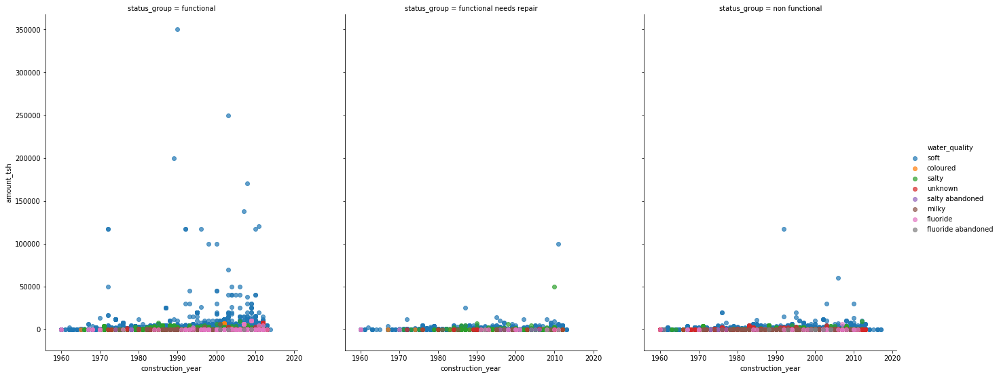

In [200]:
# Create Facetgrid for status_group featuring water_quality
g = sns.FacetGrid(pop_df, col="status_group", hue="water_quality")
# Input scatterplot of construction_year and amount_tsh
g.map(plt.scatter, 'construction_year', 'amount_tsh', alpha=.7)
# Change size of facet grid
g.fig.set_figwidth(20)
g.fig.set_figheight(10)
# Create a legend for the facet grid
g.add_legend()

We see a similar relationship found in the water source exploration that soft water_quality has some of the highest levels of amount_tsh. Also we can see that these larger access soft wells have been created more often after 1990, and most of these are functioning wells. Let's view the relationship of `status_group` as it relates to `year_recorded` and `construction_year` with a scatterplot.

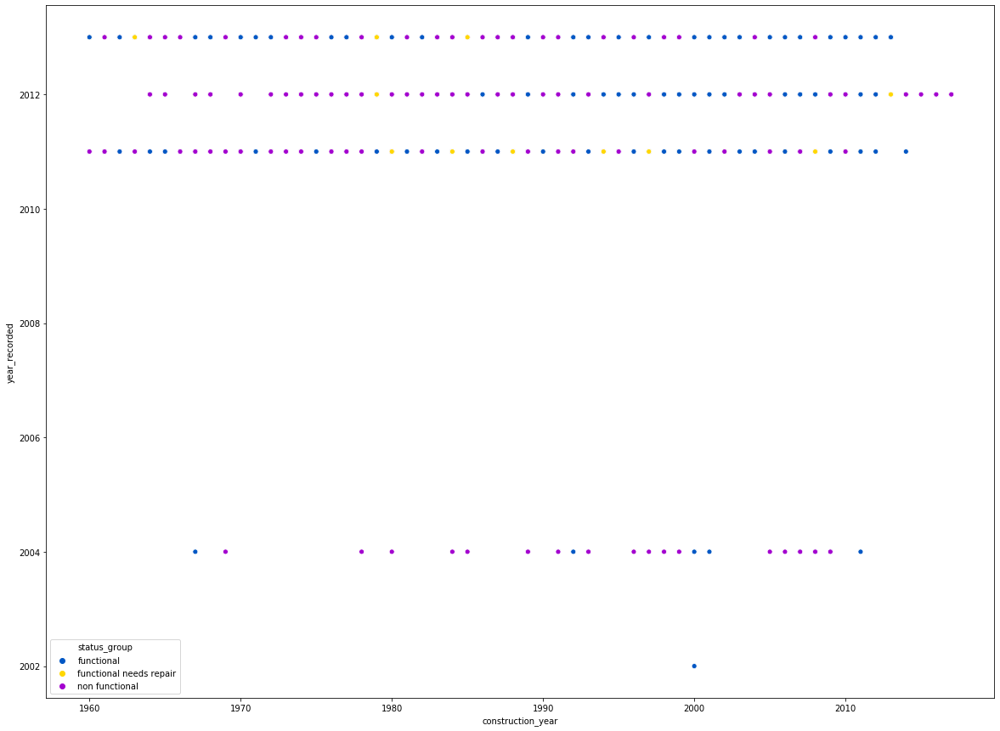

In [201]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='construction_year', y='year_recorded', hue='status_group', data=pop_df, palette='prism')

As demonstrated in order visualizations, we can see that more wells constructed after 1990 are functioning than the wells created before 1990. Let's take a look at the distributions of the `month_recorded` column. 

In [202]:
# View percentages of month_recorded values.
pop_df['month_recorded'].value_counts(normalize=True)

3     0.311401
2     0.208509
7     0.115690
1     0.103551
10    0.089155
4     0.068942
8     0.053156
11    0.021811
12    0.010246
6     0.006009
5     0.005835
9     0.005696
Name: month_recorded, dtype: float64

In [203]:
# View distributions of month_recorded with target
pop_df.groupby(['status_group', 'month_recorded']).size().unstack()

month_recorded,1,2,3,4,5,6,7,8,9,10,11,12
status_group,,,,,,,,,,,,
functional,2455,6639,11055,2050,202,270,3295,1578,214,2622,651,356
functional needs repair,659,803,900,438,10,9,524,241,10,260,58,19
non functional,2849,4565,5977,1482,124,67,2843,1242,104,2252,547,215


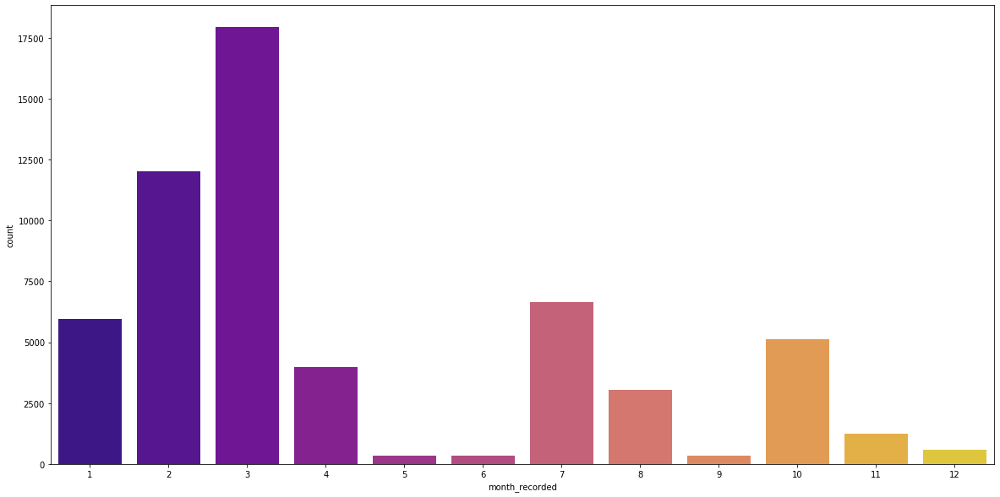

In [204]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create countplot for month_recorded
sns.countplot(x="month_recorded", data=pop_df, palette='plasma')

From our countplot we can see that most reports are created during March and February with the least amounts of reports being made in May, June, and September. We can view the distributions of the functionality pertaining to the month that a report was made with a countplot hue set to `status_group`.

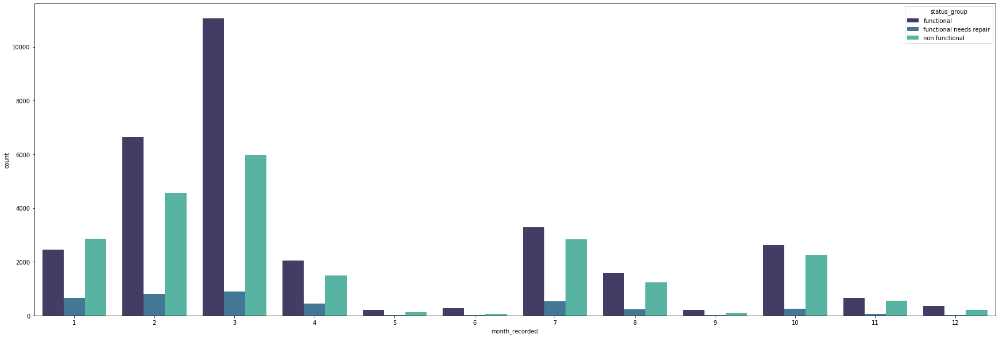

In [205]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create countplot for month_recorded by status_group
sns.countplot(x="month_recorded", hue="status_group", data=pop_df, palette='mako')

Reasonably so, most months have higher reports of functioning wells than non-functioning wells, except for January. Let's view the spatial distribution of the month_recorded values with a scatterplot.

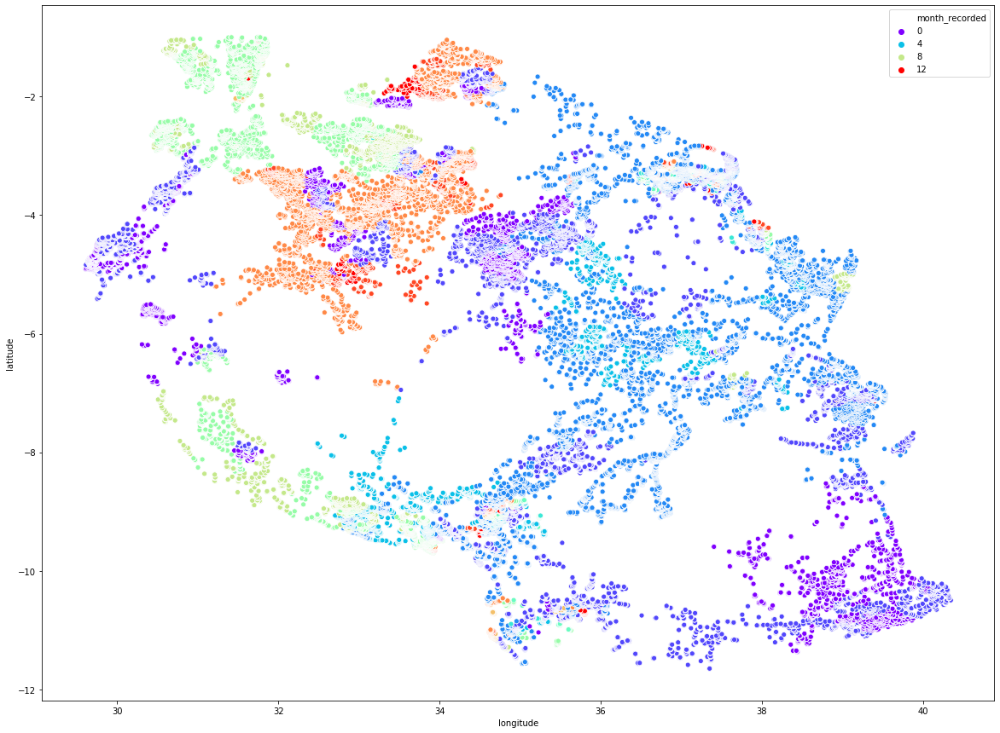

In [206]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='month_recorded', data=pop_df, palette='rainbow')

It is quite interesting to see geographical separation for report months. This could indicate a certain pattern within the processing of the data, as there could be little reason why Nothern parts of Tanzania would make reports within a different month than The southern parts. Perhaps many reports are made by data collectors on the ground, collecting data in different locations throughout the year. We can further explore the year and seasonality dimensions with the distributions of the `seas_recorded` column.

In [207]:
# Check distribution of values in column
pop_df['seas_recorded'].value_counts(normalize=True, dropna=False)

long_rain     0.386177
short_dry     0.312060
long_dry      0.269706
short_rain    0.032057
Name: seas_recorded, dtype: float64

In [208]:
# View distributions of seas_recorded with target
pop_df.groupby(['status_group', 'seas_recorded']).size().unstack()

seas_recorded,long_dry,long_rain,short_dry,short_rain
status_group,,,,
functional,7979,13307,9094,1007
functional needs repair,1044,1348,1462,77
non functional,6508,7583,7414,762


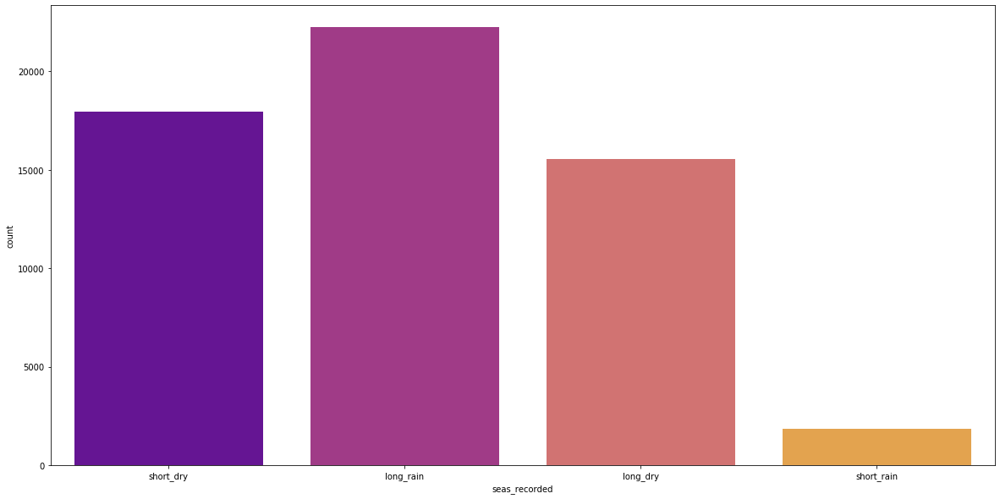

In [209]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create countplot for seas_recorded
sns.countplot(x="seas_recorded", data=pop_df, palette='plasma')

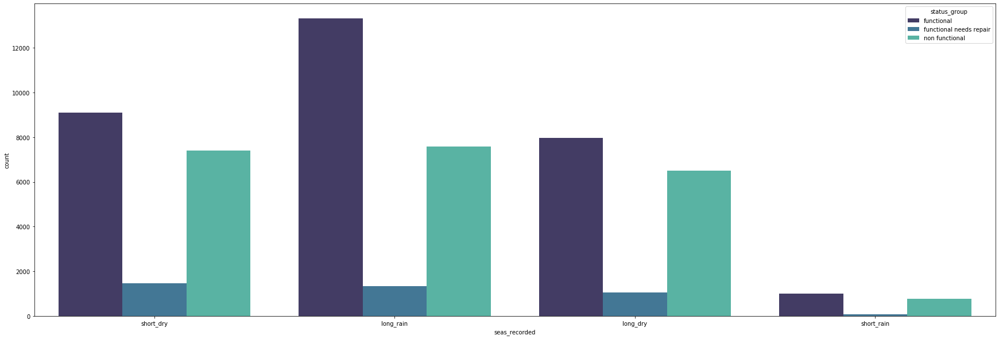

In [210]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create countplot for seas_recorded by status_group
sns.countplot(x="seas_recorded", hue="status_group", data=pop_df, palette='mako')

Our plots show us that the season with most reports is the long rain season. The long_dry season has the lowest ratio of functioning to non-functioning waterpoints. We can also view the spatial relationships between the season that a report was made with another scatterplot.

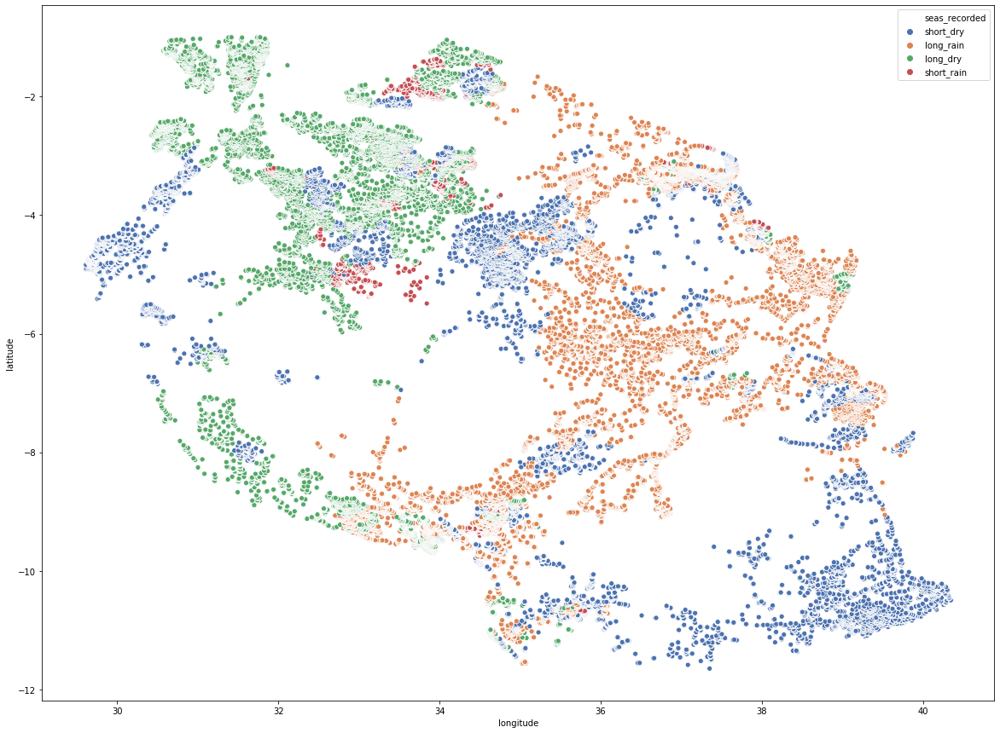

In [211]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='seas_recorded', data=pop_df, palette='deep')

Again we can see separation among the time a report was made and the well's region. This is a very curious observation which could surely be explained by the Taarifa team. Lastly let's explore the `day_recorded` column to understand its distributions.

In [212]:
# Check distribution of values in column
pop_df['day_recorded'].value_counts(normalize=True, dropna=False)

3    0.157107
4    0.149588
5    0.148476
2    0.142329
6    0.139950
1    0.138526
0    0.124025
Name: day_recorded, dtype: float64

In [213]:
# View distributions of seas_recorded with target
pop_df.groupby(['status_group', 'day_recorded']).size().unstack()

day_recorded,0,1,2,3,4,5,6
status_group,,,,,,,
functional,3726,4297,4576,4989,4727,4578,4494
functional needs repair,548,530,512,640,645,548,508
non functional,2868,3150,3108,3418,3242,3424,3057


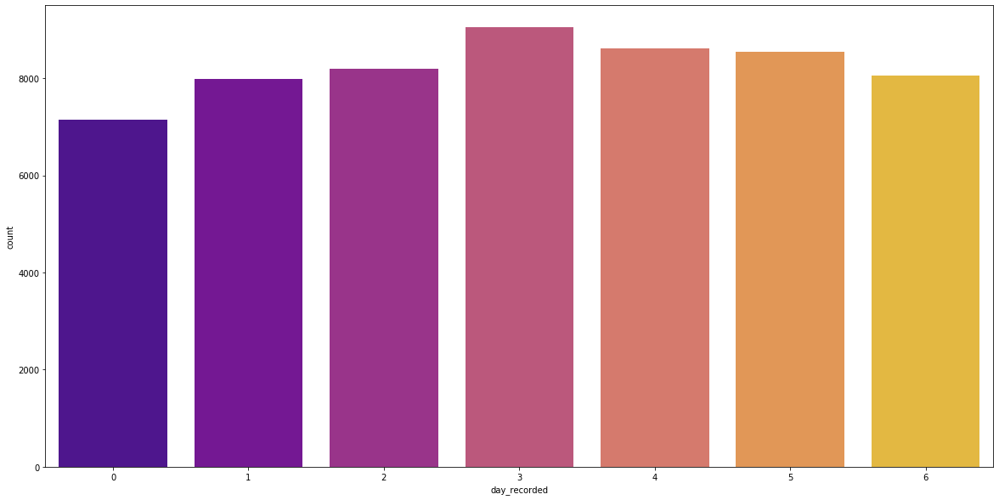

In [214]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create countplot of day_recorded
sns.countplot(x="day_recorded", data=pop_df, palette='plasma')

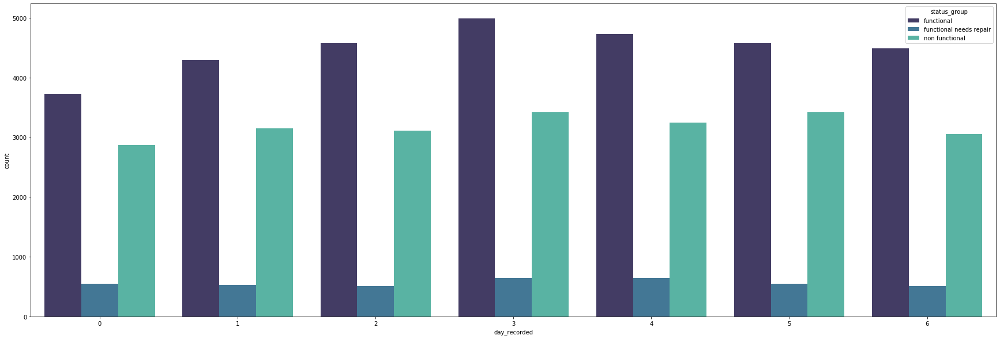

In [215]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(30, 10)
# Create countplot of day_recorded with status_group
sns.countplot(x="day_recorded", hue="status_group", data=pop_df, palette='mako')

We can see that there is no real separation among the days that a report was made and the functionality of a well. However, we can see that Wednesday has the highest count of reports being made, while Sunday has the lowest amount of reports made. We can confirm if there is a spatial relationship with a scatterplot.

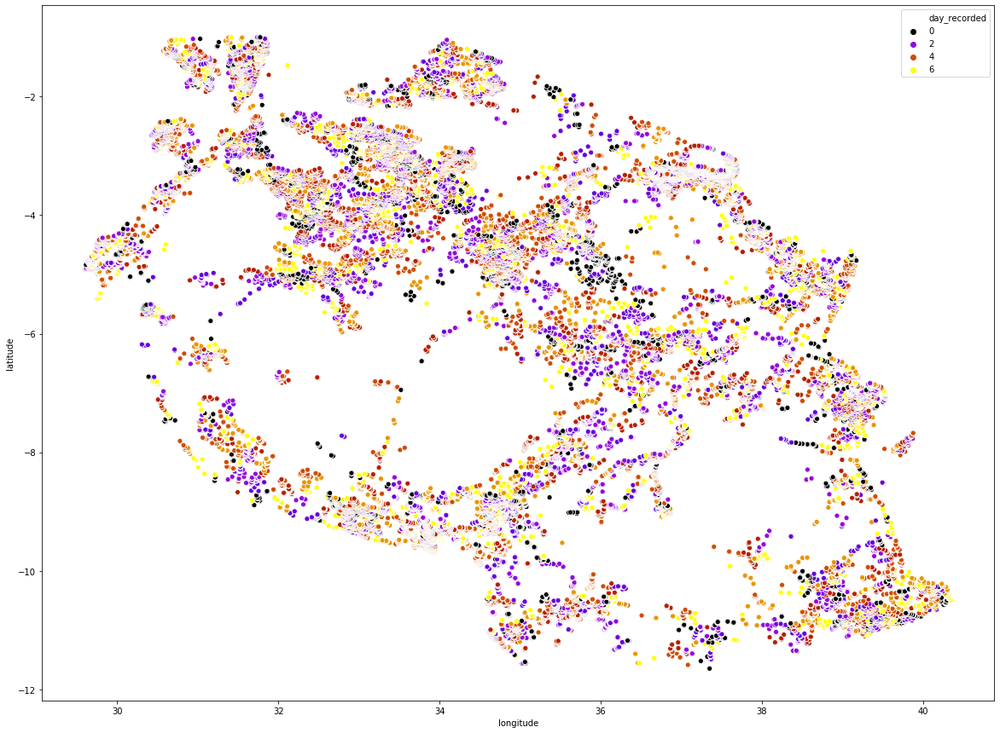

In [216]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='day_recorded', data=pop_df, palette='gnuplot')

There appears to be no such relationship between the day a report was made and where it was made. It could be quite useful for our model to have access to a column that represents the age of a waterpoint at the time of reporting. To create such a column, we can simply subtract the `construction_year` column from the `year_recorded` column, and assign these values to a new column in the dataframe called `age`. 

In [217]:
# Create a copy of pop_df
age_df = pop_df.copy(deep=True)
# Check dataframe
age_df.head(3)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target,pop_well
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0,525411
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411


In [218]:
# Create age column by subtracting construction_year from year_recorded
age_df['age'] = age_df['year_recorded'] - age_df['construction_year'] 

In [219]:
# Check new column
age_df.head(3)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target,pop_well,age
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411,13
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0,525411,12
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411,13


In [220]:
# Check distribution of values in column
age_df['age'].value_counts(normalize=True, dropna=False)

 13    0.052184
 14    0.048172
 3     0.048033
 15    0.042164
 1     0.040323
 16    0.040184
 17    0.037788
 2     0.037197
 11    0.036520
 5     0.035079
 18    0.034592
 19    0.033655
 4     0.033359
 7     0.027629
 12    0.026951
 6     0.025371
 23    0.024833
 20    0.024763
 8     0.024624
 10    0.023530
 21    0.023374
 33    0.020491
 28    0.019866
 9     0.019623
 27    0.019137
 22    0.019120
 26    0.017835
 25    0.017140
 31    0.016289
 24    0.015004
 29    0.012052
 35    0.011548
 37    0.010749
 39    0.010454
 0     0.010315
 30    0.010107
 41    0.008474
 43    0.006182
 38    0.006113
 36    0.005904
 32    0.005053
 34    0.004168
 40    0.004046
 53    0.001580
 42    0.001563
 50    0.001459
 45    0.001146
 46    0.000834
 44    0.000816
 48    0.000712
 51    0.000538
 49    0.000434
 47    0.000243
 52    0.000191
-1     0.000156
-5     0.000087
-4     0.000087
-3     0.000069
-2     0.000069
-7     0.000017
Name: age, dtype: float64

In [221]:
# View distributions of seas_recorded with target
age_df.groupby(['status_group', 'age']).size().unstack()

age,-7,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53
status_group,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
functional,1.0,2.0,1.0,2.0,NaN,2.0,416.0,1766.0,1611.0,1969.0,1280.0,1377.0,907.0,969.0,885.0,730.0,858.0,1373.0,1027.0,1858.0,1814.0,1464.0,1394.0,1187.0,975.0,991.0,551.0,656.0,436.0,627.0,338.0,443.0,396.0,422.0,270.0,203.0,179.0,282.0,48.0,432.0,35.0,167.0,133.0,178.0,93.0,184.0,107.0,104.0,25.0,79.0,23.0,27.0,9.0,2.0,12.0,10.0,29.0,4.0,1.0,23.0
functional needs repair,NaN,NaN,NaN,NaN,NaN,2.0,11.0,71.0,89.0,110.0,143.0,114.0,143.0,147.0,102.0,85.0,96.0,140.0,102.0,231.0,165.0,157.0,207.0,181.0,152.0,124.0,79.0,98.0,93.0,79.0,106.0,83.0,84.0,75.0,78.0,45.0,32.0,53.0,6.0,122.0,11.0,40.0,16.0,66.0,34.0,38.0,13.0,49.0,4.0,17.0,4.0,9.0,7.0,NaN,1.0,2.0,6.0,NaN,3.0,6.0
non functional,NaN,3.0,4.0,2.0,4.0,5.0,167.0,485.0,442.0,687.0,498.0,529.0,411.0,475.0,431.0,315.0,401.0,590.0,423.0,916.0,795.0,807.0,713.0,808.0,865.0,823.0,796.0,592.0,572.0,724.0,420.0,461.0,547.0,605.0,796.0,446.0,371.0,603.0,237.0,626.0,194.0,458.0,191.0,375.0,225.0,380.0,113.0,335.0,61.0,260.0,20.0,30.0,32.0,12.0,28.0,13.0,49.0,27.0,7.0,62.0


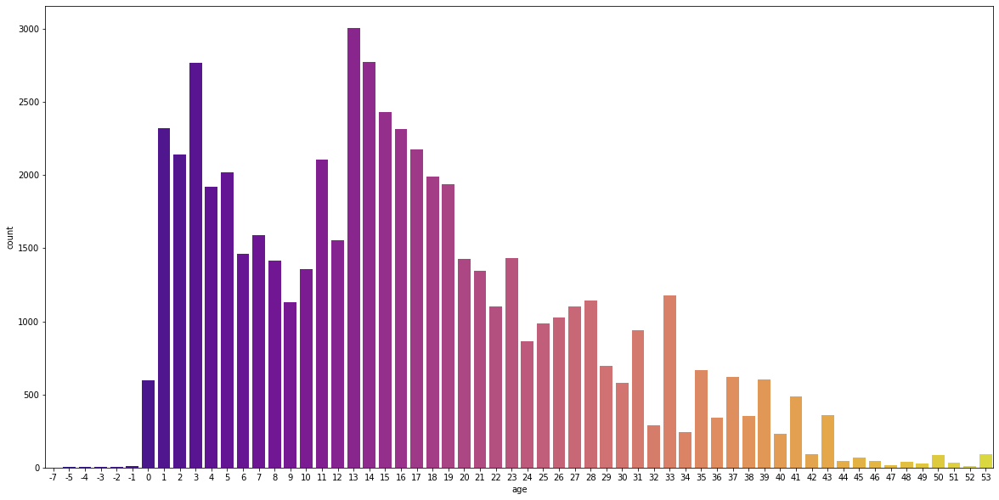

In [222]:
# Instantiate figure object
fig = plt.gcf()
# Set figure size
fig.set_size_inches(20, 10)
# Create countplot of age
sns.countplot(x="age", data=age_df, palette='plasma')

We can see that most wells are younger than 20 years old, with the most common age being 13 years. Let's view the relationship between the age of a well and it's functionality.

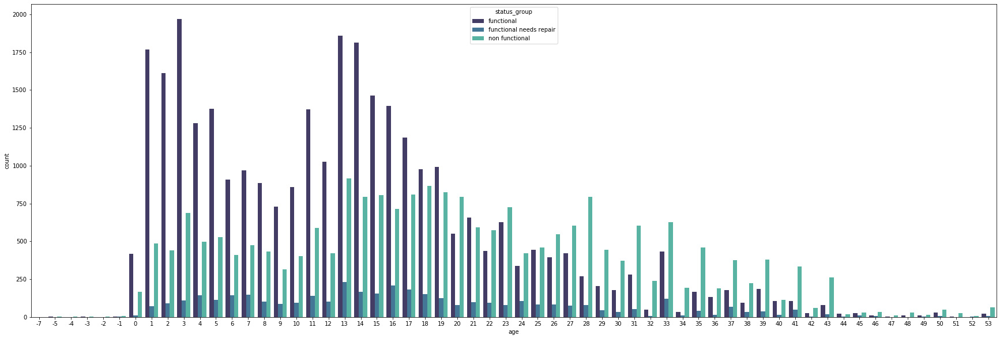

In [223]:
# Instantiate a figure object
fig = plt.gcf()
# Set size of figure
fig.set_size_inches(30, 10)
# Create countplot of age and status_group
sns.countplot(x="age", hue="status_group", data=age_df, palette='mako')

There is a clear change in the ratios functionality depending on the age of a waterpoint, the newer the well, the more likely it is to be functioning. Let's view the spatial relationship between well age.

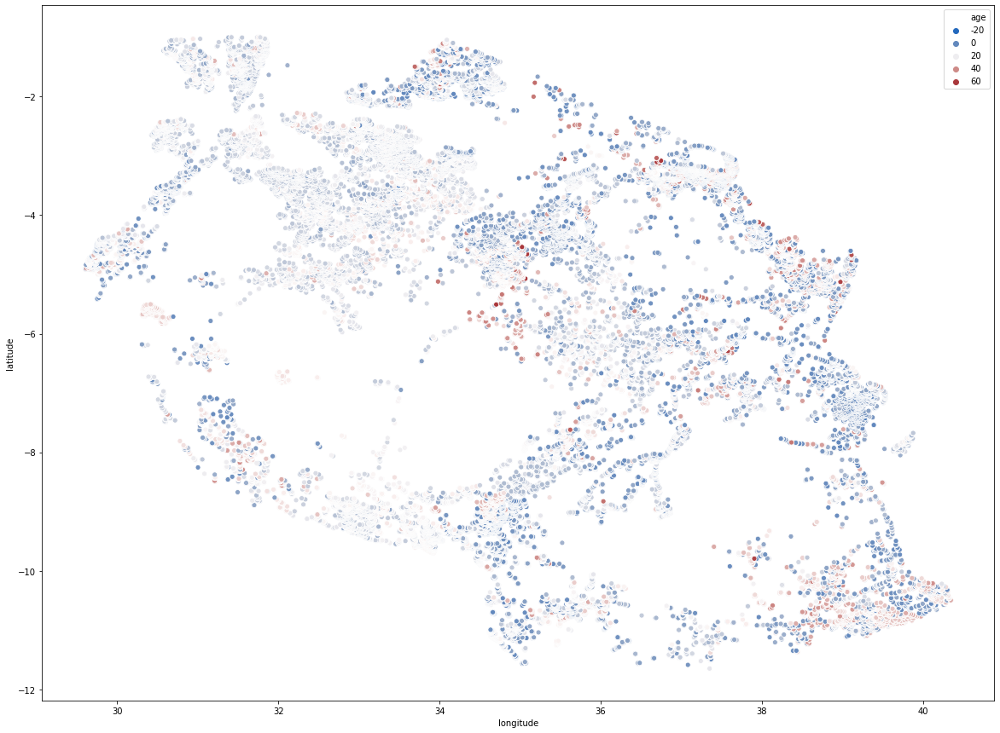

In [224]:
# View new scatterplot
fig, ax = plt.subplots(figsize=(20,15))
# Plot the scatterplot
sns.scatterplot(x='longitude', y='latitude', hue='age', data=age_df, palette='vlag')

There appears to be clustering of wells by age as they get older within the center of Tanzania, bolstering the possibility that there were many more communities living there in the past than at present. We can state our observations from our Years & Seasonality explorations in the following section.

### Years & Seasonality Observations

From our explorations into the various temporal dimensions of our dataset, we have been able to find certain patterns that may be indicators for predicting the functioning status of a waterpoint. We can see from our visualizations that:

 - **Report Year**
     - Most reports are made in 2011 with 48% and 2013 with 40% of the reports.
     - The best ratio of functional reports is 2011, with the worst being 2012.
 - **Construction Year**
     - Most functional reports were made on wells constructed after 1990 indicating that age could be a factor of functionality.
     - More wells were created after 1990, with the most being constructed in 2000.
 - **Month Recorded**
     - Most reporting is done in March with 31% and February with 20% of total reports. 
     - January, July, October, and November have the worst ratios for functioning wells.
     - There appears to be a regional relationship with the month that a report is generated, this could have a correlation on whether a well is functioning.
     
 - **Season Recorded**
     - Most reports are made in the long rain season with 38% of reports.
     - The least amount of reports are made in the short rain season with 3% of total reports.
     - The long rain has the highest ratio of functionality of the seasons.
     - The short rain season has the lowest ratio of functionality.
     - There is a regional relationship with the season that a report was made. 
         - Most long dry reports are made in the North West.
         - Most long rain reports are made in the East.
         - Most short rain reports are made in the Mid West.
         
 - **Day Recorded** 
     - The day with highest percentage of reports is Wednesday at 15%.
     - The day with the lowest percentage of reports is Sunday with 12%.
     - There appears to be no correlation between the day a report was made and the functionality of the well.
     - There is no apparent regional relationship between the day of the week a report was made.
     
 - **Age**
     - The most common age for a well is 13 years.
     - For age range between -7 and 19 years, the number of functional wells is higher than non-functional wells.
     - For age range between 20 and 53 years, the number of functional wells is lower than non-functional wells.

# Model
***

Now that we have completed our exploration phase including feature engineering, we can move on to the modeling phase. Here we will use the cleaned data to train various classification models and compare their accuracy to select the best performing model. At that point we will use parameter tuning to make the most accurate model we can from the dataset we have.

## Status Group Exploration

First for our modeling phase, we would like to test whether a ternary or binary classification is best in predicting if a well is functioning. We will explore the `status_group` feature by changing the functional needs repair group to functional, and training a classification model on that dataset. Then we will train a classification model on a dataset where the functional needs repair group has been assigned to non functional. With this binary structure, we can compare accuracy scores and use the dataset with the best accuracy in regard to false positives. 

We will first model based on the ternary dataset using decision trees. To do this we will need to import several modules, from scikit learn both for modeling and for evaluation of the models.

In [225]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier 
from sklearn.metrics import accuracy_score, roc_curve, auc
from sklearn.tree import export_graphviz
from IPython.display import Image  
from pydotplus import graph_from_dot_data

Now we will prepare a new dataframe for modeling a Decision Tree model by deep copying the `age_df` dataframe.

In [226]:
# Create a copy of age_df
class3_df = age_df.copy(deep=True)
class3_df.head(3)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target,pop_well,age
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411,13
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0,525411,12
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411,13


In [227]:
# View the unique values for each column within the new dataframe
for col in class3_df.columns:
    print('{} : {}'.format(col, class3_df[col].nunique()))

id : 57585
amount_tsh : 98
funder : 1857
gps_height : 2428
installer : 2024
longitude : 57512
latitude : 57513
wpt_name : 36719
num_private : 65
basin : 9
subvillage : 18566
region : 21
region_code : 27
district_code : 20
lga : 124
ward : 2033
population : 1049
public_meeting : 2
recorded_by : 1
scheme_management : 12
permit : 2
construction_year : 58
extraction_type : 18
extraction_type_group : 13
extraction_type_class : 7
management : 12
management_group : 5
payment : 7
payment_type : 7
water_quality : 8
quality_group : 6
quantity : 5
quantity_group : 5
source : 10
source_type : 7
source_class : 3
waterpoint_type : 7
waterpoint_type_group : 6
year_recorded : 5
month_recorded : 12
day_recorded : 7
seas_recorded : 4
status_group : 3
funder_counts : 163
funder_points : 17
target : 3
pop_well : 18
age : 60


Now we will drop the columns which have high multicollinearity with other features, and those features which when encoded will make the dataset extremely large.

In [228]:
# Make new dataframe
class3_df = class3_df.drop([ 'id', 'status_group', 'funder', 'installer', 'wpt_name', 'num_private',
                     'subvillage', 
                     'region_code',
                     'lga', 'ward', 'recorded_by', 
                     'payment_type', 'extraction_type_group',
                     'source_class', 'waterpoint_type_group',
                     'waterpoint_type_group'], axis=1)
# Check Dataframe
class3_df.head()

,amount_tsh,gps_height,longitude,latitude,basin,region,district_code,population,public_meeting,scheme_management,permit,construction_year,extraction_type,extraction_type_class,management,management_group,payment,water_quality,quality_group,quantity,quantity_group,source,source_type,waterpoint_type,year_recorded,month_recorded,day_recorded,seas_recorded,funder_counts,funder_points,target,pop_well,age
38198,500.0,556,36.658330,-11.476121,Ruvuma / Southern Coast,Ruvuma,5,600,1.0,WUG,0.0,2000,nira/tanira,handpump,wug,user-group,pay monthly,soft,good,insufficient,insufficient,shallow well,shallow well,hand pump,2013,2,6,short_dry,122,121-150,0,525411,13
51184,500.0,550,36.661272,-11.475701,Ruvuma / Southern Coast,Ruvuma,5,120,1.0,WUG,0.0,2001,nira/tanira,handpump,wug,user-group,pay monthly,soft,good,insufficient,insufficient,shallow well,shallow well,hand pump,2013,2,0,short_dry,122,121-150,0,525411,12
43385,1000.0,550,36.662697,-11.474086,Ruvuma / Southern Coast,Ruvuma,5,500,1.0,WUG,0.0,2000,swn 80,handpump,wug,user-group,pay monthly,soft,good,insufficient,insufficient,shallow well,shallow well,hand pump,2013,2,6,short_dry,122,121-150,0,525411,13
48814,1000.0,481,37.365518,-11.258956,Ruvuma / Southern Coast,Ruvuma,1,1,1.0,VWC,0.0,1995,swn 80,handpump,vwc,user-group,pay annually,soft,good,enough,enough,machine dbh,borehole,hand pump,2013,2,6,short_dry,3326,3001-10000,0,525411,18
13853,0.0,284,38.561841,-11.134596,Ruvuma / Southern Coast,Mtwara,63,89,1.0,VWC,1.0,1994,other,other,vwc,user-group,never pay,coloured,colored,seasonal,seasonal,shallow well,shallow well,other,2013,1,3,short_dry,51,51-60,2,462674,19


In [229]:
# Check dataframe dimensions
class3_df.shape

(57585, 33)

In [230]:
# Check instances and datatypes for each column
class3_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 57585 entries, 38198 to 51080
Data columns (total 33 columns):
amount_tsh               57585 non-null float64
gps_height               57585 non-null int64
longitude                57585 non-null float64
latitude                 57585 non-null float64
basin                    57585 non-null object
region                   57585 non-null object
district_code            57585 non-null int64
population               57585 non-null int64
public_meeting           57585 non-null float64
scheme_management        57585 non-null object
permit                   57585 non-null float64
construction_year        57585 non-null int64
extraction_type          57585 non-null object
extraction_type_class    57585 non-null object
management               57585 non-null object
management_group         57585 non-null object
payment                  57585 non-null object
water_quality            57585 non-null object
quality_group            57585 non-null 

Now we will select the categorical features which need to be encoded for our model to make predictions. We will use the `pd.get_dummies()` function to acheive this.

In [231]:
# Create a list of all the categorical features
cols_to_transform = ['basin', 'region', 'district_code', 'scheme_management',
                     'extraction_type', 'extraction_type_class',
                     'management', 'management_group', 'payment',
                     'water_quality', 'quality_group', 'quantity',
                     'quantity_group', 'source', 'source_type', 'waterpoint_type',
                     'year_recorded', 'month_recorded',
                     'day_recorded', 'seas_recorded', 'funder_points', 'pop_well']
# Create a dataframe with the new dummy columns created from the cols_to_transform list
class3_dummies = pd.get_dummies(
    data=class3_df, columns=cols_to_transform, drop_first=True)
# View dummy dataframe
class3_dummies.head()

,amount_tsh,gps_height,longitude,latitude,population,public_meeting,permit,construction_year,funder_counts,target,age,basin_Lake Nyasa,basin_Lake Rukwa,basin_Lake Tanganyika,basin_Lake Victoria,basin_Pangani,basin_Rufiji,basin_Ruvuma / Southern Coast,basin_Wami / Ruvu,region_Dar es Salaam,region_Dodoma,region_Iringa,region_Kagera,region_Kigoma,region_Kilimanjaro,region_Lindi,region_Manyara,region_Mara,region_Mbeya,region_Morogoro,region_Mtwara,region_Mwanza,region_Pwani,region_Rukwa,region_Ruvuma,region_Shinyanga,region_Singida,region_Tabora,region_Tanga,district_code_1,district_code_2,district_code_3,district_code_4,district_code_5,district_code_6,district_code_7,district_code_8,district_code_13,district_code_23,district_code_30,district_code_33,district_code_43,district_code_53,district_code_60,district_code_62,district_code_63,district_code_67,district_code_80,scheme_management_None,scheme_management_Other,scheme_management_Parastatal,scheme_management_Private operator,scheme_management_SWC,scheme_management_Trust,scheme_management_VWC,scheme_management_WUA,scheme_management_WUG,scheme_management_Water Board,scheme_management_Water authority,extraction_type_cemo,extraction_type_climax,extraction_type_gravity,extraction_type_india mark ii,extraction_type_india mark iii,extraction_type_ksb,extraction_type_mono,extraction_type_nira/tanira,extraction_type_other,extraction_type_other - mkulima/shinyanga,extraction_type_other - play pump,extraction_type_other - rope pump,extraction_type_other - swn 81,extraction_type_submersible,extraction_type_swn 80,extraction_type_walimi,extraction_type_windmill,extraction_type_class_handpump,extraction_type_class_motorpump,extraction_type_class_other,extraction_type_class_rope pump,extraction_type_class_submersible,extraction_type_class_wind-powered,management_other,management_other - school,management_parastatal,management_private operator,management_trust,management_unknown,management_vwc,management_water authority,management_water board,management_wua,management_wug,management_group_other,management_group_parastatal,management_group_unknown,management_group_user-group,payment_other,payment_pay annually,payment_pay monthly,payment_pay per bucket,payment_pay when scheme fails,payment_unknown,water_quality_fluoride,water_quality_fluoride abandoned,water_quality_milky,water_quality_salty,water_quality_salty abandoned,water_quality_soft,water_quality_unknown,quality_group_fluoride,quality_group_good,quality_group_milky,quality_group_salty,quality_group_unknown,quantity_enough,quantity_insufficient,quantity_seasonal,quantity_unknown,quantity_group_enough,quantity_group_insufficient,quantity_group_seasonal,quantity_group_unknown,source_hand dtw,source_lake,source_machine dbh,source_other,source_rainwater harvesting,source_river,source_shallow well,source_spring,source_unknown,source_type_dam,source_type_other,source_type_rainwater harvesting,source_type_river/lake,source_type_shallow well,source_type_spring,waterpoint_type_communal standpipe,waterpoint_type_communal standpipe multiple,waterpoint_type_dam,waterpoint_type_hand pump,waterpoint_type_improved spring,waterpoint_type_other,year_recorded_2004,year_recorded_2011,year_recorded_2012,year_recorded_2013,month_recorded_2,month_recorded_3,month_recorded_4,month_recorded_5,month_recorded_6,month_recorded_7,month_recorded_8,month_recorded_9,month_recorded_10,month_recorded_11,month_recorded_12,day_recorded_1,day_recorded_2,day_recorded_3,day_recorded_4,day_recorded_5,day_recorded_6,seas_recorded_long_rain,seas_recorded_short_dry,seas_recorded_short_rain,funder_points_11-20,funder_points_21-30,funder_points_31-40,funder_points_41-50,funder_points_51-60,funder_points_61-80,funder_points_81-100,funder_points_101-120,funder_points_121-150,funder_points_151-180,funder_points_181-350,funder_points_351-650,funder_points_651-1000,funder_points_1001-2000,funder_points_2001-3000,funder_points_3001-10000,pop_well_70251,pop_well_193879,pop_well_202610,pop_we

In [232]:
# View dimensions of new dataframe
class3_dummies.shape

(57585, 211)

In [233]:
# View distribution of target variable in dataframe
class3_dummies['target'].value_counts()

0    31387
2    22267
1     3931
Name: target, dtype: int64

In [234]:
# Create features and labels to use for training and testing
X = class3_dummies.drop(['target'], axis=1)
y = class3_dummies['target']

In [235]:
# Conduct test/train split on features and labels with test size = 20% of dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=10)

In [236]:
# Import Standard Scaler to scale data before training
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()
# Create new scaled X train and X test sets
X_train_ss = ss.fit_transform(X_train)
X_test_ss = ss.transform(X_test)

In [237]:
# Instantiate a Decision Tree Classifier
dtree = DecisionTreeClassifier(criterion='entropy', 
                               class_weight='balanced',
                               random_state=10)

In [238]:
# Fit classifier to X_train and y_train
dtree.fit(X_train_ss, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight='balanced',
                       criterion='entropy', max_depth=None, max_features=None,
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=10, splitter='best')

In [239]:
# Create predictions on X_test and create an object from predictions
y_preds = dtree.predict(X_test_ss)

Now that our decision tree has successfully used the datasets to train and make predictions, let's evaluate these predictions basesd on the precision and recall. Again in this specific case we are looking for our recall to be larger than precision.

In [240]:
# Import confusion matrix from sklearn
from sklearn.metrics import confusion_matrix

# Create label and prediction objects
labels = y_test
predictions = y_preds

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis = 1)
precision = np.diag(cm) / np.sum(cm, axis = 0)

# Print recall and precision values
print(recall)
print(precision)

[0.79427663 0.36474908 0.76712018]
[0.79872102 0.36699507 0.76022472]


Let's plot the confusion matrix for our Decision Tree with the plot_confusion_matrix module.

Confusion matrix, without normalization
[[4996  377  917]
 [ 369  298  150]
 [ 890  137 3383]]
Normalized confusion matrix
[[0.79427663 0.05993641 0.14578696]
 [0.45165239 0.36474908 0.18359853]
 [0.20181406 0.03106576 0.76712018]]


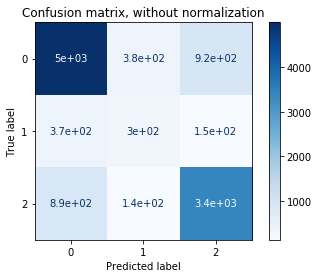

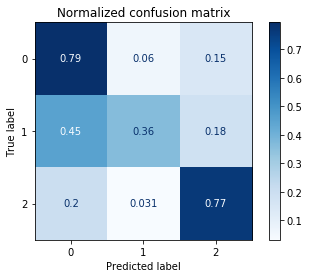

In [241]:
from sklearn.metrics import plot_confusion_matrix
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(dtree, X_test_ss, y_test,
                                 display_labels=[0, 1, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

Our confusion matrix shows that our model accurately predicts a functional well 79 times out of 100, and predicts a non-funtional well 77 times out of 100. These are modest results, but for functional in need of repair, the model is accurate 36 times out of 100. Our model predicted a non-functioning well as functioning 20 times out of 100, and predicts a functional well as non-functioning 15 times out of 100. Let's compare these scores with a dataset that includes the `funder` and `installer` columns.

In [242]:
# Create a copy of age_df
classfun_df = age_df.copy(deep=True)
classfun_df.head(3)

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,year_recorded,month_recorded,day_recorded,seas_recorded,status_group,funder_counts,funder_points,target,pop_well,age
38198,33391,500.0,snv,556,dwe,36.658330,-11.476121,Shuleni,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,600,1.0,GeoData Consultants Ltd,WUG,0.0,2000,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411,13
51184,21726,500.0,snv,550,dwe,36.661272,-11.475701,Kwa Hausi Dandu,0,Ruvuma / Southern Coast,Tabora,Ruvuma,10,5,Namtumbo,Magazini,120,1.0,GeoData Consultants Ltd,WUG,0.0,2001,nira/tanira,nira/tanira,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,0,short_dry,functional,122,121-150,0,525411,12
43385,28228,1000.0,snv,550,dwe,36.662697,-11.474086,Kwa Lidia Petro,0,Ruvuma / Southern Coast,Kisungule,Ruvuma,10,5,Namtumbo,Magazini,500,1.0,GeoData Consultants Ltd,WUG,0.0,2000,swn 80,swn 80,handpump,wug,user-group,pay monthly,monthly,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,2013,2,6,short_dry,functional,122,121-150,0,525411,13


In [243]:
# Make new dataframe
classfun_df = classfun_df.drop([ 'id', 'status_group', 'wpt_name', 'num_private',
                     'subvillage', 
                     'region_code',
                     'lga', 'ward', 'recorded_by', 
                     'payment_type', 'extraction_type_group',
                     'source_class', 'waterpoint_type_group',
                     'waterpoint_type_group'], axis=1)
# Check Dataframe
classfun_df.head()

,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,district_code,population,public_meeting,scheme_management,permit,construction_year,extraction_type,extraction_type_class,management,management_group,payment,water_quality,quality_group,quantity,quantity_group,source,source_type,waterpoint_type,year_recorded,month_recorded,day_recorded,seas_recorded,funder_counts,funder_points,target,pop_well,age
38198,500.0,snv,556,dwe,36.658330,-11.476121,Ruvuma / Southern Coast,Ruvuma,5,600,1.0,WUG,0.0,2000,nira/tanira,handpump,wug,user-group,pay monthly,soft,good,insufficient,insufficient,shallow well,shallow well,hand pump,2013,2,6,short_dry,122,121-150,0,525411,13
51184,500.0,snv,550,dwe,36.661272,-11.475701,Ruvuma / Southern Coast,Ruvuma,5,120,1.0,WUG,0.0,2001,nira/tanira,handpump,wug,user-group,pay monthly,soft,good,insufficient,insufficient,shallow well,shallow well,hand pump,2013,2,0,short_dry,122,121-150,0,525411,12
43385,1000.0,snv,550,dwe,36.662697,-11.474086,Ruvuma / Southern Coast,Ruvuma,5,500,1.0,WUG,0.0,2000,swn 80,handpump,wug,user-group,pay monthly,soft,good,insufficient,insufficient,shallow well,shallow well,hand pump,2013,2,6,short_dry,122,121-150,0,525411,13
48814,1000.0,danida,481,danida,37.365518,-11.258956,Ruvuma / Southern Coast,Ruvuma,1,1,1.0,VWC,0.0,1995,swn 80,handpump,vwc,user-group,pay annually,soft,good,enough,enough,machine dbh,borehole,hand pump,2013,2,6,short_dry,3326,3001-10000,0,525411,18
13853,0.0,china government,284,china,38.561841,-11.134596,Ruvuma / Southern Coast,Mtwara,63,89,1.0,VWC,1.0,1994,other,other,vwc,user-group,never pay,coloured,colored,seasonal,seasonal,shallow well,shallow well,other,2013,1,3,short_dry,51,51-60,2,462674,19


In [244]:
# Create a list of all the categorical features
cols_to_transform = ['funder', 'installer', 'basin', 'region', 'district_code', 'scheme_management',
                     'extraction_type', 'extraction_type_class',
                     'management', 'management_group', 'payment',
                     'water_quality', 'quality_group', 'quantity',
                     'quantity_group', 'source', 'source_type', 'waterpoint_type',
                     'year_recorded', 'month_recorded',
                     'day_recorded', 'seas_recorded', 'funder_points', 'pop_well']
# Create a dataframe with the new dummy columns created from the cols_to_transform list
classfun_dummies = pd.get_dummies(
    data=classfun_df, columns=cols_to_transform, drop_first=True)
# View dummy dataframe
classfun_dummies.shape

(57585, 4090)

In [245]:
# Create features and labels to use for training and testing
X = classfun_dummies.drop(['target'], axis=1)
y = classfun_dummies['target']

In [246]:
# Conduct test/train split on features and labels with test size = 20% of dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=10)

In [247]:
# Scale data before training
X_train_ss = ss.fit_transform(X_train)
X_test_ss = ss.transform(X_test)

In [248]:
# Instantiate a new decision tree model
dtree_fun = DecisionTreeClassifier(criterion='entropy', 
                            random_state=10)

In [249]:
# Fit the decision tree model
dtree_fun.fit(X_train_ss, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=10, splitter='best')

In [250]:
# Create predictions on X_test and create an object from predictions
y_preds_fun = dtree_fun.predict(X_test_ss)

In [251]:
# Create label and prediction objects
labels = y_test
predictions = y_preds_fun

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis = 1)
precision = np.diag(cm) / np.sum(cm, axis = 0)

# Print recall and precision values
print(recall)
print(precision)

[0.79475358 0.37209302 0.76643991]
[0.80253652 0.36363636 0.75920934]


Confusion matrix, without normalization
[[4999  390  901]
 [ 342  304  171]
 [ 888  142 3380]]
Normalized confusion matrix
[[0.79475358 0.06200318 0.14324324]
 [0.41860465 0.37209302 0.20930233]
 [0.20136054 0.03219955 0.76643991]]


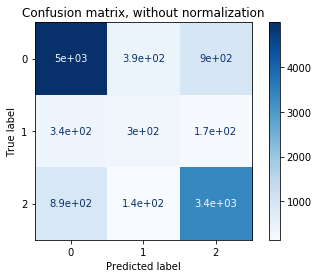

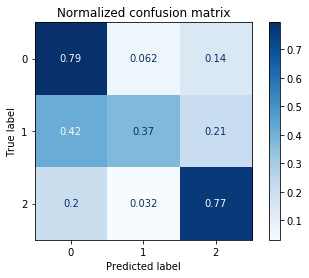

In [252]:
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(dtree_fun, X_test_ss, y_test,
                                 display_labels=[0, 1, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

There is not much difference in the predictive performance of our model with this larger dataset. Now with these scores, we can compare with new datasets where functioning but in need of repair labels are transformed to functioning or non-functioning. We can create a dataframe where the functional needs repair group is classified as non-functional, and compare model performance.

In [253]:
# Create new dataframe for experimenting with target distributions
class1_func = classfun_dummies.copy(deep=True)
# View original target distributions
class1_func['target'].value_counts()

0    31387
2    22267
1     3931
Name: target, dtype: int64

In [254]:
# Change functional needs repair to non-functional
class1_func['target'] = class1_func['target'].map({1: 2, 0: 0, 2:2})
# View new distributions
class1_func['target'].value_counts()

0    31387
2    26198
Name: target, dtype: int64

In [255]:
# Create features and labels to use for training and testing
X = class1_func.drop(['target'], axis=1)
y = class1_func['target']

In [256]:
# Conduct test/train split on features and labels with test size = 20% of dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=10)

In [257]:
# Scale data before training
X_train_ss = ss.fit_transform(X_train)
X_test_ss = ss.transform(X_test)

In [258]:
# Instantiate a new decision tree model
dtree_func2 = DecisionTreeClassifier(criterion='entropy', 
                            random_state=10)

In [259]:
# Fit the decision tree model
dtree_func2.fit(X_train_ss, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=10, splitter='best')

In [260]:
# Create predictions on X_test and create an object from predictions
y_preds_func2 = dtree_func2.predict(X_test_ss)

In [261]:
# Create label and prediction objects
labels = y_test
predictions = y_preds_func2

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis = 1)
precision = np.diag(cm) / np.sum(cm, axis = 0)

# Print recall and precision values
print(recall)
print(precision)

[0.78982512 0.76678783]
[0.80297398 0.75196998]


Confusion matrix, without normalization
[[4968 1322]
 [1219 4008]]
Normalized confusion matrix
[[0.78982512 0.21017488]
 [0.23321217 0.76678783]]


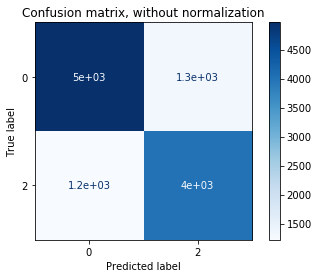

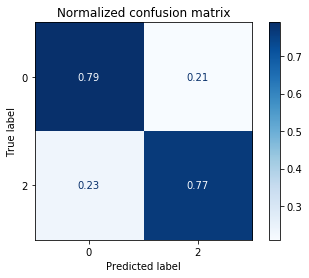

In [262]:
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(dtree_func2, X_test_ss, y_test,
                                 display_labels=[0, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

The results of the confusion matrix shows that our false positives have increased. Ultimately this is no the direction we want our predictins to move in. With regard to using a ternary classifier or binary classifier, it is in our interests for this project with these results to keep the ternary dataset. Let's now test a dataset that assignes the functioning in need of repair wells to non-functioning with the methods completed previously.

In [263]:
# Create new dataframe for experimenting with target distributions
class2_func = classfun_dummies.copy(deep=True)
# View original target distributions
class2_func['target'].value_counts()

0    31387
2    22267
1     3931
Name: target, dtype: int64

In [264]:
# Change functional needs repair to functional
class2_func['target'] = class2_func['target'].map({1: 0, 0: 0, 2:2})
# View new distributions
class2_func['target'].value_counts()

0    35318
2    22267
Name: target, dtype: int64

In [265]:
# Create features and labels to use for training and testing
X = class2_func.drop(['target'], axis=1)
y = class2_func['target']

In [266]:
# Conduct test/train split on features and labels with test size = 20% of dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=10)

In [267]:
# Scale data before training
X_train_ss = ss.fit_transform(X_train)
X_test_ss = ss.transform(X_test)

In [268]:
# Instantiate a new decision tree model
dtree_func1 = DecisionTreeClassifier(criterion='entropy', 
                            random_state=10)

In [269]:
# Fit the decision tree model
dtree_func1.fit(X_train_ss, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=10, splitter='best')

In [270]:
# Create predictions on X_test and create an object from predictions
y_preds_func1 = dtree_func1.predict(X_test_ss)

In [271]:
# Create label and prediction objects
labels = y_test
predictions = y_preds_func1

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis = 1)
precision = np.diag(cm) / np.sum(cm, axis = 0)

# Print recall and precision values
print(recall)
print(precision)

[0.84803715 0.761678  ]
[0.85151173 0.75670196]


Confusion matrix, without normalization
[[6027 1080]
 [1051 3359]]
Normalized confusion matrix
[[0.84803715 0.15196285]
 [0.238322   0.761678  ]]


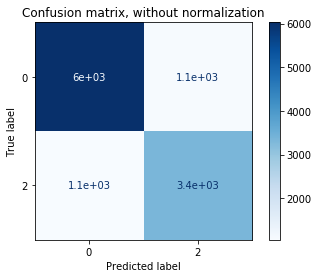

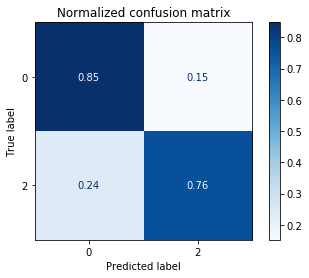

In [272]:
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(dtree_func1, X_test_ss, y_test,
                                 display_labels=[0, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

Labeling the functional need repair wells as functional increases the accuracy for functional wells by significant amount. However, our an important goal for our project is to lower the amount of non-functional wells predicted as functional, which this dataset actually increases with respect to our original model. With that in mind, we will continue to use a ternary classifier in our modeling phase. We can use graphviz to visualize our Decision Tree with max_features set to none to visualize the amount of computation that has occurred.

In [273]:
# Create PNG
# graph.write_png("first_dtree.png")

<img src= "img\first_dtree.png">

## Pipeline

Having tested variations of our dataset, we have decided to use a ternary classification dataframe. Now it is time to run pipeline to test several models in order to choose the best predictor. For our pipeline, we will test:

- Logistic Regression
- Decision Trees
- K Nearest Neighbors
- Linear Discriminant Analysis
- AdaBoost 
- Gradient Boosting
- Random Forest
- Extra Trees

The model which has the highest accuracy of these will be the model which we will choose to perform hyperparameter tuning, and finally make predictions on our original test set. To begin, we will need to import the model modules from Sci-Kit Learn. We will also import plotly to make visualizations on the performance of our models.

In [274]:
import plotly.graph_objs as go
import plotly.offline as py
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier

In [275]:
# Create features and labels for train and test sets
X = class3_dummies.drop('target', axis=1)
y = class3_dummies['target']

In [276]:
# Conduct train/test split for the models in the pipeline
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    stratify=classfun_dummies['target'])

In order to adequately evaluate our models we will use Stratified K-Fold cross validation to run the models on several samples of the datasets, and obtain the average scores for the predictions. In this case we will set the number of folds to 10, and set our scoring parameter to accuracy. We will use Stratified K-Folds so that the ratio of label variables in the samples equal the ratio of labels in the original dataset.

In [277]:
# Create cv function
def BasedLine2(X_train, y_train,models):
    # Test options and evaluation metric
    num_folds = 10
    scoring = 'accuracy'

    results = []
    names = []
    # Iterate through models in pipeline and apply cross validation
    for name, model in models:
        kfold = StratifiedKFold(n_splits=num_folds)
        cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
        results.append(cv_results)
        names.append(name)
        msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
        print(msg)
        
    return names, results

We will also create a plotly object which will create the boxplots to present a visualization of the model's accuracy performances. 

In [278]:
# Create plotly object for visualization
class PlotBoxR(object):
    
    # Function to create the plotly boxplot figure
    def __Trace(self,nameOfFeature,value): 
    
        trace = go.Box(
            y=value,
            name = nameOfFeature,
            marker = dict(
                color = 'blueviolet',
            )
        )
        return trace
    
    # Function to impute the values from cv
    def PlotResult(self,names,results):
        
        data = []

        for i in range(len(names)):
            data.append(self.__Trace(names[i],results[i]))


        py.iplot(data)

We will now create a function which will create a dataframe composed of the accuracy scores of the models. It will take in the names of the models, and the results from the cross-validation and return a pandas dataframe of the various results.

In [279]:
def ScoreDataFrame(names,results):
    def floatingDecimals(f_val, dec=3):
        prc = "{:."+str(dec)+"f}" 
    
        return float(prc.format(f_val))

    scores = []
    for r in results:
        scores.append(floatingDecimals(r.mean(),4))

    scoreDataFrame = pd.DataFrame({'Model':names, 'Score': scores})
    return scoreDataFrame

Now we will create a function which creates a pipeline that includes all of the models we want to evaluate. We will use a minmax scaler to perform the necessary scaling of our data before being fed into the models. The function will then return the completed pipeline.

In [280]:
# Create function for adding models to pipeline
def GetScaledModel(nameOfScaler):
    
    # Set scaling to minmax
    nameOfScaler = 'minmax'
    scaler = MinMaxScaler()
    
    # Create empty pipelines list
    pipelines = []
    # Append model pipelines to list
    pipelines.append(('Logistic Regression'  , Pipeline([('Scaler', scaler),('LR'  , LogisticRegression(max_iter=5000))])))
    pipelines.append(('Linear Discriminant Analysis' , Pipeline([('Scaler', scaler),('LDA' , LinearDiscriminantAnalysis())])))
    pipelines.append(('K-Nearest Neighbors' , Pipeline([('Scaler', scaler),('KNN' , KNeighborsClassifier())])))
    pipelines.append(('Decision Trees', Pipeline([('Scaler', scaler),('CART', DecisionTreeClassifier())])))
    pipelines.append(('Ada Boost'  , Pipeline([('Scaler', scaler),('AB'  , AdaBoostClassifier())])  ))
    pipelines.append(('Gradient Boosting' , Pipeline([('Scaler', scaler),('GMB' , GradientBoostingClassifier())])  ))
    pipelines.append(('Random Forest'  , Pipeline([('Scaler', scaler),('RF'  , RandomForestClassifier())])  ))
    pipelines.append(('Extra Trees'  , Pipeline([('Scaler', scaler),('ET'  , ExtraTreesClassifier())])  ))


    return pipelines  

Now we only need to put all of our functions together to run the pipeline and visualize the best model, while producing a dataframe with the appropriate accuracy values.

In [281]:
# Create pipeline object
models = GetScaledModel('minmax')
# Run cv on pipeline
names,results = BasedLine2(X_train, y_train,models)
# Plot the results
PlotBoxR().PlotResult(names,results)
# Save scatterplot
plt.savefig('model comparison')

# Create dataframe of results
scaledScoreMinMax = ScoreDataFrame(names,results)
# View results
scaledScoreMinMax

Logistic Regression: 0.745392 (0.005396)
Linear Discriminant Analysis: 0.739812 (0.004577)
K-Nearest Neighbors: 0.769913 (0.005069)
Decision Trees: 0.751575 (0.004557)
Ada Boost: 0.721427 (0.004887)
Gradient Boosting: 0.752408 (0.004226)
Random Forest: 0.800546 (0.002013)
Extra Trees: 0.790034 (0.004698)


,Model,Score
0,Logistic Regression,0.7454
1,Linear Discriminant Analysis,0.7398
2,K-Nearest Neighbors,0.7699
3,Decision Trees,0.7516
4,Ada Boost,0.7214
5,Gradient Boosting,0.7524
6,Random Forest,0.8005
7,Extra Trees,0.7900


<Figure size 432x288 with 0 Axes>

In [ ]:
# <img src= 'img\models.PNG'>

In [ ]:
# <img src= 'img\scores1.PNG'>

In [293]:
# Create cv function
def BasedLine3(X_train, y_train,models):
    # Test options and evaluation metric
    num_folds = 10

    results = []
    names = []
    # Iterate through models in pipeline and apply cross validation
    for name, model in models:
        kfold = StratifiedKFold(n_splits=num_folds)
        cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='precision_weighted')
        results.append(cv_results)
        names.append(name)
        msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
        print(msg)
        
    return names, results

In [294]:
# Create plotly object for visualization
class PlotBoxR3(object):
    
    # Function to create the plotly boxplot figure
    def __Trace(self,nameOfFeature,value): 
    
        trace = go.Box(
            y=value,
            name = nameOfFeature,
            marker = dict(
                color = '#EF553B',
            )
        )
        return trace
    
    # Function to impute the values from cv
    def PlotResult(self,names,results):
        
        data = []

        for i in range(len(names)):
            data.append(self.__Trace(names[i],results[i]))


        py.iplot(data)

In [291]:
def ScoreDataFrame(names,results):
    def floatingDecimals(f_val, dec=3):
        prc = "{:."+str(dec)+"f}" 
    
        return float(prc.format(f_val))

    scores = []
    for r in results:
        scores.append(floatingDecimals(r.mean(),4))

    scoreDataFrameprec = pd.DataFrame({'Model':names, 'Precision': scores})
    return scoreDataFrameprec

In [292]:
# Create pipeline object
models = GetScaledModel('minmax')
# Run cv on pipeline
names,results = BasedLine3(X_train, y_train,models)
# Plot the results
PlotBoxR3().PlotResult(names,results)
# Save scatterplot
plt.savefig('precision comparison1')

# Create dataframe of results
scaledScoreMinMaxpre = ScoreDataFrame(names,results)
# View results
scaledScoreMinMaxpre

Logistic Regression: 0.731374 (0.007834)
Linear Discriminant Analysis: 0.733216 (0.005333)
K-Nearest Neighbors: 0.763187 (0.005824)
Decision Trees: 0.753275 (0.005838)
Ada Boost: 0.710121 (0.007720)
Gradient Boosting: 0.751313 (0.005314)
Random Forest: 0.793506 (0.003193)
Extra Trees: 0.784705 (0.004048)


,Model,Precision
0,Logistic Regression,0.7314
1,Linear Discriminant Analysis,0.7332
2,K-Nearest Neighbors,0.7632
3,Decision Trees,0.7533
4,Ada Boost,0.7101
5,Gradient Boosting,0.7513
6,Random Forest,0.7935
7,Extra Trees,0.7847


<Figure size 432x288 with 0 Axes>

In [295]:
# Create cv function
def BasedLine4(X_train, y_train,models):
    # Test options and evaluation metric
    num_folds = 10

    results = []
    names = []
    # Iterate through models in pipeline and apply cross validation
    for name, model in models:
        kfold = StratifiedKFold(n_splits=num_folds)
        cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='recall_weighted')
        results.append(cv_results)
        names.append(name)
        msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
        print(msg)
        
    return names, results

In [297]:
# Create plotly object for visualization
class PlotBoxR4(object):
    
    # Function to create the plotly boxplot figure
    def __Trace(self,nameOfFeature,value): 
    
        trace = go.Box(
            y=value,
            name = nameOfFeature,
            marker = dict(
                color = '#19D3F3',
            )
        )
        return trace
    
    # Function to impute the values from cv
    def PlotResult(self,names,results):
        
        data = []

        for i in range(len(names)):
            data.append(self.__Trace(names[i],results[i]))


        py.iplot(data)

In [298]:
def ScoreDataFrame(names,results):
    def floatingDecimals(f_val, dec=3):
        prc = "{:."+str(dec)+"f}" 
    
        return float(prc.format(f_val))

    scores = []
    for r in results:
        scores.append(floatingDecimals(r.mean(),4))

    scoreDataFrame = pd.DataFrame({'Model':names, 'Recall': scores})
    return scoreDataFrame

In [299]:
# Create pipeline object
models = GetScaledModel('minmax')
# Run cv on pipeline
names,results = BasedLine4(X_train, y_train,models)
# Plot the results
PlotBoxR4().PlotResult(names,results)
# Save scatterplot
plt.savefig('recall comparison1')

# Create dataframe of results
scaledScoreRec= ScoreDataFrame(names,results)
# View results
scaledScoreRec

Logistic Regression: 0.745392 (0.005396)
Linear Discriminant Analysis: 0.739812 (0.004577)
K-Nearest Neighbors: 0.769913 (0.005069)
Decision Trees: 0.751875 (0.005540)
Ada Boost: 0.721427 (0.004887)
Gradient Boosting: 0.752408 (0.004226)
Random Forest: 0.800454 (0.003507)
Extra Trees: 0.790405 (0.004477)


,Model,Recall
0,Logistic Regression,0.7454
1,Linear Discriminant Analysis,0.7398
2,K-Nearest Neighbors,0.7699
3,Decision Trees,0.7519
4,Ada Boost,0.7214
5,Gradient Boosting,0.7524
6,Random Forest,0.8005
7,Extra Trees,0.7904


<Figure size 432x288 with 0 Axes>

In [300]:
# Create cv function
def BasedLine5(X_train, y_train,models):
    # Test options and evaluation metric
    num_folds = 10

    results = []
    names = []
    # Iterate through models in pipeline and apply cross validation
    for name, model in models:
        kfold = StratifiedKFold(n_splits=num_folds)
        cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='f1_weighted')
        results.append(cv_results)
        names.append(name)
        msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
        print(msg)
        
    return names, results

In [301]:
# Create plotly object for visualization
class PlotBoxR5(object):
    
    # Function to create the plotly boxplot figure
    def __Trace(self,nameOfFeature,value): 
    
        trace = go.Box(
            y=value,
            name = nameOfFeature,
            marker = dict(
                color = '#00CC96',
            )
        )
        return trace
    
    # Function to impute the values from cv
    def PlotResult(self,names,results):
        
        data = []

        for i in range(len(names)):
            data.append(self.__Trace(names[i],results[i]))


        py.iplot(data)

In [302]:
def ScoreDataFrame(names,results):
    def floatingDecimals(f_val, dec=3):
        prc = "{:."+str(dec)+"f}" 
    
        return float(prc.format(f_val))

    scores = []
    for r in results:
        scores.append(floatingDecimals(r.mean(),4))

    scoreDataFrame = pd.DataFrame({'Model':names, 'F1': scores})
    return scoreDataFrame

In [303]:
# Create pipeline object
models = GetScaledModel('minmax')
# Run cv on pipeline
names,results = BasedLine5(X_train, y_train,models)
# Plot the results
PlotBoxR5().PlotResult(names,results)
# Save scatterplot
plt.savefig('F1 comparison1')

# Create dataframe of results
scaledScoref1= ScoreDataFrame(names,results)
# View results
scaledScoref1

Logistic Regression: 0.721786 (0.005570)
Linear Discriminant Analysis: 0.723431 (0.004513)
K-Nearest Neighbors: 0.763050 (0.005461)
Decision Trees: 0.751002 (0.005457)
Ada Boost: 0.697148 (0.005057)
Gradient Boosting: 0.730611 (0.005029)
Random Forest: 0.794663 (0.003501)
Extra Trees: 0.786674 (0.003951)


,Model,F1
0,Logistic Regression,0.7218
1,Linear Discriminant Analysis,0.7234
2,K-Nearest Neighbors,0.7630
3,Decision Trees,0.7510
4,Ada Boost,0.6971
5,Gradient Boosting,0.7306
6,Random Forest,0.7947
7,Extra Trees,0.7867


<Figure size 432x288 with 0 Axes>

We can see that all of the models had accuracy levels higher than 70%, with the best performing being Random Forests and Extra Trees, two powerful ensemble methods. We will use the Random Forest Classifier for the final predictions of on our test dataset. 

## Random Forest Classifier

 Let's explore random forests with a grid search to find optimal hyperparameters for the classifier, hopefully improving the predicting performance of the model. Some of the hyperparameters we will attempt to optimize are:
 - n_estimators = number of trees in the foreset
 - max_features = max number of features considered for splitting a node
 - max_depth = max number of levels in each decision tree
 - min_samples_split = min number of data points placed in a node before the node is split
 - min_samples_leaf = min number of data points allowed in a leaf node
 
Let's begin by scaling our data in preparation for the Random Forest Model.

In [304]:
# Create MinMax scaler object
scaler = MinMaxScaler()
# Create new scaled X train and X test sets
X_train_scale = scaler.fit_transform(X_train)
X_test_scale = scaler.transform(X_test)

Now we will create a set of parameters to test our Random Forest model on. These will be various values that GridSearch will use to find the best model with relation to performance for the dataset. 

In [305]:
# Set classifier to Random Forest
clf = RandomForestClassifier()

# Choose some parameter combinations to try
parameters = {'n_estimators': [4, 6, 9], 
              'max_features': ['log2', 'sqrt','auto'], 
              'criterion': ['entropy', 'gini'],
              'max_depth': [2, 3, 5, 10], 
              'min_samples_split': [2, 3, 5],
              'min_samples_leaf': [1,5,8]
             }

# Type of scoring used to compare parameter combinations
acc_scorer = make_scorer(accuracy_score)

# Run the grid search
grid_obj = GridSearchCV(clf, parameters, scoring=acc_scorer)
grid_obj = grid_obj.fit(X_train_scale, y_train)

# Set the clf to the best combination of parameters
clf = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
clf.fit(X_train_scale, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=10, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=9,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

best_rf_params = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='entropy', max_depth=10, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=9,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [306]:
# Recreate RandomForest Classifier with best parameters
clf = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None, 
                             criterion='entropy', 
                             max_depth=10, 
                             max_features='sqrt', 
                             max_leaf_nodes=None, 
                             max_samples=None, 
                             min_impurity_decrease=0.0,
                             min_impurity_split=None, 
                             min_samples_leaf=1, 
                             min_samples_split=2, 
                             min_weight_fraction_leaf=0.0,
                             n_estimators=9, n_jobs=None, 
                             oob_score=False, 
                             random_state=None, 
                             verbose=0, warm_start=False)

# Fit the best algorithm to the data. 
clf.fit(X_train_scale, y_train)

# Make predicitons on Test Set
predictions = clf.predict(X_test_scale)
print(accuracy_score(y_test, predictions))

# Create real and predicted objects
labels = y_test
predictions = predictions

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis=1)
precision = np.diag(cm) / np.sum(cm, axis=0)

# Print recall and precision values
print(recall)
print(precision)

0.7418906716677085
[0.92213585 0.06307223 0.60768816]
[0.71269575 0.69662921 0.81419976]


The accuracy score after using the hyperparameter values with this grid search is 0.7453636174202959. This performs worse than the original Random Forest model from the pipeline. However our precision seems to have improved significantly. We can use a confusion matrix to further analyze the results.

Confusion matrix, without normalization
[[7236   17  594]
 [ 743   62  178]
 [2174   10 3383]]
Normalized confusion matrix
[[0.92213585 0.00216643 0.07569772]
 [0.75584944 0.06307223 0.18107833]
 [0.39051554 0.0017963  0.60768816]]


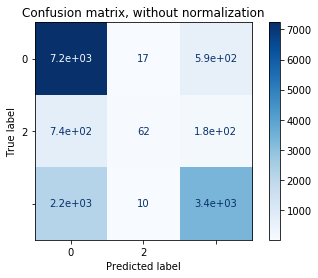

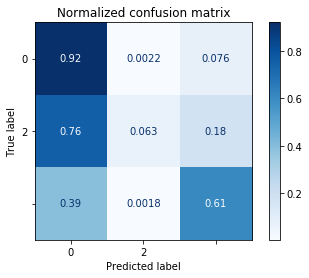

In [307]:
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(clf, X_test_scale, y_test,
                                 display_labels=[0, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

In [308]:
print(classification_report(y_test,predictions))
print(accuracy_score(y_test,predictions))

              precision    recall  f1-score   support

           0       0.71      0.92      0.80      7847
           1       0.70      0.06      0.12       983
           2       0.81      0.61      0.70      5567

    accuracy                           0.74     14397
   macro avg       0.74      0.53      0.54     14397
weighted avg       0.75      0.74      0.72     14397

0.7418906716677085


This model has better precision, however the number of false positives has increased, and this is not what we were hoping for. In accordance with our evaluation goals, we want a model that has at least an accuracy score of 0.80, and the lowest count of false positives. Therefore it may be in our best interest to use the vanilla Random Forest Classifier. Let's run this model and compare performances.

In [309]:
# Recreate RandomForest Classifier with best parameters
rf2 = RandomForestClassifier()

# Fit the best algorithm to the data. 
rf2.fit(X_train_scale, y_train)

# Make predictions on test set
predictions2 = rf2.predict(X_test_scale)
print(accuracy_score(y_test, predictions2))

# Create real and predicted objects
labels = y_test
predictions = predictions2

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis=1)
precision = np.diag(cm) / np.sum(cm, axis=0)

# Print recall and precision values
print(recall)
print(precision)

0.7978050982843647
[0.87179814 0.30315361 0.78085145]
[0.80748347 0.46417445 0.82282794]


Confusion matrix, without normalization
[[6841  247  759]
 [ 508  298  177]
 [1123   97 4347]]
Normalized confusion matrix
[[0.87179814 0.031477   0.09672486]
 [0.51678535 0.30315361 0.18006104]
 [0.20172445 0.01742411 0.78085145]]


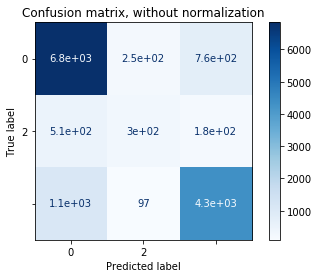

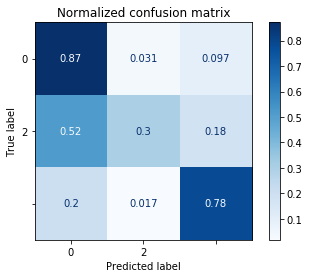

In [310]:
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(rf2, X_test_scale, y_test,
                                 display_labels=[0, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

The classification report will show us the values of precision, recall, F1 score and accuracy for evaluation. 

In [311]:
print(classification_report(y_test,predictions2))
print(accuracy_score(y_test,predictions2))

              precision    recall  f1-score   support

           0       0.81      0.87      0.84      7847
           1       0.46      0.30      0.37       983
           2       0.82      0.78      0.80      5567

    accuracy                           0.80     14397
   macro avg       0.70      0.65      0.67     14397
weighted avg       0.79      0.80      0.79     14397

0.7978050982843647


This model has a higher accuracy score and the false positive count is less with the vanilla Random Forest Classifier than with the optimized classifier. However, that model was optimized for accuracy, and not for precision. Let's use grid search and set the scoring metric to precision to attempt to lower the false positive rate further.

In [312]:
# Set classifier to Random Forest
clf = RandomForestClassifier()

# Choose some parameter combinations to try
parameters = {'n_estimators': [4, 6, 9], 
              'max_features': ['log2', 'sqrt','auto'], 
              'criterion': ['entropy', 'gini'],
              'max_depth': [2, 3, 5, 10], 
              'min_samples_split': [2, 3, 5],
              'min_samples_leaf': [1,5,8]
             }

# Type of scoring used to compare parameter combinations
pre_scorer = make_scorer(precision_score, average='micro')

# Run the grid search
grid_obj = GridSearchCV(clf, parameters, scoring=pre_scorer)
grid_obj = grid_obj.fit(X_train_scale, y_train)

# Set the clf to the best combination of parameters
clf = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
clf.fit(X_train_scale, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='entropy', max_depth=10, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=5, min_samples_split=3,
                       min_weight_fraction_leaf=0.0, n_estimators=9,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [313]:
clf = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=10, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=9,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [314]:
# Fit the best algorithm to the data. 
clf.fit(X_train_scale, y_train)
# Make predicitons on Test Set
predictions = clf.predict(X_test_scale)
print(accuracy_score(y_test, predictions))

# Create real and predicted objects
labels = y_test
predictions = predictions

# Create confusion matrix
cm = confusion_matrix(labels, predictions)
recall = np.diag(cm) / np.sum(cm, axis=1)
precision = np.diag(cm) / np.sum(cm, axis=0)

# Print recall and precision values
print(recall)
print(precision)

0.7427936375633812
[0.92557665 0.04272635 0.60876594]
[0.71212864 0.7        0.81899468]


Confusion matrix, without normalization
[[7263    8  576]
 [ 768   42  173]
 [2168   10 3389]]
Normalized confusion matrix
[[0.92557665 0.0010195  0.07340385]
 [0.78128179 0.04272635 0.17599186]
 [0.38943776 0.0017963  0.60876594]]


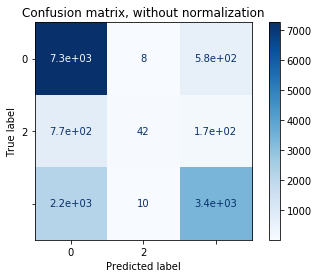

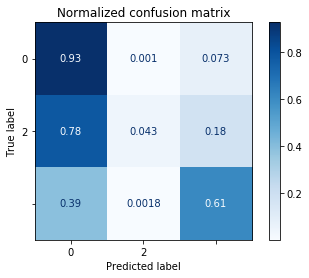

In [315]:
# Plot non-normalized confusion matrix
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(clf, X_test_scale, y_test,
                                 display_labels=[0, 2],
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

In [316]:
print(classification_report(y_test,predictions))
print(accuracy_score(y_test,predictions))

              precision    recall  f1-score   support

           0       0.71      0.93      0.80      7847
           1       0.70      0.04      0.08       983
           2       0.82      0.61      0.70      5567

    accuracy                           0.74     14397
   macro avg       0.74      0.53      0.53     14397
weighted avg       0.75      0.74      0.71     14397

0.7427936375633812


Interestingly, when optimizing our model for precision, we do indeed acheive a 0.91 for for accurately predicting functional wells, but the number of false positives has increased nearly double. We will therefore only use the vanilla Random Forest Classifier for predicting on our test set. We can also check the feature importance for our model to understand which features were considered most valuable in predicting the functionality of a well. We can simply use the `.feature_importances_` attribute to access the relative feature importance of the Random Forest Classifier and then plot those importances sorted from highest to lowest.

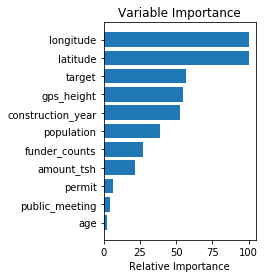

In [317]:
# Plot feature importance
feature_importance = rf2.feature_importances_[0:11]
# make importances relative to max importance
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
plt.subplot(1, 2, 2)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, class3_dummies.columns[sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Variable Importance')
plt.savefig('random forest feature importance')
plt.show()

# iNterpret
***

After carefully cleaning and exploring our data, we were able to run a Sci-Kit learn pipeline on several models, having the following accuracy results after running Stratified K-Fold Cross Validation:

<img src= 'img\models.PNG'>

<img src= 'img\scores1.PNG'>

The results indicated that a Random Forest Classifier would be the most accurate in predicting the functionality of a well. After hyperparameter tuning with GridSearchCV, and tuning for accuracy, and recall we created a Random Forest Classifier which achieved an accuracy score of 0.8063485448357297, thus successfully reaching the goal set in the metrics for evaluation section of our work. We also managed to keep a relatively low false positive rate. The resulting confusion matrix and classification report are as follows:

<img src= 'img\confusion_matrix.PNG'>

In [318]:
print(classification_report(y_test,predictions2))
print(accuracy_score(y_test,predictions2))

              precision    recall  f1-score   support

           0       0.81      0.87      0.84      7847
           1       0.46      0.30      0.37       983
           2       0.82      0.78      0.80      5567

    accuracy                           0.80     14397
   macro avg       0.70      0.65      0.67     14397
weighted avg       0.79      0.80      0.79     14397

0.7978050982843647


The model with the highest precision had the following confusion matrix:

<img src= 'img\confusion_precision.PNG'>

In regard to feature importance, the Random Forest Classifier deduced that geographical coordinates and elevation measures were the most vital features for predicting functionality in a well. `construction_year` was also a valuable feature, which can confirm that the linear regression model to predict missing year values was beneficial. Two features that were engineered were also considered as most important, those being `age`, and `funder_counts`. Our Random Forest feature importances are as follows:

<img src= 'img\top10_importances.PNG'>

# Conclusion
***

To work on such a vital project for so many has been an honor. Through analysis, exploration, and machine learning we have several findings to share with the Tanzanian Ministry of Water to support their initiative for supplying clean drinking water for it's citizens. Conclusions from data exploration are as follows:

 - **Water Source**
     - High levels of water availability to a waterpoint appears correlated to the waterpoint being functional and low levels appear related to non-functionality. This could indicate that the waterpoint is dry with no water to offer. Checking on water levels regularly could benefit in estimating when a well will malfunction.

     - Good quality water with Fluoride fro Spring wells is linked to functional waterpoints. Checking fluoride levels, pH levels and cleanliness of water is a first step in addressing issues and cleaning the waterpoints and water source, which will greatly aid in ensuring citizens have access to functional wells.
     
     - Most wells in Tanzania are gravity and handpump wells, with these types having the highest amount of functioning waterpoints, while the functioning wells connected to the largest sources of water are using a motorpump. Gravity and handpump wells appear to be the most resilient and simple wells, and are most likely the cheapest to fix when having issues. It would be suggested to specialize in fixing these extraction types and building them more often in the future.
     
     
 - **Geographical**
     - Geographical coordinates and elevation measures were the most vital features for predicting functionality in a well. Patterns within the hydrology of Tanzania indicated that Ininga & Kilmanjaro have some of the highest percentages of functional waterpoints and the highest counts of wells, but contain some of the lowest average populations. This could indicate that a factor for keeping wells functioning is having a high ratio of waterpoints to population. Mara, Lindi, Rukwa, and Mtwara have some of the highest average populations near waterpoints, but have more non-functioning wells than functioning wells. A critical measure in keeping waterpoints functional is making sure that one well is not servicing too many people. Having more wells in a community means that the wells share the strain of the water needs of the population, ensuring that it stays operational longer.
     
 - **Year & Seasonality**
     - Most reports are made in 2011 with 48% and 2013 with 40% of the reports. The best ratio of functional reports is 2011, with the worst being 2012. It could be useful to look back at records of construction, and weather for these years to find any patterns that could indicate why these years had the highest levels of reporting. 
     - The age of a well and consequently the construction year of a have a high significance to the functionality of a well. Those wells that were created after 1990 have a larger likelihood of being functional than those created before 1990.
     - While the day of the week did not have a relation to the functionality of a well, the Month Recorded and Season Recorded showed correlation with January, July, October, and November having the worst ratios for functioning wells, and most reporting being done in March with 31% and February with 20% of total reports. It could be useful to increase the size of the repair teams available during March and February, and have a smaller team near the end of the year.
     - It appeared that most reports were made in the long rain season with 38% of reports, and the least amount of reports are made in the short rain season with 3% of total reports. The long rain has the highest ratio of functionality of the seasons, while the short rain season has the lowest ratio of functionality. It could be efficient to thus focus on repair during the short rain season, and focus on inspection during the long rain season. There appears to be a regional relationship between when reports are made in that:
         - Most long dry reports are made in the North West.
         - Most long rain reports are made in the East.
         - Most short rain reports are made in the Mid West.
     - This could be useful in locating repair and inspection teams across the country at the appropriate times to address any issues with non-functioning wells.

 - **Model**
     - The Random Forest Classifier performed well and met the accuracy and false positive objectives within th scope of this project. On average our model had an accuracy of 0.8, and would predict false positives 20 out of 100 times. To improve this, in the future more complex models such as variations of neural networks and quantum based classifiers could improve accuracy to ensure every citizen of Tanzania has access to clean drinking water. 